<br>

In [317]:
# Tom Bresee
# Initial model - Random Forest Regressor
# Data:  Baseline (no loc features)
# All Time High:  Coeff of det (R^2):..... 0.726

<br>

In [1]:
# Models Previously Attempted:
#  Linear Regression
#  Gradient Boosting Regressor
#  XGBoost
#  Neural Network (base) from scikit-learn

<br>

In [318]:
# this notebook rendered in .html:

http://htmlpreview.github.io/?https://raw.githubusercontent.com/mcmanus-git/Singapore-HDB/main/tom/011_baseline_model_randomforestregressor.html?token=GHSAT0AAAAAABROR7PUD53YZES2FUK4O4OQYSWN4PQ

<br>

<br>

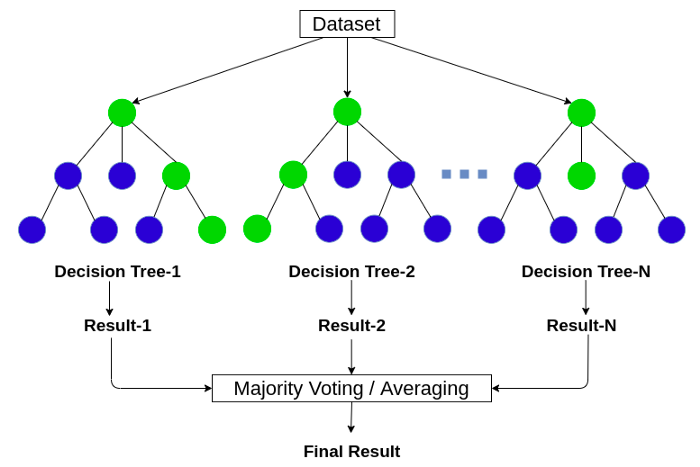

<br>

*Utility Functions:*

In [2]:

def my_columns(df):
    """Print out columns from input dataframe"""
    for col in df.columns:
        print(col)
              
            
def my_null_per_col(column_name):
    print(df[column_name].isna().sum())
      
        
def my_null_all():
    """NaN for entire dataframe"""
    print(df.isna().sum())
    
    
def my_dup_rows_count():
    print(df.duplicated().sum())  
    # 1863 ? 
    
    
def kill_kolumns(list_of_columns):
    df.drop(list_of_columns, axis=1, inplace=True) 
    
    
def is_categorical(col):
    return df[col].dtype.name == 'object'


def quick_vc_bar(col):
    """ 
    input column
    output histogram of counts
    """
    print('Value Counts Histogram:', col)
    df[col].value_counts().plot(kind='bar', 
                                color='navy',
                                alpha=0.6,
                                figsize=(8,6))
    
def sort_my_df(df):
    df = df.sort_values(by='month', 
                              ascending=True).reset_index(drop=True)

    
def replace_values_in_col(col, mapping_dict):
    replace_values = mapping_dict
    df = df.replace({col: replace_values})

    
def the_columns(df):
    """sorted list of df columns"""
    for c in sorted(list(df.columns)):
        print(c)
        

def encode_and_bind(my_original_dataframe, feature_to_encode):
    dummies = pd.get_dummies(my_original_dataframe[[feature_to_encode]])
    resulting_df = pd.concat([my_original_dataframe, dummies], axis=1)
    return(resulting_df)

# remove original feature at same time (slight variation):
# def encode_and_bind(original_dataframe, feature_to_encode):
#     dummies = pd.get_dummies(original_dataframe[[feature_to_encode]])
#     res = pd.concat([original_dataframe, dummies], axis=1)
#     res = res.drop([feature_to_encode], axis=1)
#     return(res) 

# total number of NaNs completed summed in a pd df:
# df.isnull().sum().sum()

# df.transaction_id.value_counts()
# print(df.duplicated().sum())
# print(df.duplicated(keep='last'))
# print(df.duplicated().sum())
# 
# limit to categorical data using df.select_dtypes()
# X = X.select_dtypes(include=[object])

# from sklearn.preprocessing import OneHotEncoder
# ohe = OneHotEncoder()
# ohe.fit_transform()
# ohe.fit_transform(  df[['sex']])
# ohe.categories_

<br>

*Libraries:*

In [114]:
# --------------------------------------------------------------------------
from mycreds import creds_tom
# --------------------------------------------------------------------------
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'
# --------------------------------------------------------------------------
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', None)
pd.set_option('display.float_format', '{:.2f}'.format) 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.pyplot as plt
# --------------------------------------------------------------------------
import glob  
from datetime import datetime as dt
import pandas_profiling
from pandas_profiling import ProfileReport
# from bokeh.layouts import column
# from bokeh.models import Div, TeX
# from bokeh.plotting import figure, show
# from bokeh.io import output_notebook
# --------------------------------------------------------------------------
import fiona
from sqlalchemy import create_engine
# output_notebook() # bokeh
# --------------------------------------------------------------------------
from sklearn.model_selection import train_test_split, KFold, cross_val_score 
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.preprocessing import OneHotEncoder, PolynomialFeatures
from sklearn.preprocessing import RobustScaler, LabelEncoder
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error, recall_score
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import SGDRegressor
from sklearn.pipeline import Pipeline
from sklearn.metrics import explained_variance_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neural_network import MLPRegressor
import xgboost as xgb
cm = sns.light_palette("blue", as_cmap=True)
# correlations.style.set_caption('Correlation Values Ranked').background_gradient(cmap=cm)
# --------------------------------------------------------------------------
from pprint import pprint
import shap
shap.initjs()

<br>

*Download raw data from AWS database:*

```
Database Views:
resale_price_norm  - transactions WITHOUT location features
resale_location_features  - transactions WITH location features
```

In [3]:
# # query = 'select * from conservation_areas limit 1;'
# query = 'select * from resale_price_norm;'
# # query = 'select * from resale_location_features limit 1;'
# engine = create_engine(f'postgresql+psycopg2://{username}:{password}@{host}/Capstone', echo=False)
# # /Capstone vs original /capstone
# sql_alc_cnxn = engine.connect()
# df = pd.read_sql(query, sql_alc_cnxn)
# df.to_pickle("resale_price_norm.pkl")
# query2 = 'select * from resale_location_features;'
# engine = create_engine(f'postgresql+psycopg2://{username}:{password}@{host}/Capstone', echo=False)
# sql_alc_cnxn = engine.connect()
# df2 = pd.read_sql(query2, sql_alc_cnxn)
# 1093117
# df2.to_pickle("resale_location_features_GOLD.pkl")

In [4]:
# query = 'select * from resale_location_features limit 1;'
query = 'select * from resale_price_norm;'
# engine = create_engine(f'postgresql+psycopg2://{Capstone_AWS_RO.username}:{Capstone_AWS_RO.password}@{Capstone_AWS_RO.host}/Capstone', echo=False)
# engine = create_engine(f'postgresql+psycopg2://{Capstone_AWS_RO.username}:{Capstone_AWS_RO.password}@{Capstone_AWS_RO.host}/Capstone', echo=False)
engine = create_engine(f'postgresql+psycopg2://{creds_tom.username}:{creds_tom.password}@{creds_tom.host}/Capstone', echo=False)
sql_alc_cnxn = engine.connect()

In [5]:
df = pd.read_sql(query, sql_alc_cnxn)

In [6]:
original_number_of_observations = len(df)

In [7]:
original_number_of_observations

867677

In [8]:
len(df)  # ~ 867,677

867677

<br>

*Pickle if you want (in case no access to DB):*

In [9]:
df.to_pickle('resale_price_norm_11_backup_in_case_GOLD.pkl')  # ~ 232 MB
# compression  {‘infer’, ‘gzip’, ‘bz2’, ‘zip’, ‘xz’, None}
# will overwrite old file fyi 

*Read in previously downloaded .pkl of entire raw dataset, if desired:*

In [ ]:
# new_df = pd.read_pickle('resale_price_norm_GOLD.pkl')  

In [9]:
len(df.columns)  # ~ 27 columns/features

27

In [10]:
original_df = df.copy()

<br>

*Storing raw data (unfiltered) in zipped (.csv embedded) form:*

In [ ]:
compression_opts = dict(method='zip', 
                        archive_name='resale_price_norm_11_GOLD_backup_in_case.csv')

df.to_csv('resale_price_norm_GOLD.zip', 
          index=False, 
          compression=compression_opts)

The full exported data to .csv is a large file: 270 MB. Even when the file is compressed (.zip) it is still: ~ 83 MB. 

<br>

*Storing raw data (unfiltered) in parquet form:*

In [ ]:
#  df.to_parquet('df.parquet.gzip', compression='gzip') 
#  s3_url = 's3://bucket/folder/bucket.parquet.gzip'  
#  s3 bucket works as well

#  df.to_parquet(s3_url, compression='gzip')

In [12]:
df.to_parquet('df.parquet.gzip', compression='gzip')  
# parquet + compressed gzip form in the event files are huge
# and then can use: pd.read_parquet('df.parquet.gzip') to read the contents...

In [13]:
df.to_parquet('resale_price_norm_11_GOLD.parquet', engine='fastparquet')  
#  standard parquet form exported 

*Read-in parquet form (if needed):*

In [ ]:
# IF you wanted to read, and its pretty darn fast:
#  tf = pd.read_parquet('resale_price_norm_GOLD.parquet', engine='fastparquet') 

<br>

*Quick checks:*

In [11]:
df.dtypes

transaction_id                               object
month                                datetime64[ns]
block                                        object
town                                         object
street_name                                  object
address                                      object
storey_range                                 object
storey_range_min                              int64
storey_range_max                              int64
flat_model                                   object
flat_type                                    object
n_rooms                                       int64
floor_area_sqm                              float64
lease_commence_date                           int64
remaining_lease                              object
remaining_lease_years                         int64
remaining_lease_months                      float64
resale_price                                float64
price_per_sq_ft                             float64
price_per_sq

In [12]:
df.head(1).T  # random example datapoint 

,0
transaction_id,2004_06_545_WOODLANDS_DR_16_07_TO_09
month,2004-06-01 00:00:00
block,545
town,WOODLANDS
street_name,WOODLANDS DR 16
address,545 WOODLANDS DR 16
storey_range,07 TO 09
storey_range_min,7
storey_range_max,9
flat_model,Model A


In [13]:
df.tail(1).T  # random example datapoint 

,867676
transaction_id,2004_06_546_WOODLANDS_DR_16_01_TO_03
month,2004-06-01 00:00:00
block,546
town,WOODLANDS
street_name,WOODLANDS DR 16
address,546 WOODLANDS DR 16
storey_range,01 TO 03
storey_range_min,1
storey_range_max,3
flat_model,Model A


<br>

*Timerange:*

In [14]:
df['month'] = pd.to_datetime(df['month'])
df = df.sort_values(by='month', ascending=True).reset_index(drop=True)  

def data_timeframe(df):
    print('\nNumber of rows of data: ............ ',len(df))  
    print('Most historic datapoint date: ...... ', df.month.iloc[0])
    print('Most recent datapoint date: ........ ', df.month.iloc[-1])
    print('Number of days of data: ............ ',(df.month.iloc[-1]-df.month.iloc[0])) 
    
data_timeframe(df)
# Number of rows of data: ............  867677
# Most historic datapoint date: ......  1990-01-01 00:00:00
# Most recent datapoint date: ........  2022-03-01 00:00:00
# Number of days of data: ............  11747 days 00:00:00


Number of rows of data: ............  867677
Most historic datapoint date: ......  1990-01-01 00:00:00
Most recent datapoint date: ........  2022-03-01 00:00:00
Number of days of data: ............  11747 days 00:00:00


<br>

*Singapore specifics (data integrity check usage possible):*

In [15]:
planning_areas = pd.read_html('https://en.wikipedia.org/wiki/Planning_Areas_of_Singapore')[2]
planning_areas = planning_areas[['Name (English)', 'Region','Area (km²)', 'Population[7]', 'Density (/km²)']]
planning_areas.columns = ['Name', 'Region', 'Area_km2', 'Population', 'Density_per_km2']
planning_areas

,Name,Region,Area_km2,Population,Density_per_km2
0,Ang Mo Kio,North-East,13.94,163950,13400
1,Bedok,East,21.69,279380,13000
2,Bishan,Central,7.62,88010,12000
3,Boon Lay,West,8.23,30,3.6
4,Bukit Batok,West,11.13,153740,14000
5,Bukit Merah,Central,14.34,151980,11000
6,Bukit Panjang,West,8.99,139280,15000
7,Bukit Timah,Central,17.53,77430,4400
8,Central Water Catchment,North,37.15,*,*
9,Changi,East,40.61,1830,80.62


In [16]:
# https://en.wikipedia.org/wiki/Regions_of_Singapore
regions = pd.read_html('https://en.wikipedia.org/wiki/Regions_of_Singapore')[1]
regions.columns = ['Region', 'Regional Centre', 'Largest PA by area', 'Largest PA by population', 'Area(km²)', 
                   'Estimated Population', 'Populationdensity(/km²)', 'PlanningAreas']
regions = regions.iloc[:-1 , :]
regions

,Region,Regional Centre,Largest PA by area,Largest PA by population,Area(km²),Estimated Population,Populationdensity(/km²),PlanningAreas
0,Central Region,Central Area (de facto),Queenstown,Bukit Merah,132.70,922580,6952,22
1,East Region,Tampines,Changi,Bedok,93.10,685890,7367,6
2,North Region,Woodlands,Central Water Catchment,Woodlands,134.50,582330,4330,8
3,North-East Region,Seletar,North-Eastern Islands,Sengkang,103.90,930910,8960,9
4,West Region,Jurong East,Western Water Catchment,Jurong West,201.30,922540,4583,12


In [17]:
towns = pd.read_html('https://en.wikipedia.org/wiki/New_towns_of_Singapore')[0]

towns = towns[  ['Name (English/Malay)', 'Total area (km2)', 'Residential area (km2)', 
                 'Dwelling units', 'Projected ultimate', 'Population']]

towns.columns = ['Name', 'Total area (km2)', 'Residential area (km2)', 
                 'Dwelling units', 'Projected ultimate', 'Population']

towns

,Name,Total area (km2),Residential area (km2),Dwelling units,Projected ultimate,Population
0,Ang Mo Kio,6.38,2.83,50726,58000,138200
1,Bedok,9.37,4.18,62816,79000,187900
2,Bishan,6.90,1.72,20072,34000,61100
3,Bukit Batok,7.85,2.91,44285,54000,121400
4,Bukit Merah,8.58,3.12,54227,68000,141400
5,Bukit Panjang,4.89,2.19,35325,44000,118900
6,Choa Chu Kang,5.83,3.07,48900,62000,167200
7,Clementi,4.12,2.03,26730,39000,69500
8,Geylang,6.78,2.14,30892,50000,86000
9,Hougang,13.09,3.67,57272,72000,179700


In [18]:
estates = pd.read_html('https://en.wikipedia.org/wiki/New_towns_of_Singapore')[1]
estates = estates[['Name (English/Malay)', 'Dwelling units', 'Population']]
estates

,Name (English/Malay),Dwelling units,Population
0,Bukit Timah,2423,8100
1,Marine Parade,6537,20800
2,Central Area,9459,27200


<br>

*Cleaning:*

In [19]:
# mapping towns to individual region, which I think is a big deal to do
# ML won't like 27 towns, high variability, but perhaps region will derive insights

In [20]:
sorted(regions.Region.unique())  
# from scraped, as data integrity check ! 
# 

['Central Region',
 'East Region',
 'North Region',
 'North-East Region',
 'West Region']

In [21]:
# mapping towns -> region 
town_to_region_mapper = pd.Series(planning_areas.Region.values,
                                  index=planning_areas.Name).to_dict()
town_to_region_mapper

{'Ang Mo Kio': 'North-East',
 'Bedok': 'East',
 'Bishan': 'Central',
 'Boon Lay': 'West',
 'Bukit Batok': 'West',
 'Bukit Merah': 'Central',
 'Bukit Panjang': 'West',
 'Bukit Timah': 'Central',
 'Central Water Catchment': 'North',
 'Changi': 'East',
 'Changi Bay': 'East',
 'Choa Chu Kang': 'West',
 'Clementi': 'West',
 'Downtown Core': 'Central',
 'Geylang': 'Central',
 'Hougang': 'North-East',
 'Jurong East': 'West',
 'Jurong West': 'West',
 'Kallang': 'Central',
 'Lim Chu Kang': 'North',
 'Mandai': 'North',
 'Marina East': 'Central',
 'Marina South': 'Central',
 'Marine Parade': 'Central',
 'Museum': 'Central',
 'Newton': 'Central',
 'North-Eastern Islands': 'North-East',
 'Novena': 'Central',
 'Orchard': 'Central',
 'Outram': 'Central',
 'Pasir Ris': 'East',
 'Paya Lebar': 'East',
 'Pioneer': 'West',
 'Punggol': 'North-East',
 'Queenstown': 'Central',
 'River Valley': 'Central',
 'Rochor': 'Central',
 'Seletar': 'North-East',
 'Sembawang': 'North',
 'Sengkang': 'North-East',
 'Seran

In [22]:
## already exists:  'Kallang': 'Central', wtf 
town_to_region_mapper['Central Area'] = 'Central'  # obviously
town_to_region_mapper['Kallang/Whampoa'] = 'Central'
# sometimes the Kallang/Whampoa are reversed in order... 

In [23]:
town_to_region_mapper  # note, will be longer than our unique towns

{'Ang Mo Kio': 'North-East',
 'Bedok': 'East',
 'Bishan': 'Central',
 'Boon Lay': 'West',
 'Bukit Batok': 'West',
 'Bukit Merah': 'Central',
 'Bukit Panjang': 'West',
 'Bukit Timah': 'Central',
 'Central Water Catchment': 'North',
 'Changi': 'East',
 'Changi Bay': 'East',
 'Choa Chu Kang': 'West',
 'Clementi': 'West',
 'Downtown Core': 'Central',
 'Geylang': 'Central',
 'Hougang': 'North-East',
 'Jurong East': 'West',
 'Jurong West': 'West',
 'Kallang': 'Central',
 'Lim Chu Kang': 'North',
 'Mandai': 'North',
 'Marina East': 'Central',
 'Marina South': 'Central',
 'Marine Parade': 'Central',
 'Museum': 'Central',
 'Newton': 'Central',
 'North-Eastern Islands': 'North-East',
 'Novena': 'Central',
 'Orchard': 'Central',
 'Outram': 'Central',
 'Pasir Ris': 'East',
 'Paya Lebar': 'East',
 'Pioneer': 'West',
 'Punggol': 'North-East',
 'Queenstown': 'Central',
 'River Valley': 'Central',
 'Rochor': 'Central',
 'Seletar': 'North-East',
 'Sembawang': 'North',
 'Sengkang': 'North-East',
 'Seran

In [24]:
towns.Name   # reference from previously scraped data, as quick reference

0          Ang Mo Kio
1               Bedok
2              Bishan
3         Bukit Batok
4         Bukit Merah
5       Bukit Panjang
6       Choa Chu Kang
7            Clementi
8             Geylang
9             Hougang
10        Jurong East
11        Jurong West
12    Kallang/Whampoa
13          Pasir Ris
14            Punggol
15         Queenstown
16          Sembawang
17           Sengkang
18          Serangoon
19           Tampines
20          Toa Payoh
21          Woodlands
22             Yishun
Name: Name, dtype: object

In [25]:
df['town'] = df['town'].str.title() # capitalize the first letter of each word in town 
# df['town'] = df['town'].str.replace('/','_')

In [26]:
sorted(df.town.unique().tolist())  
# len(df.town.unique()) - >  27 unique towns 

['Ang Mo Kio',
 'Bedok',
 'Bishan',
 'Bukit Batok',
 'Bukit Merah',
 'Bukit Panjang',
 'Bukit Timah',
 'Central Area',
 'Choa Chu Kang',
 'Clementi',
 'Geylang',
 'Hougang',
 'Jurong East',
 'Jurong West',
 'Kallang/Whampoa',
 'Lim Chu Kang',
 'Marine Parade',
 'Pasir Ris',
 'Punggol',
 'Queenstown',
 'Sembawang',
 'Sengkang',
 'Serangoon',
 'Tampines',
 'Toa Payoh',
 'Woodlands',
 'Yishun']

In [27]:
# create new feature `region`:

df['region']= df['town'].map(town_to_region_mapper)

# had to fix for two missed towns:
# df.region.isnull().sum()    31991
# find the null values for towns -> region mapping we missed...

# df[df['region'].isnull()].town.unique()
#   array(['Kallang/Whampoa', 'Central Area'], dtype=object)

# https://en.wikipedia.org/wiki/Central_Area,_Singapore#:~:text=Located%20in%20the%20south%2Deastern,defined%20by%20the%20Urban%20Redevelopment

In [28]:
df.region.isnull().sum()  # 0, so no missed town -> region mapping

0

In [29]:
quick_vc_bar('region')

Value Counts Histogram: region


In [30]:
df.columns

Index(['transaction_id', 'month', 'block', 'town', 'street_name', 'address',
       'storey_range', 'storey_range_min', 'storey_range_max', 'flat_model',
       'flat_type', 'n_rooms', 'floor_area_sqm', 'lease_commence_date',
       'remaining_lease', 'remaining_lease_years', 'remaining_lease_months',
       'resale_price', 'price_per_sq_ft', 'price_per_sq_m',
       'price_per_sq_ft_per_lease_yr', 'price_per_sq_m_per_lease_yr',
       'resale_price_norm', 'price_per_sq_ft_norm',
       'price_per_sq_ft_per_lease_yr_norm', 'price_per_sq_m_norm',
       'price_per_sq_m_per_lease_yr_norm', 'region'],
      dtype='object')

In [31]:
df['flat_type'] = df['flat_type'].str.title()  

In [32]:
df.flat_type.unique().tolist() 
# 'Multi Generation' is the same as 'Multi-Generation' ?  i think so. 
# Need to figure out if 'Executive' is a suite, or is possible convert to 'floor' equivalent 

['5 Room',
 '3 Room',
 'Executive',
 '4 Room',
 '2 Room',
 '1 Room',
 'Multi Generation',
 'Multi-Generation']

In [33]:
df.flat_type.value_counts()

4 Room              326642
3 Room              281537
5 Room              181388
Executive            65876
2 Room               10421
1 Room                1285
Multi Generation       279
Multi-Generation       249
Name: flat_type, dtype: int64

In [34]:
df['flat_type'] = df['flat_type'].str.replace('Multi-Generation', 'Multi Generation', 
                                              regex=True) # they are the same thing 

In [35]:
df.flat_type.unique().tolist() 

['5 Room',
 '3 Room',
 'Executive',
 '4 Room',
 '2 Room',
 '1 Room',
 'Multi Generation']

In [36]:
# link to explanation of flat types:
# https://sg.finance.yahoo.com/news/different-types-hdb-houses-call-020000642.html
# worth seeing if can modify forms 

In [37]:
df.flat_type.value_counts()

4 Room              326642
3 Room              281537
5 Room              181388
Executive            65876
2 Room               10421
1 Room                1285
Multi Generation       528
Name: flat_type, dtype: int64

In [38]:
df.flat_type.value_counts(normalize=True)

4 Room             0.38
3 Room             0.32
5 Room             0.21
Executive          0.08
2 Room             0.01
1 Room             0.00
Multi Generation   0.00
Name: flat_type, dtype: float64

In [39]:
#  **WARNING**:  this means that
#  Executive            65876
#  Multi Generation       528
#  won't have n_room count... which means that feature is odd... 

In [40]:
df.n_rooms.value_counts() 
# are there any NaNs ???
# i dont like this:  room count isn't mapped for some flat_types...
# watch missing values here... 

4    326642
3    281537
5    247792
2     10421
1      1285
Name: n_rooms, dtype: int64

In [41]:
df.n_rooms.value_counts(normalize=True) 

4   0.38
3   0.32
5   0.29
2   0.01
1   0.00
Name: n_rooms, dtype: float64

In [42]:
df.n_rooms.isnull().sum() 
# did we set some already to a interpeted value ?   Yes

0

In [43]:
df.storey_range.unique().tolist()

['07 TO 09',
 '13 TO 15',
 '10 TO 12',
 '04 TO 06',
 '01 TO 03',
 '16 TO 18',
 '19 TO 21',
 '22 TO 24',
 '25 TO 27',
 '28 TO 30',
 '31 TO 33',
 '37 TO 39',
 '40 TO 42',
 '34 TO 36',
 '11 TO 15',
 '06 TO 10',
 '01 TO 05',
 '16 TO 20',
 '26 TO 30',
 '21 TO 25',
 '36 TO 40',
 '31 TO 35',
 '46 TO 48',
 '43 TO 45',
 '49 TO 51']

In [44]:
df.storey_range.value_counts()  
# note:  these are categories technically

04 TO 06    219080
07 TO 09    197527
01 TO 03    176124
10 TO 12    167727
13 TO 15     56326
16 TO 18     21490
19 TO 21     10245
22 TO 24      6660
25 TO 27      2905
01 TO 05      2700
06 TO 10      2474
28 TO 30      1277
11 TO 15      1259
31 TO 33       423
34 TO 36       392
37 TO 39       379
16 TO 20       265
40 TO 42       191
21 TO 25        92
43 TO 45        43
26 TO 30        39
46 TO 48        37
49 TO 51        13
36 TO 40         7
31 TO 35         2
Name: storey_range, dtype: int64

In [45]:
df.storey_range.value_counts(normalize=True)  # high imbalance...

04 TO 06   0.25
07 TO 09   0.23
01 TO 03   0.20
10 TO 12   0.19
13 TO 15   0.06
16 TO 18   0.02
19 TO 21   0.01
22 TO 24   0.01
25 TO 27   0.00
01 TO 05   0.00
06 TO 10   0.00
28 TO 30   0.00
11 TO 15   0.00
31 TO 33   0.00
34 TO 36   0.00
37 TO 39   0.00
16 TO 20   0.00
40 TO 42   0.00
21 TO 25   0.00
43 TO 45   0.00
26 TO 30   0.00
46 TO 48   0.00
49 TO 51   0.00
36 TO 40   0.00
31 TO 35   0.00
Name: storey_range, dtype: float64

In [46]:
# adding new feature
df['storey_range_avg'] = (df['storey_range_min'] + df['storey_range_max'])/2

In [47]:
sorted(list(df.columns))

['address',
 'block',
 'flat_model',
 'flat_type',
 'floor_area_sqm',
 'lease_commence_date',
 'month',
 'n_rooms',
 'price_per_sq_ft',
 'price_per_sq_ft_norm',
 'price_per_sq_ft_per_lease_yr',
 'price_per_sq_ft_per_lease_yr_norm',
 'price_per_sq_m',
 'price_per_sq_m_norm',
 'price_per_sq_m_per_lease_yr',
 'price_per_sq_m_per_lease_yr_norm',
 'region',
 'remaining_lease',
 'remaining_lease_months',
 'remaining_lease_years',
 'resale_price',
 'resale_price_norm',
 'storey_range',
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
 'street_name',
 'town',
 'transaction_id']

<br>

In [48]:
df['flat_model'] = df['flat_model'].str.lower()
df['flat_model'] = df['flat_model'].str.title() 

In [49]:
sorted(df.flat_model.unique().tolist())
# we must assume these have many duplicated...
# i.e. IMPROVED actually equals Improved

# i dont like this. i feel like some of these apt types are 
# potentially subsets of other types of flat_models...
# consolidate somehow ? 

['2-Room',
 'Adjoined Flat',
 'Apartment',
 'Dbss',
 'Improved',
 'Improved-Maisonette',
 'Maisonette',
 'Model A',
 'Model A-Maisonette',
 'Model A2',
 'Multi Generation',
 'New Generation',
 'Premium Apartment',
 'Premium Apartment Loft',
 'Premium Maisonette',
 'Simplified',
 'Standard',
 'Terrace',
 'Type S1',
 'Type S2']

In [50]:
df.flat_model.value_counts()
# when in doubt, see if the largest value counts dont have conflicting 
# flat_model types 

Model A                   242085
Improved                  227608
New Generation            182187
Simplified                 55343
Standard                   41043
Premium Apartment          40331
Apartment                  33602
Maisonette                 28187
Model A2                    9486
Dbss                        2595
Model A-Maisonette          1974
Adjoined Flat               1155
Terrace                      670
Multi Generation             528
Type S1                      359
Type S2                      185
Improved-Maisonette          118
Premium Maisonette            85
Premium Apartment Loft        83
2-Room                        53
Name: flat_model, dtype: int64

In [51]:
df.flat_model.value_counts(normalize=True)

Model A                  0.28
Improved                 0.26
New Generation           0.21
Simplified               0.06
Standard                 0.05
Premium Apartment        0.05
Apartment                0.04
Maisonette               0.03
Model A2                 0.01
Dbss                     0.00
Model A-Maisonette       0.00
Adjoined Flat            0.00
Terrace                  0.00
Multi Generation         0.00
Type S1                  0.00
Type S2                  0.00
Improved-Maisonette      0.00
Premium Maisonette       0.00
Premium Apartment Loft   0.00
2-Room                   0.00
Name: flat_model, dtype: float64

<br>

In [52]:
sorted(list(df.lease_commence_date.unique()))

[1966,
 1967,
 1968,
 1969,
 1970,
 1971,
 1972,
 1973,
 1974,
 1975,
 1976,
 1977,
 1978,
 1979,
 1980,
 1981,
 1982,
 1983,
 1984,
 1985,
 1986,
 1987,
 1988,
 1989,
 1990,
 1991,
 1992,
 1993,
 1994,
 1995,
 1996,
 1997,
 1998,
 1999,
 2000,
 2001,
 2002,
 2003,
 2004,
 2005,
 2006,
 2007,
 2008,
 2009,
 2010,
 2011,
 2012,
 2013,
 2014,
 2015,
 2016,
 2017,
 2018,
 2019]

In [53]:
df.lease_commence_date.value_counts()

1985    84250
1984    61028
1988    48692
1987    41174
1978    39823
1986    37124
1989    30940
1980    30914
1979    29815
1997    29361
1993    26987
1996    26778
1998    24182
1983    22233
1976    20673
1981    20105
1977    19975
1999    19391
1992    19334
1995    18135
2001    17833
2000    16998
1975    16703
2003    14280
1974    14022
1982    12800
2002    11464
1970    10981
1990     8915
1973     8302
1969     8090
2004     7703
1971     7626
2015     7613
1994     6227
1967     5939
1972     5585
2016     4434
2013     4314
2012     4010
2005     3614
2014     2826
2006     2813
2017     2632
2011     2235
2008     1862
1968     1822
2009     1555
1991     1192
2010     1159
2007      836
2018      315
2019       33
1966       30
Name: lease_commence_date, dtype: int64

In [54]:
df.lease_commence_date.value_counts().sort_index(ascending=False)

2019       33
2018      315
2017     2632
2016     4434
2015     7613
2014     2826
2013     4314
2012     4010
2011     2235
2010     1159
2009     1555
2008     1862
2007      836
2006     2813
2005     3614
2004     7703
2003    14280
2002    11464
2001    17833
2000    16998
1999    19391
1998    24182
1997    29361
1996    26778
1995    18135
1994     6227
1993    26987
1992    19334
1991     1192
1990     8915
1989    30940
1988    48692
1987    41174
1986    37124
1985    84250
1984    61028
1983    22233
1982    12800
1981    20105
1980    30914
1979    29815
1978    39823
1977    19975
1976    20673
1975    16703
1974    14022
1973     8302
1972     5585
1971     7626
1970    10981
1969     8090
1968     1822
1967     5939
1966       30
Name: lease_commence_date, dtype: int64

<br>

*Drop Duplicate Rows (initial):*

In [55]:
df.drop_duplicates(keep=False, inplace=True)

In [56]:
len(df)  # 863977

863977

In [57]:
original_number_of_observations

867677

In [58]:
original_number_of_observations - len(df)

3700

In [59]:
sorted(df.columns.to_list())

['address',
 'block',
 'flat_model',
 'flat_type',
 'floor_area_sqm',
 'lease_commence_date',
 'month',
 'n_rooms',
 'price_per_sq_ft',
 'price_per_sq_ft_norm',
 'price_per_sq_ft_per_lease_yr',
 'price_per_sq_ft_per_lease_yr_norm',
 'price_per_sq_m',
 'price_per_sq_m_norm',
 'price_per_sq_m_per_lease_yr',
 'price_per_sq_m_per_lease_yr_norm',
 'region',
 'remaining_lease',
 'remaining_lease_months',
 'remaining_lease_years',
 'resale_price',
 'resale_price_norm',
 'storey_range',
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
 'street_name',
 'town',
 'transaction_id']

<br>

In [60]:
len(df[df.duplicated(['transaction_id'])])  
# do what with this ? 
# 56801

56801

<br>

In [61]:
display(df.describe())

,storey_range_min,storey_range_max,n_rooms,floor_area_sqm,lease_commence_date,remaining_lease_years,remaining_lease_months,resale_price,price_per_sq_ft,price_per_sq_m,price_per_sq_ft_per_lease_yr,price_per_sq_m_per_lease_yr,resale_price_norm,price_per_sq_ft_norm,price_per_sq_ft_per_lease_yr_norm,price_per_sq_m_norm,price_per_sq_m_per_lease_yr_norm,storey_range_avg
count,863977.00,863977.00,863977.00,863977.00,863977.00,863977.00,158075.00,863977.00,863977.00,863977.00,863977.00,863977.00,863977.00,863977.00,863977.00,863977.00,863977.00,863977.00
mean,6.60,8.62,3.93,95.73,1987.63,81.00,4.24,303901.73,955.17,3133.77,12.23,40.14,489750.06,1537.07,19.27,5042.87,63.23,7.61
std,4.72,4.72,0.82,25.96,9.97,10.18,3.83,156194.93,413.85,1357.78,6.17,20.25,192136.29,337.57,4.89,1107.50,16.05,4.72
min,1.00,3.00,1.00,28.00,1966.00,43.00,0.00,5000.00,49.16,161.29,0.59,1.94,24587.76,241.75,2.95,793.15,9.67,2.00
25%,4.00,6.00,3.00,73.00,1980.00,74.00,0.00,186000.00,687.66,2256.10,8.18,26.84,345360.90,1321.11,15.97,4334.36,52.40,5.00
50%,7.00,9.00,4.00,93.00,1986.00,83.00,4.00,283000.00,867.32,2845.53,10.47,34.34,460166.67,1487.57,18.27,4880.49,59.93,8.00
75%,10.00,12.00,5.00,114.00,1995.00,89.00,8.00,395000.00,1198.49,3932.04,15.43,50.63,584278.01,1692.31,21.61,5552.21,70.88,11.00
max,49.00,51.00,5.00,307.00,2019.00,101.00,11.00,1360000.00,3932.90,12903.23,65.63,215.31,1792857.14,4441.42,74.17,14571.59,243.34,50.00


In [62]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
storey_range_min,863977.00,6.60,4.72,1.00,4.00,7.00,10.00,49.00
storey_range_max,863977.00,8.62,4.72,3.00,6.00,9.00,12.00,51.00
n_rooms,863977.00,3.93,0.82,1.00,3.00,4.00,5.00,5.00
floor_area_sqm,863977.00,95.73,25.96,28.00,73.00,93.00,114.00,307.00
lease_commence_date,863977.00,1987.63,9.97,1966.00,1980.00,1986.00,1995.00,2019.00
remaining_lease_years,863977.00,81.00,10.18,43.00,74.00,83.00,89.00,101.00
remaining_lease_months,158075.00,4.24,3.83,0.00,0.00,4.00,8.00,11.00
resale_price,863977.00,303901.73,156194.93,5000.00,186000.00,283000.00,395000.00,1360000.00
price_per_sq_ft,863977.00,955.17,413.85,49.16,687.66,867.32,1198.49,3932.90
price_per_sq_m,863977.00,3133.77,1357.78,161.29,2256.10,2845.53,3932.04,12903.23


<br>

In [63]:
import matplotlib.pyplot as plt
%matplotlib inline

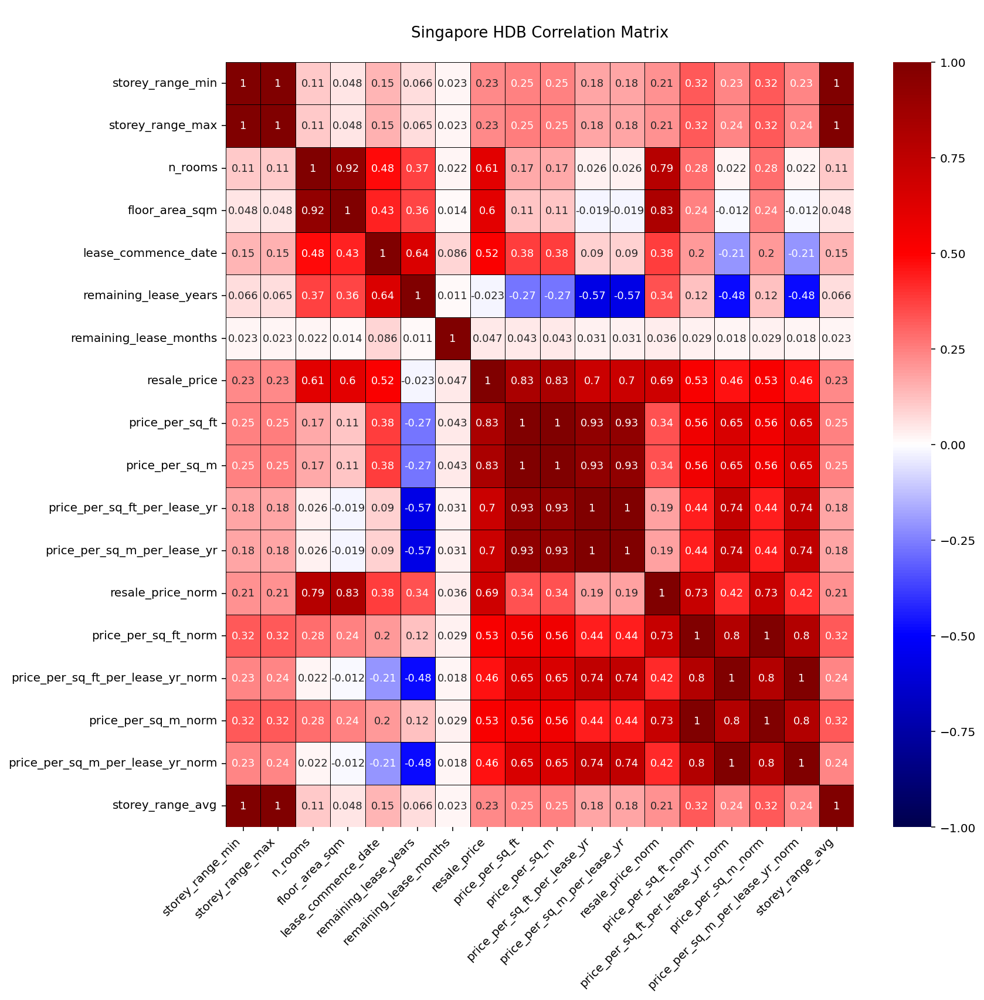

In [64]:
%config InlineBackend.figure_format = 'retina'
plt.rcParams['savefig.facecolor']='white'

plt.figure(figsize=(12,12))

sns.heatmap(df.select_dtypes(include=['int64','float64']).corr(), 
                 fmt='.2g', 
                 annot = True, 
                 vmin=-1,
                 vmax=1, 
                 center= 0, 
                 cmap= 'seismic', 
                 linecolor='black', 
                 linewidth=.5, 
                 annot_kws={"size": 9})

plt.xticks(rotation=45, 
           ha='right')

plt.title('\nSingapore HDB Correlation Matrix\n',
          fontsize=13)

# plt.savefig('correlation_matrix_baseline.png', 
#             bbox_inches='tight',
#             pad_inches=0.2, 
#             dpi=400)
plt.show();

In [65]:
# let's rank from highest to lowest (comparing to our price_per_sq_m_norm feature)
correlations = df.corr()
correlations = correlations[['price_per_sq_m_norm']].sort_values(by='price_per_sq_m_norm', 
                                                                 ascending=False)
print(correlations.to_string())

                                   price_per_sq_m_norm
price_per_sq_m_norm                               1.00
price_per_sq_ft_norm                              1.00
price_per_sq_ft_per_lease_yr_norm                 0.80
price_per_sq_m_per_lease_yr_norm                  0.80
resale_price_norm                                 0.73
price_per_sq_m                                    0.56
price_per_sq_ft                                   0.56
resale_price                                      0.53
price_per_sq_ft_per_lease_yr                      0.44
price_per_sq_m_per_lease_yr                       0.44
storey_range_max                                  0.32
storey_range_avg                                  0.32
storey_range_min                                  0.32
n_rooms                                           0.28
floor_area_sqm                                    0.24
lease_commence_date                               0.20
remaining_lease_years                             0.12
remaining_

In [66]:
cm = sns.light_palette("blue", as_cmap=True)
correlations.style.set_caption('Correlation Values Ranked').background_gradient(cmap=cm)

,price_per_sq_m_norm
price_per_sq_m_norm,1.000000
price_per_sq_ft_norm,1.000000
price_per_sq_ft_per_lease_yr_norm,0.799817
price_per_sq_m_per_lease_yr_norm,0.799817
resale_price_norm,0.726386
price_per_sq_m,0.558532
price_per_sq_ft,0.558532
resale_price,0.527034
price_per_sq_ft_per_lease_yr,0.443503
price_per_sq_m_per_lease_yr,0.443503


<br>

### Encoding

In [121]:
df_ml = df.copy()
# YOU CAN GO BACK TO THIS POINT IF YOU MESS UP

In [122]:
the_columns(df_ml)  
# before 

address
block
flat_model
flat_type
floor_area_sqm
lease_commence_date
month
n_rooms
price_per_sq_ft
price_per_sq_ft_norm
price_per_sq_ft_per_lease_yr
price_per_sq_ft_per_lease_yr_norm
price_per_sq_m
price_per_sq_m_norm
price_per_sq_m_per_lease_yr
price_per_sq_m_per_lease_yr_norm
region
remaining_lease
remaining_lease_months
remaining_lease_years
resale_price
resale_price_norm
storey_range
storey_range_avg
storey_range_max
storey_range_min
street_name
town
transaction_id


In [123]:
def encode_and_bind(my_original_dataframe, feature_to_encode):
    dummies = pd.get_dummies(my_original_dataframe[[feature_to_encode]], 
                            prefix_sep='_')
    resulting_df = pd.concat([my_original_dataframe, dummies], axis=1)
    return(resulting_df)

# pandas.get_dummies(data,
# prefix=None,
# prefix_sep=’_’,
# dummy_na=False,
# columns=None,
# sparse=False,
# drop_first=False,
# dtype=None)

In [124]:
df_ml.dtypes  # before 

transaction_id                               object
month                                datetime64[ns]
block                                        object
town                                         object
street_name                                  object
address                                      object
storey_range                                 object
storey_range_min                              int64
storey_range_max                              int64
flat_model                                   object
flat_type                                    object
n_rooms                                       int64
floor_area_sqm                              float64
lease_commence_date                           int64
remaining_lease                              object
remaining_lease_years                         int64
remaining_lease_months                      float64
resale_price                                float64
price_per_sq_ft                             float64
price_per_sq

In [125]:

# important that these are actual categorical values if you are going to 1HE ! 
df_ml = encode_and_bind(df_ml, 'region')
df_ml = encode_and_bind(df_ml, 'town')
df_ml = encode_and_bind(df_ml, 'flat_model')
df_ml = encode_and_bind(df_ml, 'flat_type')
df_ml = encode_and_bind(df_ml, 'storey_range')

# already a number, won't let you encode...
# df_ml = encode_and_bind(df_ml, 'n_rooms')


In [126]:
all_columns = sorted(df_ml.columns)
all_columns

['address',
 'block',
 'flat_model',
 'flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
 'flat_type',
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
 'floor_area_sqm',
 'lease_commence_date',
 'month',
 'n_rooms',
 'price_per_sq_ft',
 'price_per_sq_ft_norm',
 'price_per_sq_ft_per_lease_yr',
 'price_per_sq_ft_per_lease_yr_norm',
 'price_per_sq_m',
 'price_per_sq_m_norm',
 'price_per_sq_m_

In [127]:

all_hot_encoded_columns = ['flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
                           
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
                           
 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
                           
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
                           
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [128]:

all_unencoded_columns =  ['address',
 'floor_area_sqm',
 'lease_commence_date',
 'month',
 'n_rooms',
 'price_per_sq_ft',
 'price_per_sq_ft_norm',
 'price_per_sq_ft_per_lease_yr',
 'price_per_sq_ft_per_lease_yr_norm',
 'price_per_sq_m',
 'price_per_sq_m_norm',
 'price_per_sq_m_per_lease_yr',
 'price_per_sq_m_per_lease_yr_norm',
 'remaining_lease_years',
 'resale_price_norm',
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min']


In [129]:

columns_to_keep = ['floor_area_sqm',
                   
 'month',
 
 'lease_commence_date', 
                   
 'n_rooms',
    
 'price_per_sq_m_norm',
 
 'price_per_sq_m_per_lease_yr_norm',  # ***

 'remaining_lease_years',
 
 'resale_price_norm',

 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
    
 'flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [130]:
df_ml_1 = df_ml[columns_to_keep]

---

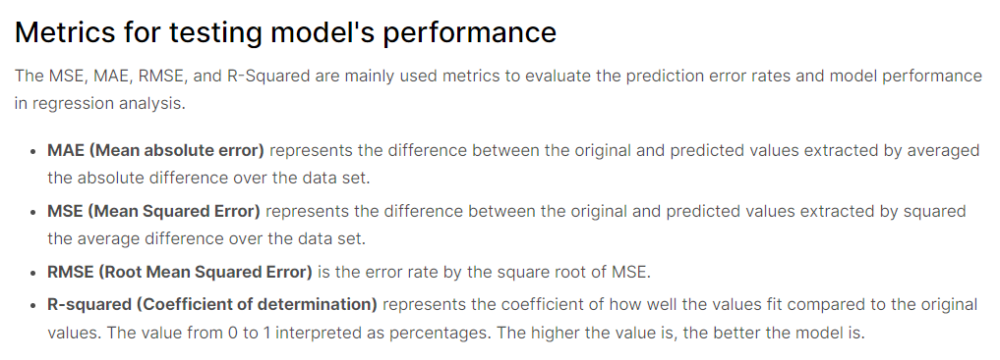

---

In [131]:
# def toms_train_test_split(x, y):
#     """fancy split based on 80% of the 'range time'"""
    
# eighty_percent = 0.8 * len(X)

# X_train= X[:round(eighty_percent)]
# X_test = X[round(eighty_percent):]

# y_train= y[:round(eighty_percent)]
# y_test = y[round(eighty_percent):]

# assert ( (len(X_train) + len(X_test)) == (len(y_train) + len(y_test)))

In [132]:
# # The coefficients
# # print("Coefficients: \n", regr.coef_)

# # The mean squared error
# print("Mean Squared Error:..... %.2f" % mean_squared_error(y_test, y_pred))

# print('Mean Absolute Error: ...', mean_absolute_error(y_pred, y_test))

# print('RMSE: ..................', np.sqrt(mean_squared_error(y_pred, y_test)))

# # The coefficient of determination: 1 is perfect prediction
# print("Coeff of det (R^2):..... %.2f" % r2_score(y_test, y_pred))
# # https://statisticsbyjim.com/regression/interpret-r-squared-regression/
    
# print('Score ..................', regr.score(X_test, y_test))

# # # Plot outputs
# # plt.scatter(X_test, y_test, color="black")
# # plt.plot(X_test, y_pred, color="blue", linewidth=3)
# # plt.xticks(())
# # plt.yticks(())
# # plt.show(); 

In [133]:
# plt.figure(figsize = (8,8), dpi=200)
# plt.scatter(y_test,y_pred)
# plt.xlabel('Y Test')
# plt.ylabel('Predicted Y'); 

In [134]:
# sns.distplot((y_test-y_pred),bins=50);
#  As more normal distribution, better it is.

<br>

---

# Building Machine Learning Model

---

### Random Forest Regressor

In [135]:

df_ml_1 = df_ml_1.sort_values(by='month', 
                              ascending=True).reset_index(drop=True)


In [136]:
del df_ml_1['month']

**Columns:**

In [137]:
df_ml_1.dtypes

floor_area_sqm                       float64
lease_commence_date                    int64
n_rooms                                int64
price_per_sq_m_norm                  float64
price_per_sq_m_per_lease_yr_norm     float64
remaining_lease_years                  int64
resale_price_norm                    float64
storey_range_avg                     float64
storey_range_max                       int64
storey_range_min                       int64
flat_model_2-Room                      uint8
flat_model_Adjoined Flat               uint8
flat_model_Apartment                   uint8
flat_model_Dbss                        uint8
flat_model_Improved                    uint8
flat_model_Improved-Maisonette         uint8
flat_model_Maisonette                  uint8
flat_model_Model A                     uint8
flat_model_Model A-Maisonette          uint8
flat_model_Model A2                    uint8
flat_model_Multi Generation            uint8
flat_model_New Generation              uint8
flat_model

In [138]:
list(df_ml_1.dtypes.index)

['floor_area_sqm',
 'lease_commence_date',
 'n_rooms',
 'price_per_sq_m_norm',
 'price_per_sq_m_per_lease_yr_norm',
 'remaining_lease_years',
 'resale_price_norm',
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
 'flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_rang

Scenario = All

In [139]:
c2u = ['floor_area_sqm',
 'n_rooms',
 'price_per_sq_m_norm',
 'remaining_lease_years',
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
 'flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']

In [140]:
df_ml_2 = df_ml_1[c2u]

In [141]:
df_ml_2.dtypes

floor_area_sqm                       float64
n_rooms                                int64
price_per_sq_m_norm                  float64
remaining_lease_years                  int64
storey_range_avg                     float64
storey_range_max                       int64
storey_range_min                       int64
flat_model_2-Room                      uint8
flat_model_Adjoined Flat               uint8
flat_model_Apartment                   uint8
flat_model_Dbss                        uint8
flat_model_Improved                    uint8
flat_model_Improved-Maisonette         uint8
flat_model_Maisonette                  uint8
flat_model_Model A                     uint8
flat_model_Model A-Maisonette          uint8
flat_model_Model A2                    uint8
flat_model_Multi Generation            uint8
flat_model_New Generation              uint8
flat_model_Premium Apartment           uint8
flat_model_Premium Apartment Loft      uint8
flat_model_Premium Maisonette          uint8
flat_model

In [162]:
# quick search on results:  search for "Coeff of det (R^2)"

In [142]:

def model_random_forest(df):
    
    X_initial = df.drop('price_per_sq_m_norm', axis=1)
    X = X_initial.values
    
    y = df['price_per_sq_m_norm'].values

    eighty_percent = 0.8 * len(df)
    
    X_train= X[:round(eighty_percent)]
    X_test = X[round(eighty_percent):]

    y_train= y[:round(eighty_percent)]
    y_test = y[round(eighty_percent):]

    # assert ( (len(X_train) + len(X_test)) == (len(y_train) + len(y_test)))
    
    rf = RandomForestRegressor(random_state=42, 
                               n_estimators=50,
                               # max_depth=8,
                               n_jobs=-1)                   
    
    rfModel = rf.fit(X_train, y_train)
    
    y_pred_test = rfModel.predict(X_test)
    y_pred_train = rfModel.predict(X_train)
        
    print('~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~\n')

    print('--- Test Set ---')
    
    print('Mean Absolute Error: ...', mean_absolute_error(y_test, y_pred_test))
    
    print("Mean Squared Error:..... %.2f" % mean_squared_error(y_test, y_pred_test))

    print('RMSE: ..................', np.sqrt(mean_squared_error(y_test, y_pred_test)))
   
    print("Coeff of det (R^2):..... %.3f" % r2_score(y_test, y_pred_test))  
        
    print('Score ..................', rfModel.score(X_test, y_test))
        
    print('\n~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~\n')
    
    print('--- Train Set ---')
    
    print('Mean Absolute Error: ...', mean_absolute_error(y_train, y_pred_train))
              
    print("Mean Squared Error:..... %.2f" % mean_squared_error(y_train, y_pred_train))
          
    print('RMSE: ..................', np.sqrt(mean_squared_error(y_train, y_pred_train)))
   
    print("Coeff of det (R^2):..... %.3f" % r2_score(y_train, y_pred_train))  
        
    print('Score ..................', rfModel.score(X_train, y_train))
        
    print('\n~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~\n')
    
    print('sns.distplot((y_test-y_pred_test)):')
    
    sns.distplot((y_test-y_pred_test))
    
    
    # guess vs reality plot horizontal 
    #     plt.figure(figsize=(12,8))
    #     plt.plot(y_test, color='red')
    #     plt.plot(y_pred, color='blue')
    #     plt.show()

    plt.figure(figsize = (6,6), dpi=200)
    plt.scatter(y_test,y_pred_test, s=0.7, alpha=.7, color='green')
    plt.xlabel('Y Test')
    plt.ylabel('Predicted Y')
    plt.show()
    
    importances = rfModel.feature_importances_
    indices = np.argsort(importances)[::-1]
    columns = np.array(list(X_initial))
    # print(importances)
    
    # Print the feature ranking
    print("\nFeature ranking:")
        
    for f in range(X_train.shape[1]):
        print("%d. %s (%f)" % (f + 1, columns[indices[f]], importances[indices[f]]))
            
    # Look at parameters used by our current forest
    # print('Parameters currently in use:\n')
    # pprint(rfModel.get_params())


---

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 604.7696143738008
Mean Squared Error:..... 734634.26
RMSE: .................. 857.1080779428434
Coeff of det (R^2):..... 0.571
Score .................. 0.5707497940939279

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 275.84053437111277
Mean Squared Error:..... 155451.99
RMSE: .................. 394.2740074200262
Coeff of det (R^2):..... 0.858
Score .................. 0.8584789812386742

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


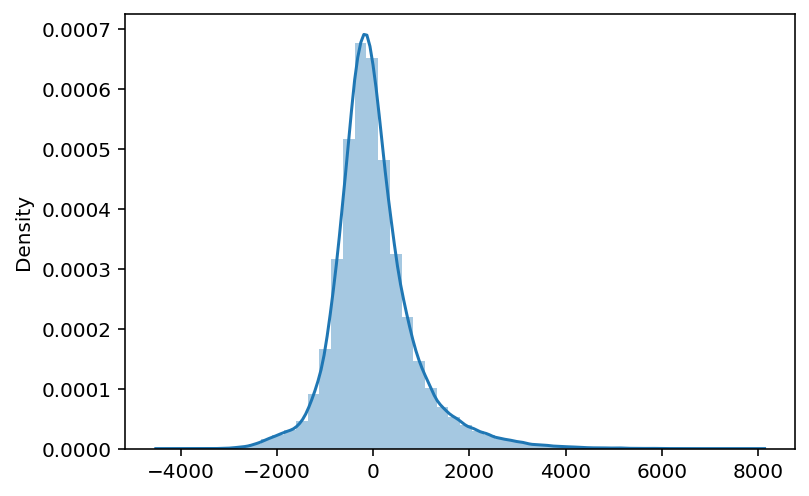

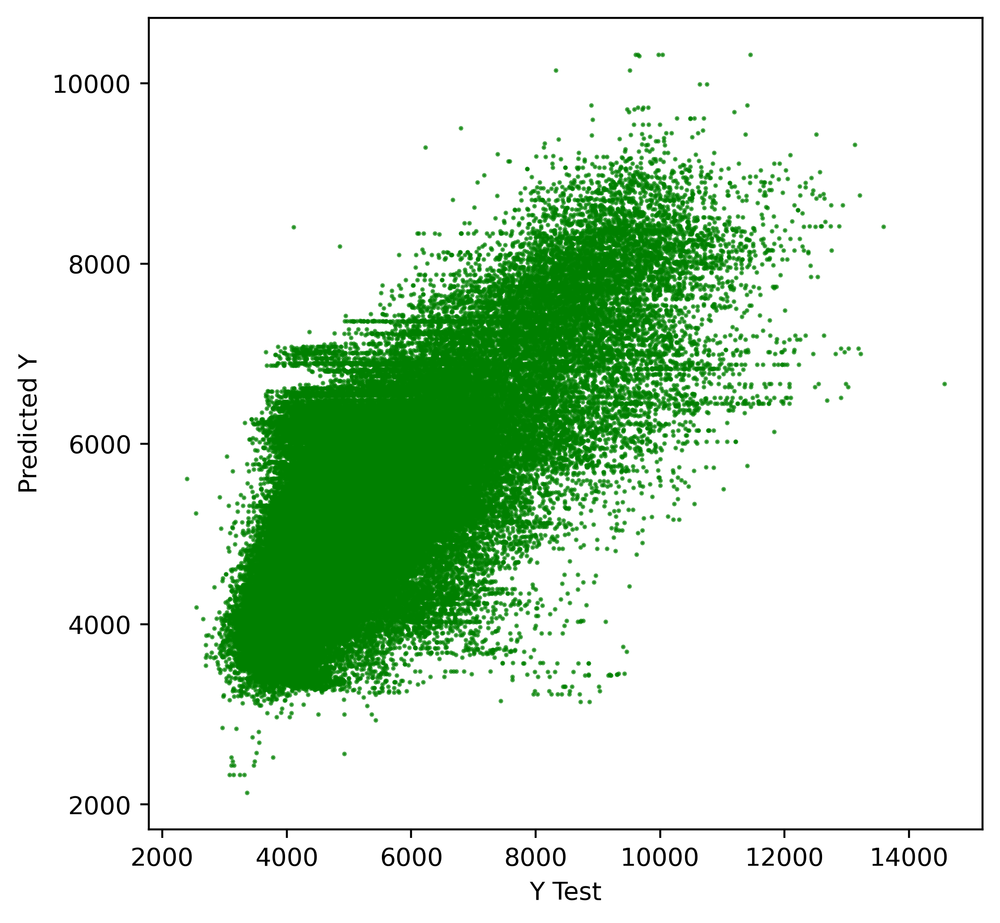


Feature ranking:
1. remaining_lease_years (0.205405)
2. n_rooms (0.172180)
3. region_Central (0.135856)
4. floor_area_sqm (0.115821)
5. flat_type_4 Room (0.045917)
6. town_Woodlands (0.024790)
7. flat_model_Standard (0.022148)
8. region_West (0.020806)
9. town_Clementi (0.019784)
10. region_North (0.016063)
11. flat_model_Improved (0.013596)
12. town_Jurong West (0.013372)
13. storey_range_avg (0.013304)
14. storey_range_min (0.013265)
15. storey_range_max (0.011290)
16. region_East (0.010336)
17. town_Marine Parade (0.008930)
18. town_Ang Mo Kio (0.008292)
19. town_Geylang (0.008077)
20. town_Central Area (0.008054)
21. town_Bukit Batok (0.007630)
22. town_Tampines (0.007159)
23. town_Jurong East (0.006895)
24. town_Bukit Merah (0.006407)
25. town_Queenstown (0.004892)
26. town_Hougang (0.004765)
27. town_Serangoon (0.004750)
28. flat_model_New Generation (0.004178)
29. town_Toa Payoh (0.004177)
30. flat_model_Model A (0.004117)
31. flat_model_Simplified (0.004092)
32. town_Pasir Ris

datetime.timedelta(seconds=31, microseconds=136896)

In [143]:
a = dt.now()
model_random_forest(df_ml_2)
b = dt.now()
b-a

---
---

Scenario = `Rely on hot-encoded storey ranges.`

In [144]:
c2u = ['floor_area_sqm',
 'n_rooms',
 'price_per_sq_m_norm',
 'remaining_lease_years',
 'flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']

In [145]:
df_ml_3 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 607.5797008224247
Mean Squared Error:..... 745450.93
RMSE: .................. 863.3950028586779
Coeff of det (R^2):..... 0.564
Score .................. 0.5644295614595887

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 275.87626947997296
Mean Squared Error:..... 155475.52
RMSE: .................. 394.3038466028015
Coeff of det (R^2):..... 0.858
Score .................. 0.8584575594291601

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


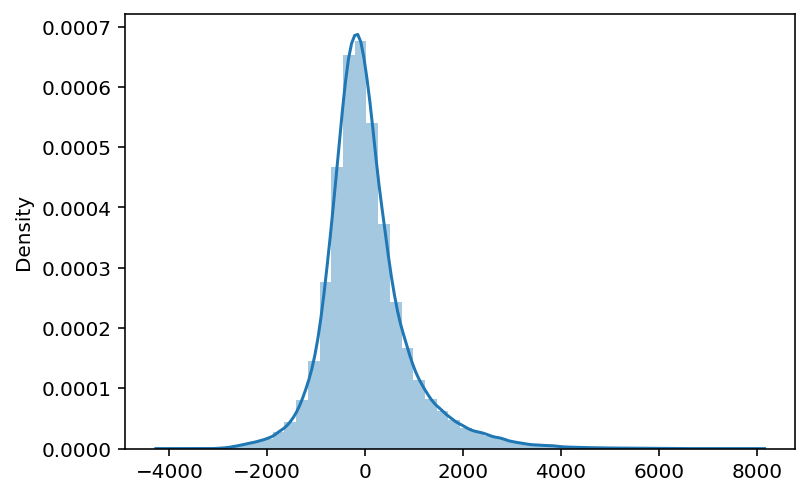

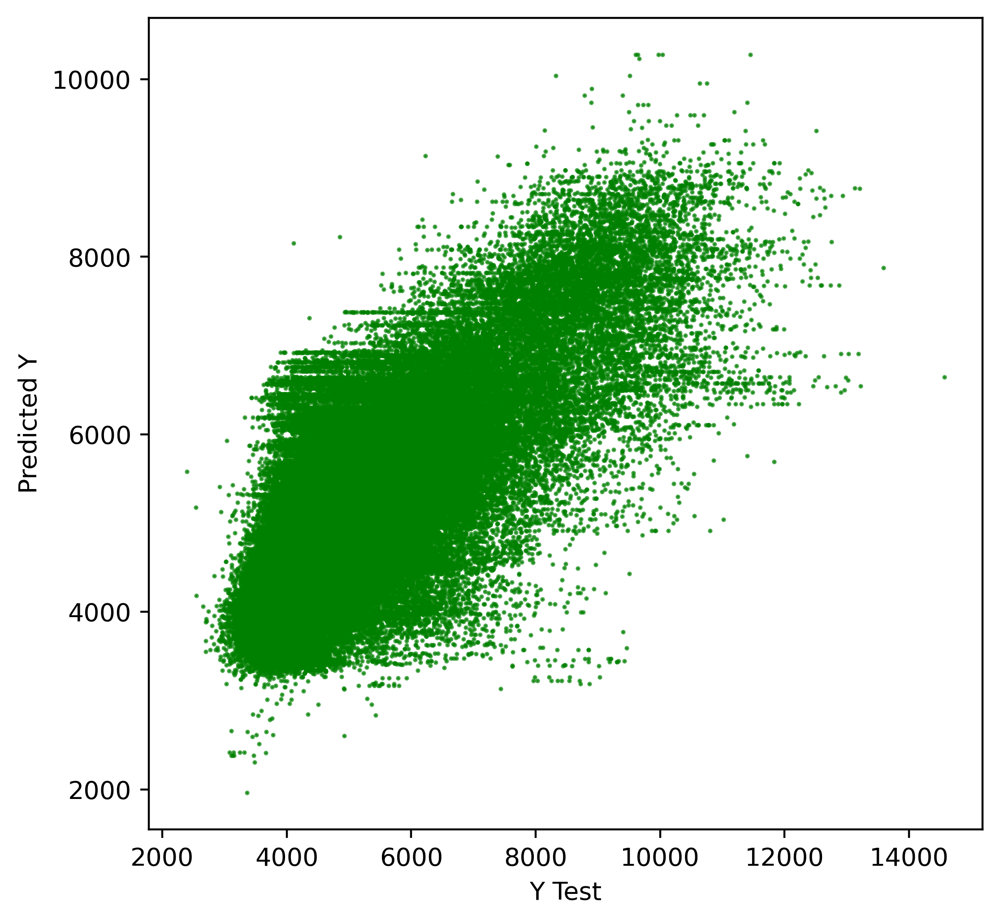


Feature ranking:
1. remaining_lease_years (0.206889)
2. n_rooms (0.169737)
3. region_Central (0.135856)
4. floor_area_sqm (0.117950)
5. flat_type_4 Room (0.047874)
6. town_Woodlands (0.024775)
7. flat_model_Standard (0.022609)
8. region_West (0.021960)
9. town_Clementi (0.020310)
10. region_North (0.016182)
11. flat_model_Improved (0.013723)
12. town_Jurong West (0.011900)
13. storey_range_01 TO 03 (0.011741)
14. region_East (0.010072)
15. town_Ang Mo Kio (0.009008)
16. town_Marine Parade (0.008342)
17. town_Central Area (0.008219)
18. town_Bukit Batok (0.008180)
19. town_Geylang (0.007927)
20. town_Bukit Merah (0.007840)
21. town_Tampines (0.007463)
22. town_Jurong East (0.007201)
23. storey_range_04 TO 06 (0.007035)
24. town_Queenstown (0.006184)
25. storey_range_07 TO 09 (0.005235)
26. storey_range_10 TO 12 (0.005189)
27. flat_model_Model A (0.004887)
28. flat_model_New Generation (0.004726)
29. town_Serangoon (0.004710)
30. town_Hougang (0.004644)
31. town_Toa Payoh (0.004424)
32.

datetime.timedelta(seconds=26, microseconds=732131)

In [146]:
a = dt.now()
model_random_forest(df_ml_3)
b = dt.now()
b-a

---
---

Scenario = `Remove hot encoded storey ranges.`

In [147]:
c2u = ['floor_area_sqm',
       
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
       
 'n_rooms',
 'price_per_sq_m_norm',
 'remaining_lease_years',
       
 'flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']

In [148]:
df_ml_4 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 604.999084271769
Mean Squared Error:..... 736900.76
RMSE: .................. 858.429237743677
Coeff of det (R^2):..... 0.569
Score .................. 0.5694254682456255

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 275.79496556725246
Mean Squared Error:..... 155451.67
RMSE: .................. 394.273597129152
Coeff of det (R^2):..... 0.858
Score .................. 0.8584792757787716

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


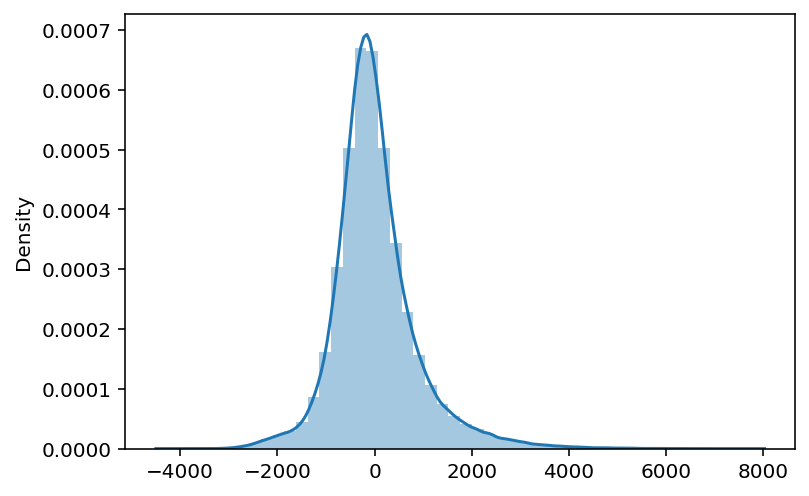

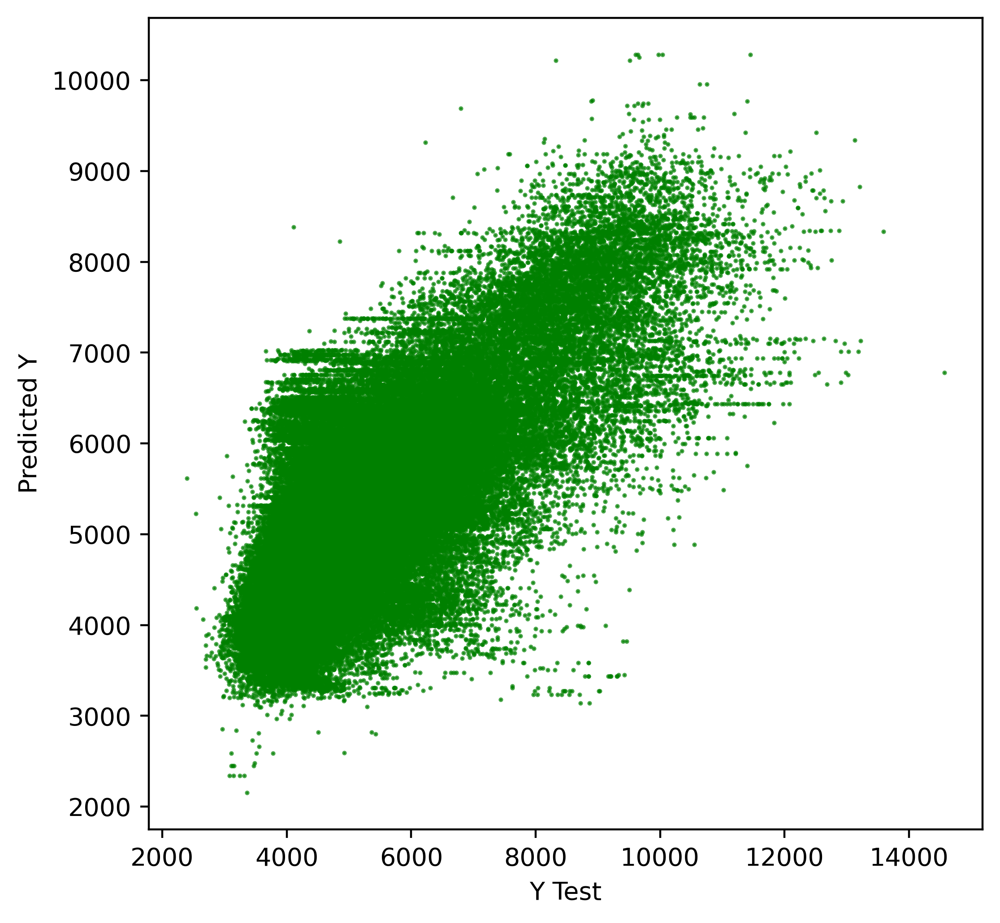


Feature ranking:
1. remaining_lease_years (0.205553)
2. n_rooms (0.175710)
3. region_Central (0.135856)
4. floor_area_sqm (0.116049)
5. flat_type_4 Room (0.042241)
6. town_Woodlands (0.024786)
7. flat_model_Standard (0.022184)
8. region_West (0.020795)
9. town_Clementi (0.019788)
10. storey_range_min (0.017327)
11. storey_range_avg (0.016176)
12. region_North (0.016085)
13. storey_range_max (0.015494)
14. flat_model_Improved (0.013568)
15. town_Jurong West (0.013360)
16. region_East (0.010367)
17. town_Marine Parade (0.008930)
18. town_Ang Mo Kio (0.008292)
19. town_Geylang (0.008087)
20. town_Central Area (0.008059)
21. town_Bukit Batok (0.007629)
22. town_Tampines (0.007173)
23. town_Jurong East (0.006900)
24. town_Bukit Merah (0.006413)
25. town_Queenstown (0.004900)
26. town_Hougang (0.004763)
27. town_Serangoon (0.004746)
28. flat_model_New Generation (0.004191)
29. town_Toa Payoh (0.004188)
30. flat_model_Model A (0.004094)
31. flat_model_Simplified (0.004081)
32. town_Pasir Ris

datetime.timedelta(seconds=25, microseconds=682301)

In [149]:
a = dt.now()
model_random_forest(df_ml_4)
b = dt.now()
b-a

---
---

Scenario = `Remove hot encoded storey ranges, and only keep storey_range_avg calculated.`

In [150]:
c2u = ['floor_area_sqm',
       
 'storey_range_avg',
       
 'n_rooms',
 'price_per_sq_m_norm',
 'remaining_lease_years',
       
 'flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']

In [151]:
df_ml_5 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 602.787586535688
Mean Squared Error:..... 727411.45
RMSE: .................. 852.8841946703635
Coeff of det (R^2):..... 0.575
Score .................. 0.5749701141864577

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 276.09314519724967
Mean Squared Error:..... 155664.00
RMSE: .................. 394.5427789328052
Coeff of det (R^2):..... 0.858
Score .................. 0.8582859693627147

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


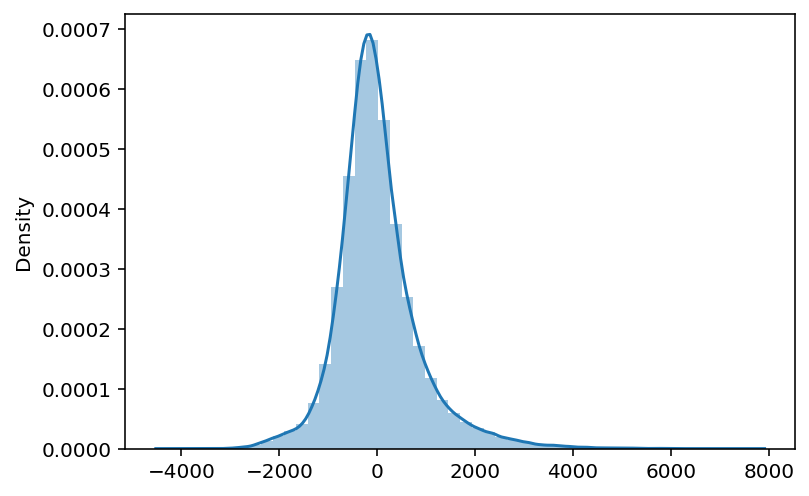

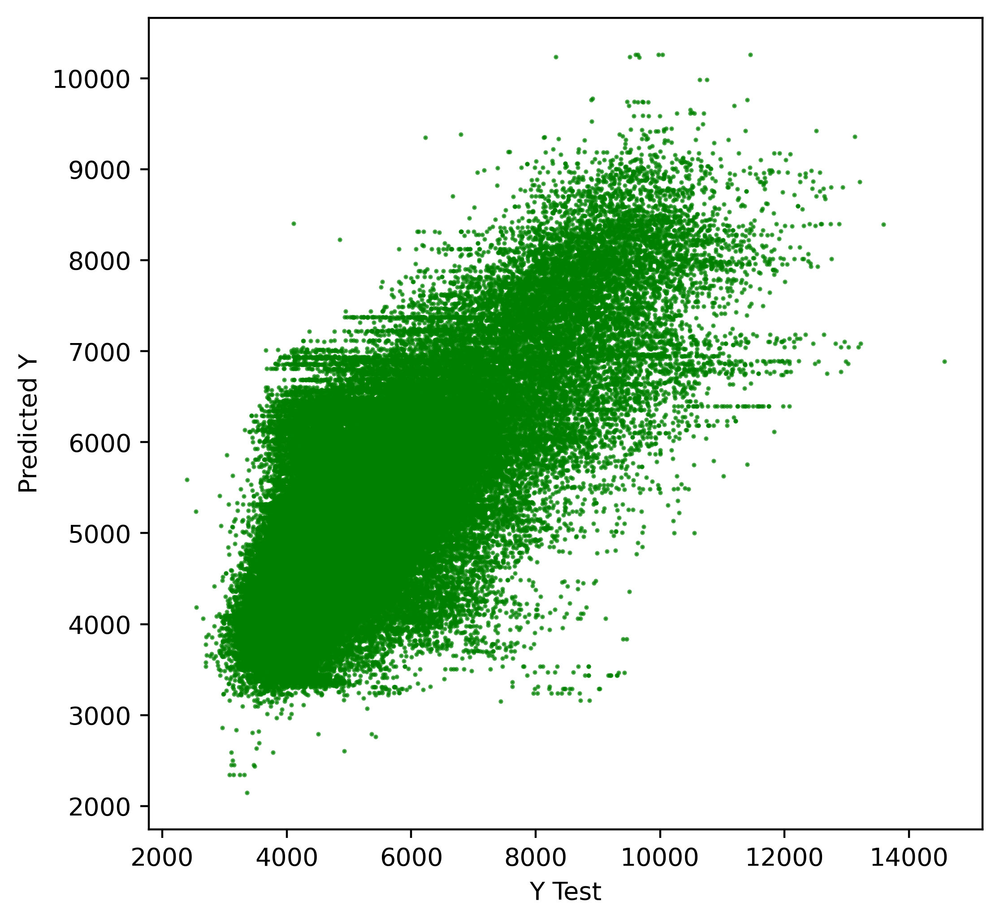


Feature ranking:
1. remaining_lease_years (0.205701)
2. n_rooms (0.161432)
3. region_Central (0.135888)
4. floor_area_sqm (0.116213)
5. flat_type_4 Room (0.056767)
6. storey_range_avg (0.048517)
7. town_Woodlands (0.024796)
8. flat_model_Standard (0.022185)
9. region_West (0.020837)
10. town_Clementi (0.019779)
11. region_North (0.016136)
12. flat_model_Improved (0.013589)
13. town_Jurong West (0.013388)
14. region_East (0.010394)
15. town_Marine Parade (0.008933)
16. town_Ang Mo Kio (0.008300)
17. town_Geylang (0.008092)
18. town_Central Area (0.008058)
19. town_Bukit Batok (0.007635)
20. town_Tampines (0.007181)
21. town_Jurong East (0.006871)
22. town_Bukit Merah (0.006417)
23. town_Queenstown (0.004898)
24. town_Hougang (0.004767)
25. town_Serangoon (0.004759)
26. flat_model_New Generation (0.004252)
27. town_Toa Payoh (0.004197)
28. flat_model_Simplified (0.004105)
29. flat_model_Model A (0.004031)
30. town_Pasir Ris (0.003700)
31. flat_model_Maisonette (0.003672)
32. town_Bishan

datetime.timedelta(seconds=20, microseconds=135977)

In [152]:
a = dt.now()
model_random_forest(df_ml_5)
b = dt.now()
b-a

---
---

Scenario = `keep one-hot-encoded storey range + avg storey range`

In [156]:
c2u = ['floor_area_sqm',
       
 'storey_range_avg',
       
 'n_rooms',
       
 'price_per_sq_m_norm',
 
 'remaining_lease_years',
       
 'flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun',  
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51']


In [157]:
df_ml_6 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 603.3264351456322
Mean Squared Error:..... 729352.61
RMSE: .................. 854.0214346479022
Coeff of det (R^2):..... 0.574
Score .................. 0.5738358846186682

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 275.82683638996895
Mean Squared Error:..... 155449.43
RMSE: .................. 394.270752027713
Coeff of det (R^2):..... 0.858
Score .................. 0.858481318215122

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


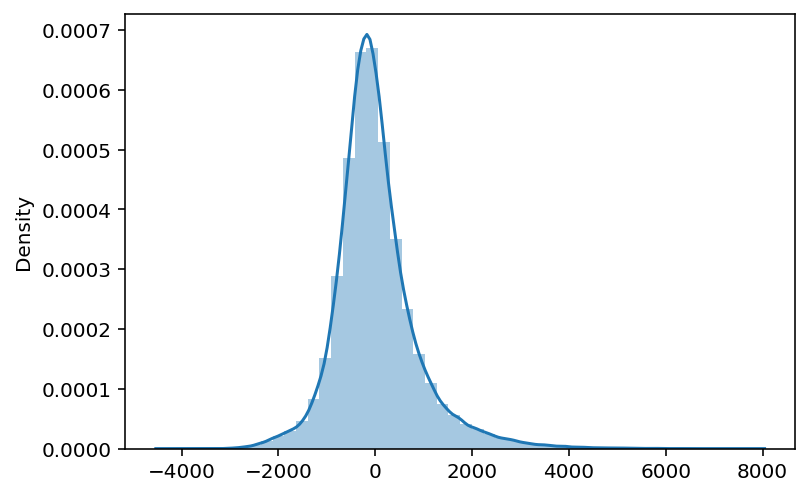

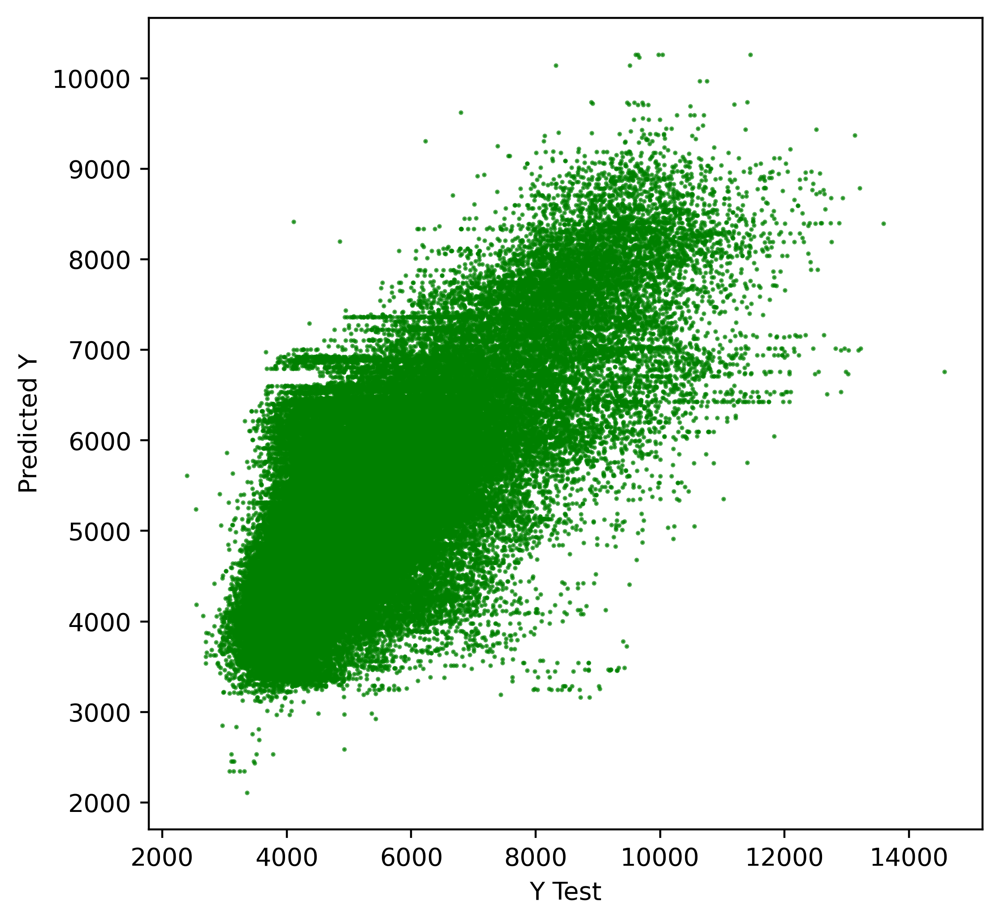


Feature ranking:
1. remaining_lease_years (0.205418)
2. n_rooms (0.178019)
3. region_Central (0.135856)
4. floor_area_sqm (0.115866)
5. flat_type_4 Room (0.039899)
6. storey_range_avg (0.034035)
7. town_Woodlands (0.024793)
8. flat_model_Standard (0.022176)
9. region_West (0.020794)
10. town_Clementi (0.019785)
11. region_North (0.016111)
12. flat_model_Improved (0.013580)
13. town_Jurong West (0.013373)
14. region_East (0.010325)
15. town_Marine Parade (0.008930)
16. town_Ang Mo Kio (0.008288)
17. town_Geylang (0.008080)
18. town_Central Area (0.008057)
19. town_Bukit Batok (0.007631)
20. town_Tampines (0.007178)
21. town_Jurong East (0.006901)
22. town_Bukit Merah (0.006408)
23. town_Queenstown (0.004877)
24. town_Hougang (0.004757)
25. town_Serangoon (0.004749)
26. town_Toa Payoh (0.004188)
27. flat_model_New Generation (0.004169)
28. flat_model_Simplified (0.004083)
29. flat_model_Model A (0.004082)
30. town_Pasir Ris (0.003764)
31. flat_model_Maisonette (0.003661)
32. town_Bishan

datetime.timedelta(seconds=32, microseconds=352225)

In [158]:
a = dt.now()
model_random_forest(df_ml_6)
b = dt.now()
b-a

---
---

Scenario = 

In [159]:
c2u = ['floor_area_sqm', 
       'n_rooms', 
       'price_per_sq_m_norm', 
       'remaining_lease_years',
 
 'storey_range_max',
 'storey_range_min',
       
 'flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
       
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
       
 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
       
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun',  
       
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51']


In [160]:
df_ml_7 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 603.7867402218262
Mean Squared Error:..... 732949.99
RMSE: .................. 856.1249823077793
Coeff of det (R^2):..... 0.572
Score .................. 0.5717339220070197

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 275.8280721751428
Mean Squared Error:..... 155448.85
RMSE: .................. 394.2700211731342
Coeff of det (R^2):..... 0.858
Score .................. 0.8584818428773251

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


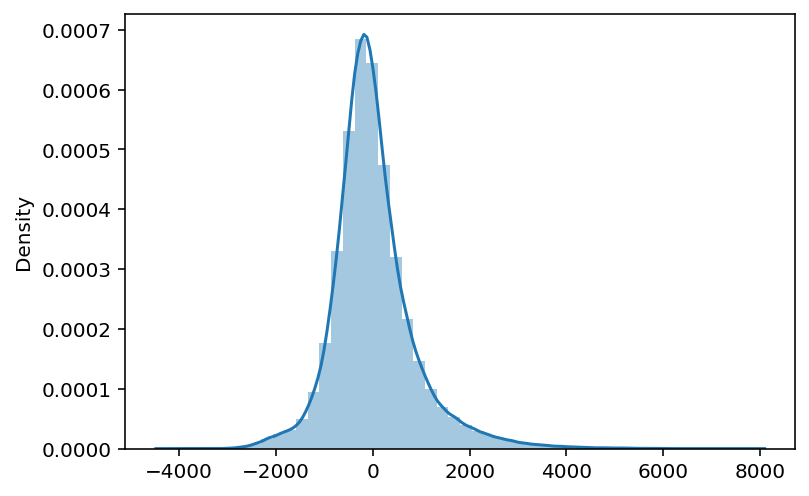

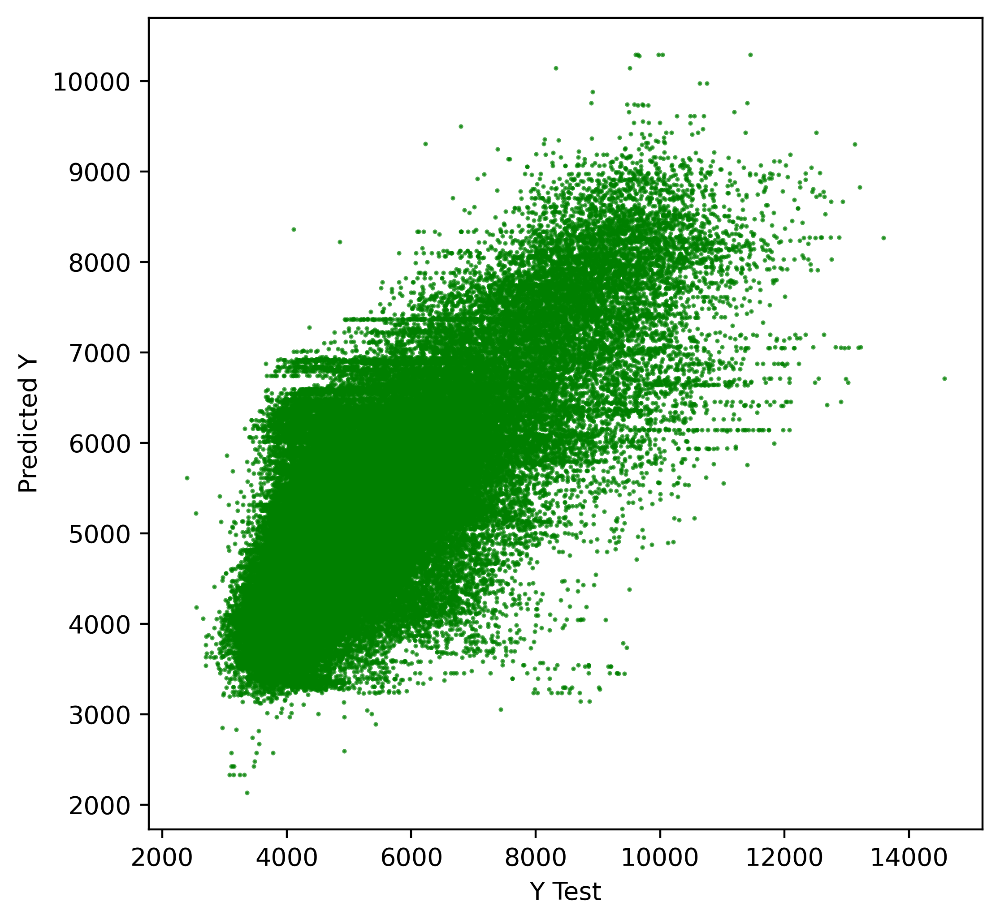


Feature ranking:
1. remaining_lease_years (0.205414)
2. n_rooms (0.177282)
3. region_Central (0.135856)
4. floor_area_sqm (0.115909)
5. flat_type_4 Room (0.040547)
6. town_Woodlands (0.024790)
7. flat_model_Standard (0.022164)
8. region_West (0.020766)
9. storey_range_min (0.019861)
10. town_Clementi (0.019786)
11. storey_range_max (0.016596)
12. region_North (0.016142)
13. flat_model_Improved (0.013573)
14. town_Jurong West (0.013376)
15. region_East (0.010350)
16. town_Marine Parade (0.008931)
17. town_Ang Mo Kio (0.008302)
18. town_Geylang (0.008075)
19. town_Central Area (0.008053)
20. town_Bukit Batok (0.007628)
21. town_Tampines (0.007167)
22. town_Jurong East (0.006924)
23. town_Bukit Merah (0.006414)
24. town_Queenstown (0.004884)
25. town_Hougang (0.004767)
26. town_Serangoon (0.004755)
27. flat_model_New Generation (0.004205)
28. town_Toa Payoh (0.004182)
29. flat_model_Simplified (0.004090)
30. flat_model_Model A (0.004049)
31. town_Pasir Ris (0.003719)
32. flat_model_Maiso

datetime.timedelta(seconds=28, microseconds=666070)

In [161]:
a = dt.now()
model_random_forest(df_ml_7)
b = dt.now()
b-a

---
---

Scenario = `Remove hot encoded storey ranges, and only keep storey_range_avg calculated.`

In [150]:
c2u = ['floor_area_sqm', 
       'n_rooms', 
       'price_per_sq_m_norm', 
       'remaining_lease_years',
 
 'storey_range_max',
 'storey_range_min',
 'storey_range_avg', 
       
       
 'n_rooms',
 'price_per_sq_m_norm',
 'remaining_lease_years',
       
 'flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',

 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
       
 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
 
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']

In [151]:
df_ml_5 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 602.787586535688
Mean Squared Error:..... 727411.45
RMSE: .................. 852.8841946703635
Coeff of det (R^2):..... 0.575
Score .................. 0.5749701141864577

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 276.09314519724967
Mean Squared Error:..... 155664.00
RMSE: .................. 394.5427789328052
Coeff of det (R^2):..... 0.858
Score .................. 0.8582859693627147

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


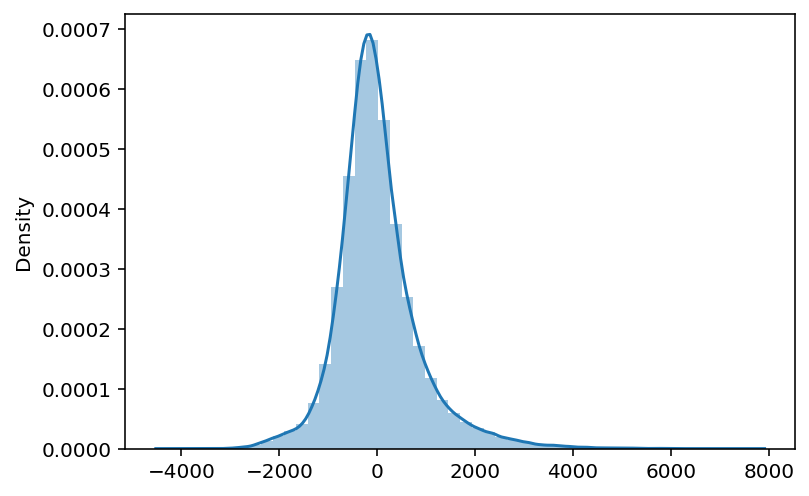

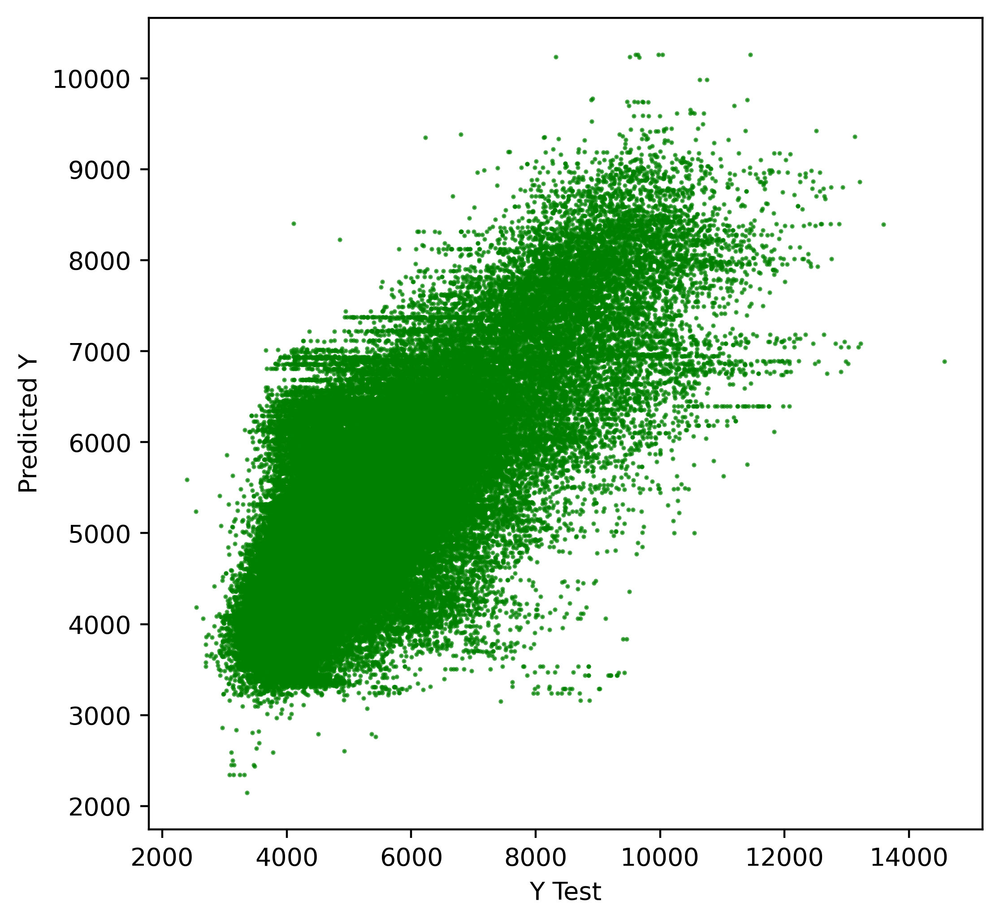


Feature ranking:
1. remaining_lease_years (0.205701)
2. n_rooms (0.161432)
3. region_Central (0.135888)
4. floor_area_sqm (0.116213)
5. flat_type_4 Room (0.056767)
6. storey_range_avg (0.048517)
7. town_Woodlands (0.024796)
8. flat_model_Standard (0.022185)
9. region_West (0.020837)
10. town_Clementi (0.019779)
11. region_North (0.016136)
12. flat_model_Improved (0.013589)
13. town_Jurong West (0.013388)
14. region_East (0.010394)
15. town_Marine Parade (0.008933)
16. town_Ang Mo Kio (0.008300)
17. town_Geylang (0.008092)
18. town_Central Area (0.008058)
19. town_Bukit Batok (0.007635)
20. town_Tampines (0.007181)
21. town_Jurong East (0.006871)
22. town_Bukit Merah (0.006417)
23. town_Queenstown (0.004898)
24. town_Hougang (0.004767)
25. town_Serangoon (0.004759)
26. flat_model_New Generation (0.004252)
27. town_Toa Payoh (0.004197)
28. flat_model_Simplified (0.004105)
29. flat_model_Model A (0.004031)
30. town_Pasir Ris (0.003700)
31. flat_model_Maisonette (0.003672)
32. town_Bishan

datetime.timedelta(seconds=20, microseconds=135977)

In [152]:
a = dt.now()
model_random_forest(df_ml_5)
b = dt.now()
b-a

---
---

Scenario = `superall`

In [170]:

c2u = \
['flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
    
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
    
 'floor_area_sqm',
 
 'lease_commence_date',
 
 'n_rooms',

 'price_per_sq_m_norm',

 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
    
 'remaining_lease_years',
 
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
    
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
    
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [171]:
df_ml_10 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 520.127966488454
Mean Squared Error:..... 514908.98
RMSE: .................. 717.5715863397116
Coeff of det (R^2):..... 0.699
Score .................. 0.6991362924441691

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 211.3297430668004
Mean Squared Error:..... 96390.97
RMSE: .................. 310.46894716381513
Coeff of det (R^2):..... 0.912
Score .................. 0.912247198546467

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


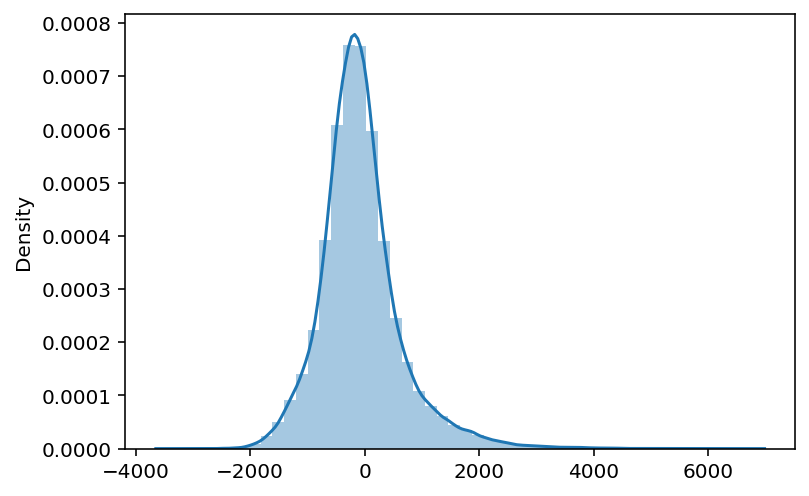

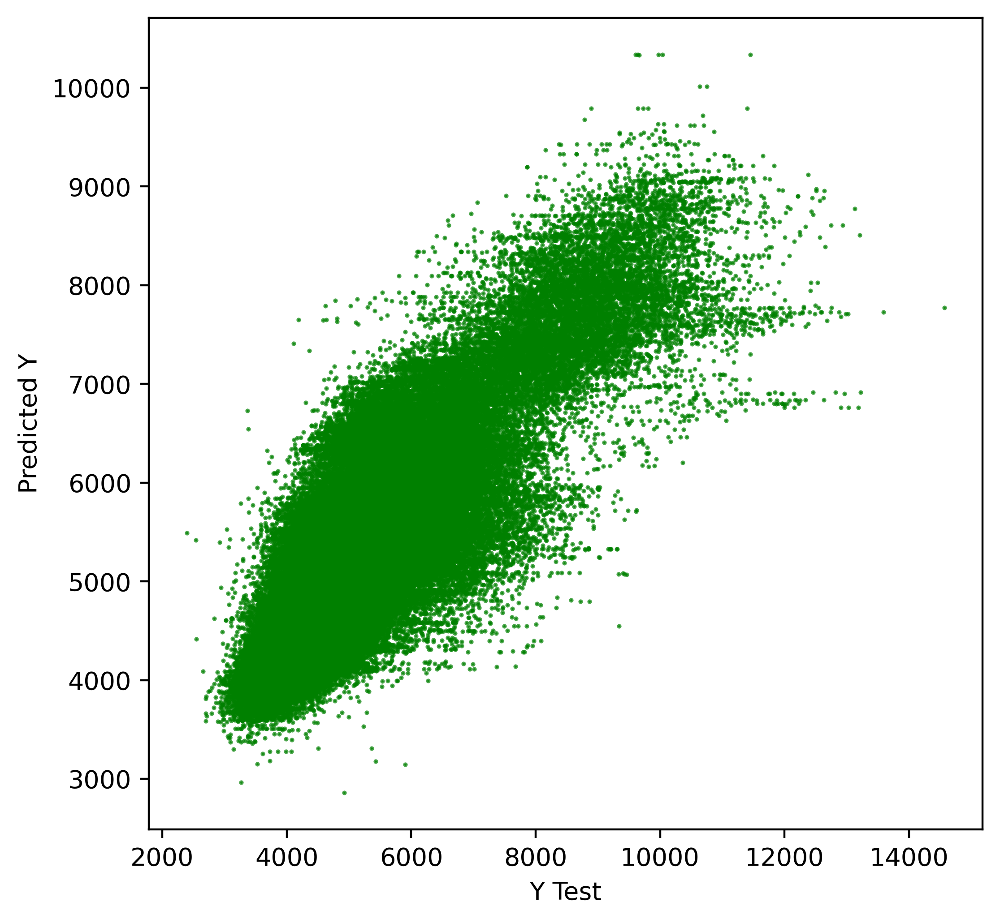


Feature ranking:
1. remaining_lease_years (0.194027)
2. lease_commence_date (0.179890)
3. n_rooms (0.169917)
4. region_Central (0.127993)
5. floor_area_sqm (0.053333)
6. flat_type_4 Room (0.036309)
7. region_West (0.020837)
8. region_North (0.020670)
9. town_Woodlands (0.015227)
10. town_Clementi (0.014653)
11. storey_range_min (0.010898)
12. flat_type_5 Room (0.010611)
13. storey_range_avg (0.009699)
14. storey_range_max (0.008419)
15. town_Jurong West (0.008405)
16. town_Marine Parade (0.007760)
17. town_Geylang (0.007259)
18. town_Tampines (0.006773)
19. town_Ang Mo Kio (0.006007)
20. town_Central Area (0.005285)
21. town_Jurong East (0.004531)
22. town_Bukit Batok (0.004520)
23. town_Bukit Merah (0.004461)
24. flat_model_Improved (0.004302)
25. town_Queenstown (0.004156)
26. flat_model_Terrace (0.004033)
27. town_Toa Payoh (0.003995)
28. flat_model_Standard (0.003319)
29. region_East (0.003316)
30. town_Serangoon (0.003212)
31. flat_model_New Generation (0.003120)
32. town_Choa Ch

datetime.timedelta(seconds=33, microseconds=210519)

In [172]:
a = dt.now()
model_random_forest(df_ml_10)
b = dt.now()
b-a

---
---

Scenario = `interesting:  removing just one hurts.`

In [179]:

c2u = \
['flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
    
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
    
 'floor_area_sqm',
 
 # 'lease_commence_date',
 
 'n_rooms',

 'price_per_sq_m_norm',

 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
    
 'remaining_lease_years',
 
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
    
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
    
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [180]:
df_ml_11 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 603.4517081896556
Mean Squared Error:..... 729983.34
RMSE: .................. 854.3906269354543
Coeff of det (R^2):..... 0.573
Score .................. 0.5734673446583753

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 275.8335157781131
Mean Squared Error:..... 155454.42
RMSE: .................. 394.27709030842624
Coeff of det (R^2):..... 0.858
Score .................. 0.8584767680813032

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


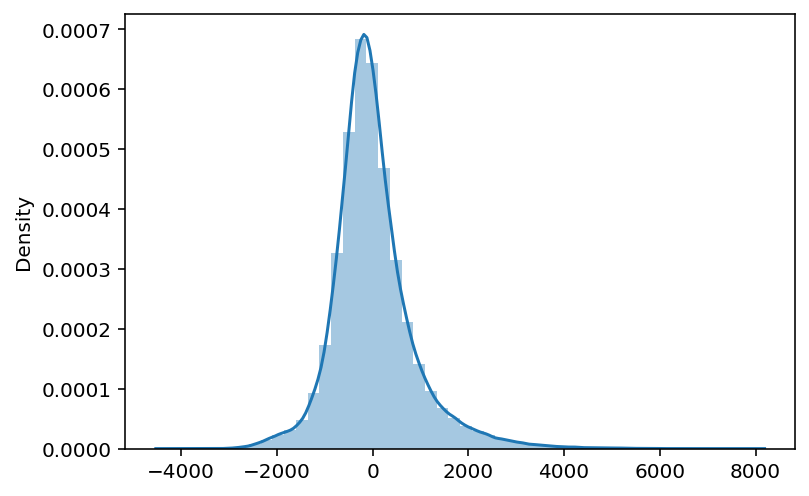

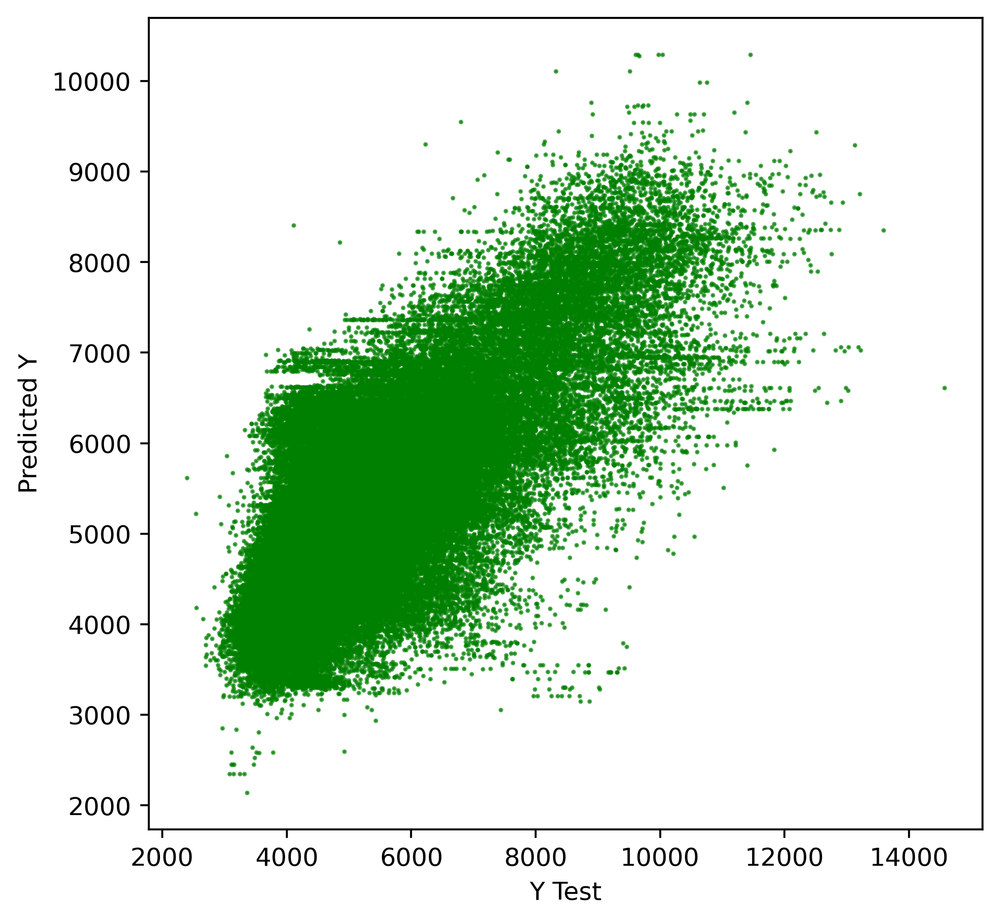


Feature ranking:
1. remaining_lease_years (0.205405)
2. n_rooms (0.174556)
3. region_Central (0.135856)
4. floor_area_sqm (0.115897)
5. flat_type_4 Room (0.043187)
6. town_Woodlands (0.024794)
7. flat_model_Standard (0.022169)
8. region_West (0.020790)
9. town_Clementi (0.019793)
10. region_North (0.016085)
11. flat_model_Improved (0.013593)
12. town_Jurong West (0.013367)
13. storey_range_avg (0.013072)
14. storey_range_min (0.012946)
15. storey_range_max (0.011879)
16. region_East (0.010304)
17. town_Marine Parade (0.008931)
18. town_Ang Mo Kio (0.008291)
19. town_Geylang (0.008078)
20. town_Central Area (0.008050)
21. town_Bukit Batok (0.007630)
22. town_Tampines (0.007170)
23. town_Jurong East (0.006901)
24. town_Bukit Merah (0.006406)
25. town_Queenstown (0.004896)
26. town_Serangoon (0.004768)
27. town_Hougang (0.004750)
28. flat_model_New Generation (0.004220)
29. town_Toa Payoh (0.004184)
30. flat_model_Simplified (0.004087)
31. flat_model_Model A (0.004028)
32. town_Pasir Ris

datetime.timedelta(seconds=34, microseconds=668004)

In [181]:
a = dt.now()
model_random_forest(df_ml_11)
b = dt.now()
b-a

---
---

Scenario = `fully rely on categorical storeys, with removal of region.`

In [182]:

# i dont like this, i want to believe region is helpful...
# but its possible its NOT 

c2u = \
['flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
    
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
    
 'floor_area_sqm',
 
 'lease_commence_date',
 
 'n_rooms',

 'price_per_sq_m_norm',

 # 'region_Central',  removing region, which i dont want to do
 # 'region_East',
 # 'region_North',
 # 'region_North-East',
 # 'region_West',
    
 'remaining_lease_years',
 
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
    
 # 'storey_range_avg',
 # 'storey_range_max',
 # 'storey_range_min',
    
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [183]:
df_ml_12 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 558.5545920185702
Mean Squared Error:..... 610050.09
RMSE: .................. 781.0570311706138
Coeff of det (R^2):..... 0.644
Score .................. 0.6435449035897146

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 211.39024242725046
Mean Squared Error:..... 96376.94
RMSE: .................. 310.4463588030182
Coeff of det (R^2):..... 0.912
Score .................. 0.9122599671009423

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


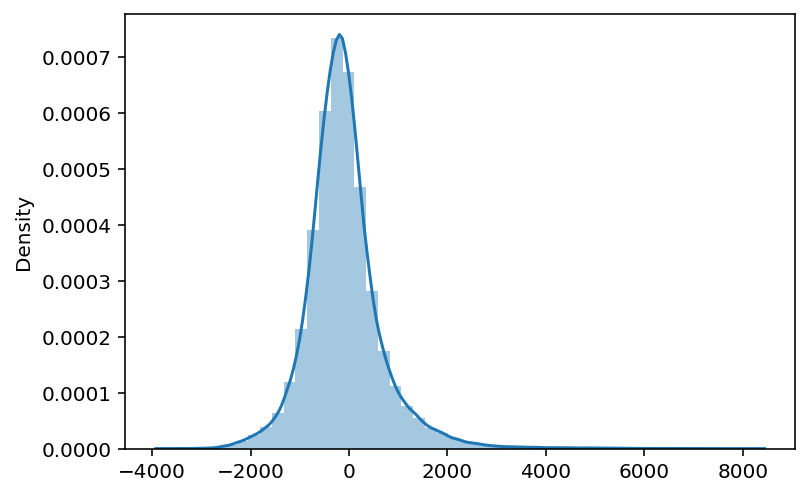

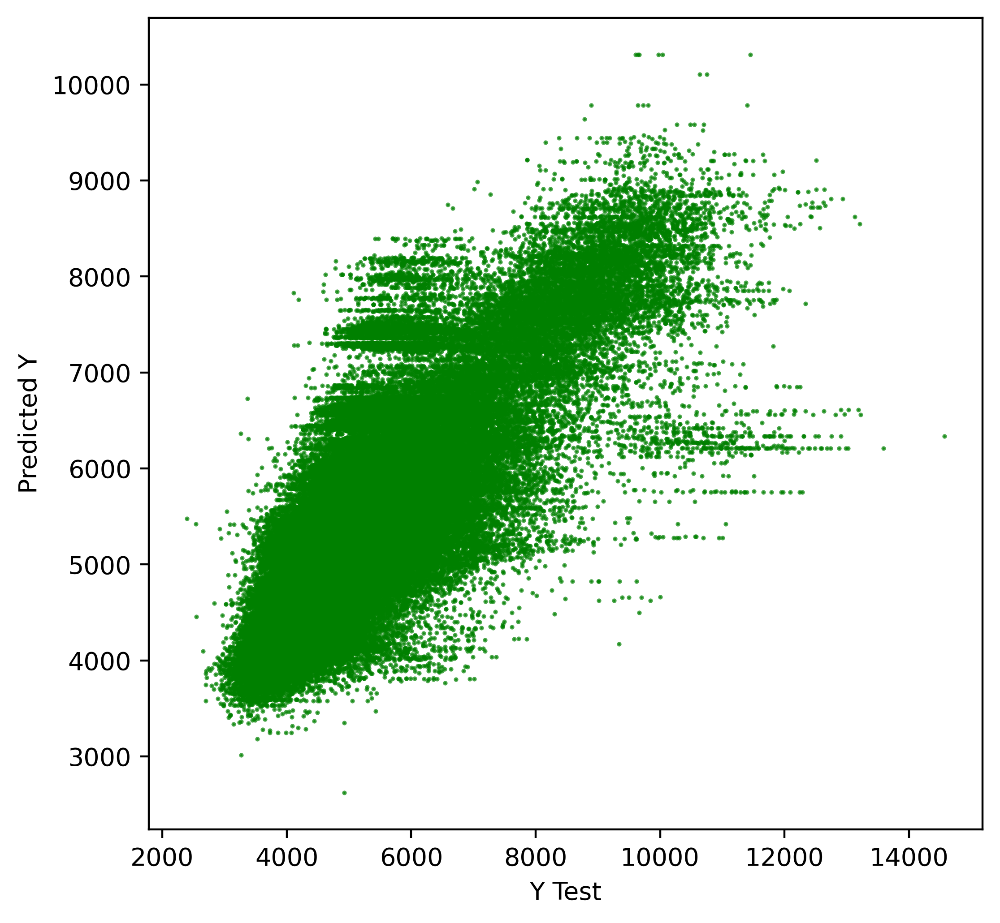


Feature ranking:
1. remaining_lease_years (0.187661)
2. lease_commence_date (0.176442)
3. n_rooms (0.141582)
4. floor_area_sqm (0.054644)
5. town_Woodlands (0.045094)
6. town_Bukit Merah (0.044165)
7. town_Jurong West (0.039815)
8. town_Bishan (0.037745)
9. town_Queenstown (0.026679)
10. flat_type_4 Room (0.020711)
11. town_Toa Payoh (0.016454)
12. town_Marine Parade (0.015042)
13. town_Yishun (0.013362)
14. town_Choa Chu Kang (0.013221)
15. town_Central Area (0.012899)
16. town_Kallang/Whampoa (0.012361)
17. storey_range_01 TO 03 (0.010934)
18. town_Bukit Panjang (0.010925)
19. town_Jurong East (0.008069)
20. town_Clementi (0.007359)
21. storey_range_04 TO 06 (0.006923)
22. town_Ang Mo Kio (0.006766)
23. flat_model_Improved (0.006567)
24. town_Geylang (0.006489)
25. flat_type_5 Room (0.006084)
26. town_Tampines (0.005607)
27. storey_range_07 TO 09 (0.005095)
28. storey_range_10 TO 12 (0.004991)
29. town_Bedok (0.004813)
30. flat_model_Terrace (0.004452)
31. town_Bukit Batok (0.004323

datetime.timedelta(seconds=41, microseconds=102349)

In [184]:
a = dt.now()
model_random_forest(df_ml_12)
b = dt.now()
b-a

---
---

Scenario = `keep region out of the equation + remove lease commence date`

In [186]:

c2u = \
['flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
    
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
    
 'floor_area_sqm',
 
 # 'lease_commence_date',  *** 
 
 'n_rooms',

 'price_per_sq_m_norm',

 # 'region_Central',  removing region, which i dont want to do
 # 'region_East',
 # 'region_North',
 # 'region_North-East',
 # 'region_West',
    
 'remaining_lease_years',
 
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
    
 # 'storey_range_avg',
 # 'storey_range_max',
 # 'storey_range_min',
    
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [187]:
df_ml_13 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 614.2282470419374
Mean Squared Error:..... 776386.09
RMSE: .................. 881.1277398983326
Coeff of det (R^2):..... 0.546
Score .................. 0.5463540021176974

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 275.9049895028756
Mean Squared Error:..... 155487.96
RMSE: .................. 394.3196203526479
Coeff of det (R^2):..... 0.858
Score .................. 0.8584462346615878

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


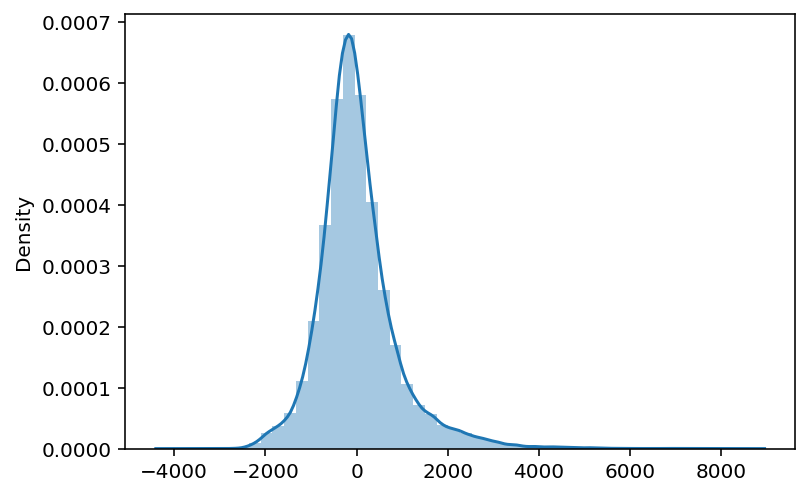

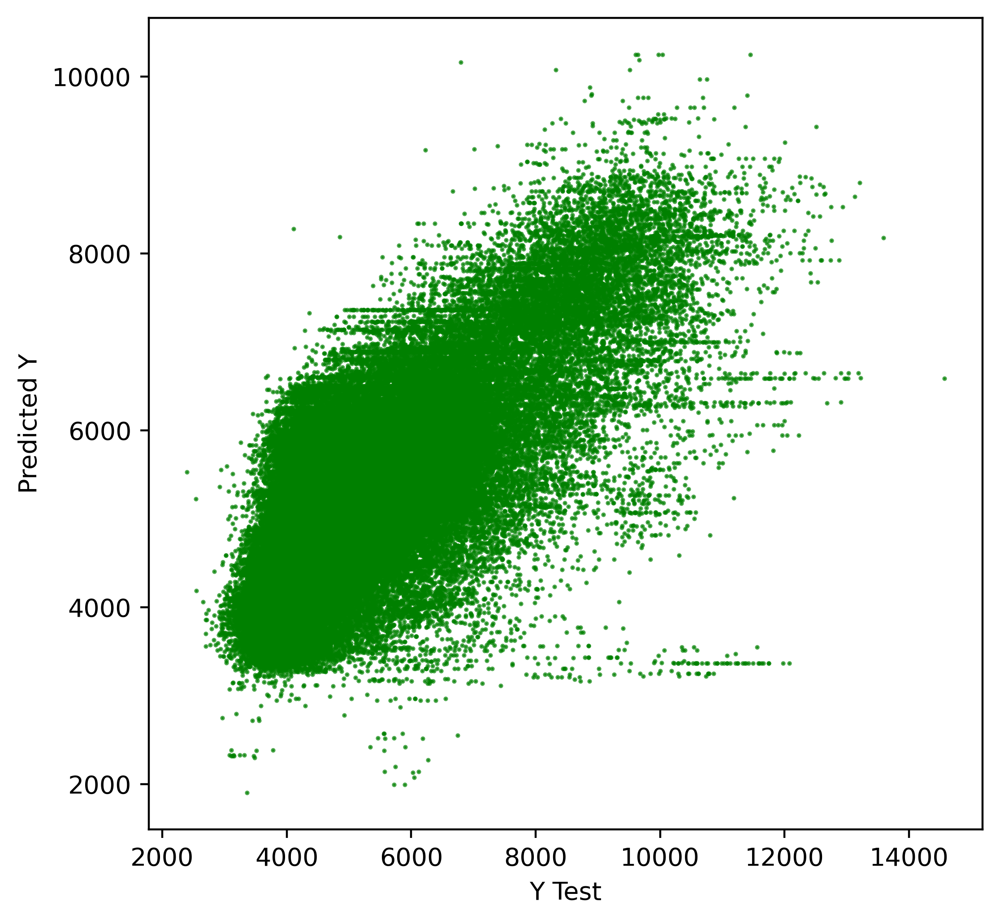


Feature ranking:
1. remaining_lease_years (0.194827)
2. n_rooms (0.150729)
3. floor_area_sqm (0.120477)
4. town_Bukit Merah (0.047164)
5. town_Woodlands (0.047065)
6. town_Jurong West (0.043196)
7. town_Bishan (0.042697)
8. flat_model_Standard (0.034761)
9. town_Queenstown (0.027328)
10. flat_type_4 Room (0.019597)
11. town_Choa Chu Kang (0.018371)
12. town_Toa Payoh (0.017829)
13. town_Marine Parade (0.015956)
14. flat_model_Improved (0.014177)
15. town_Bukit Panjang (0.014161)
16. town_Central Area (0.014022)
17. town_Yishun (0.013607)
18. town_Kallang/Whampoa (0.012937)
19. storey_range_01 TO 03 (0.011538)
20. town_Clementi (0.009841)
21. town_Jurong East (0.009233)
22. town_Geylang (0.008584)
23. town_Ang Mo Kio (0.007549)
24. storey_range_04 TO 06 (0.007117)
25. town_Tampines (0.006675)
26. town_Sembawang (0.005914)
27. flat_model_Model A (0.005876)
28. town_Pasir Ris (0.005838)
29. town_Sengkang (0.005623)
30. storey_range_10 TO 12 (0.005178)
31. storey_range_07 TO 09 (0.005145)

datetime.timedelta(seconds=37, microseconds=866986)

In [188]:
a = dt.now()
model_random_forest(df_ml_13)
b = dt.now()
b-a

---
---

Scenario = `see below.`

In [189]:

c2u = \
['flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
    
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
    
 'floor_area_sqm',
 
 'lease_commence_date',   
 
 'n_rooms',

 'price_per_sq_m_norm',

 # 'region_Central',  removing region, which i dont want to do
 # 'region_East',
 # 'region_North',
 # 'region_North-East',
 # 'region_West',
    
 'remaining_lease_years',
 
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
    
 # 'storey_range_avg',
 # 'storey_range_max',
 # 'storey_range_min',
    
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [190]:
df_ml_14 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 558.5545920185702
Mean Squared Error:..... 610050.09
RMSE: .................. 781.0570311706138
Coeff of det (R^2):..... 0.644
Score .................. 0.6435449035897146

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 211.39024242725046
Mean Squared Error:..... 96376.94
RMSE: .................. 310.4463588030182
Coeff of det (R^2):..... 0.912
Score .................. 0.9122599671009423

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


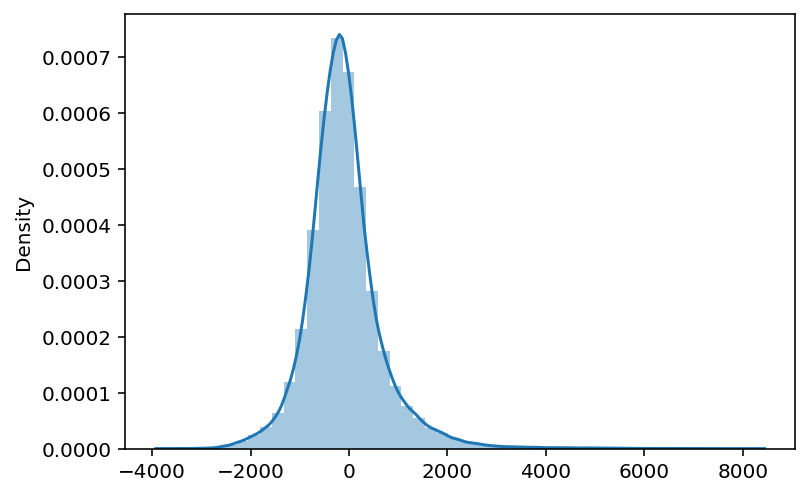

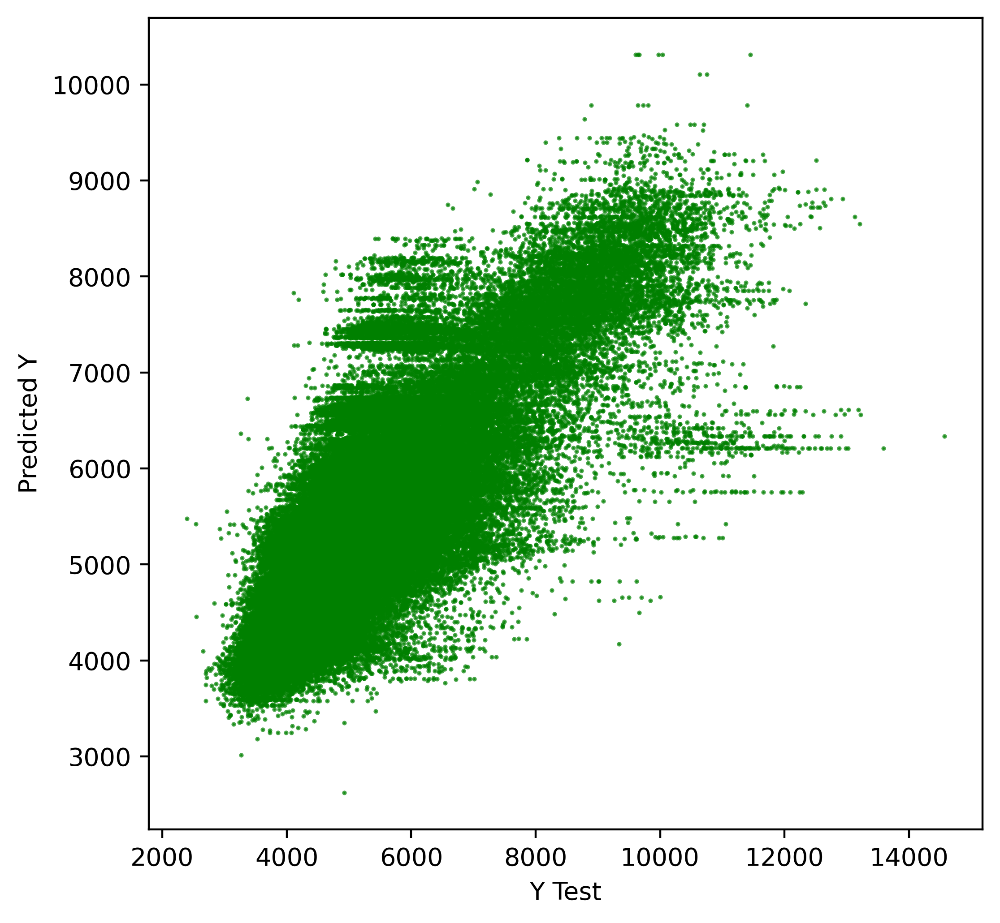


Feature ranking:
1. remaining_lease_years (0.187661)
2. lease_commence_date (0.176442)
3. n_rooms (0.141582)
4. floor_area_sqm (0.054644)
5. town_Woodlands (0.045094)
6. town_Bukit Merah (0.044165)
7. town_Jurong West (0.039815)
8. town_Bishan (0.037745)
9. town_Queenstown (0.026679)
10. flat_type_4 Room (0.020711)
11. town_Toa Payoh (0.016454)
12. town_Marine Parade (0.015042)
13. town_Yishun (0.013362)
14. town_Choa Chu Kang (0.013221)
15. town_Central Area (0.012899)
16. town_Kallang/Whampoa (0.012361)
17. storey_range_01 TO 03 (0.010934)
18. town_Bukit Panjang (0.010925)
19. town_Jurong East (0.008069)
20. town_Clementi (0.007359)
21. storey_range_04 TO 06 (0.006923)
22. town_Ang Mo Kio (0.006766)
23. flat_model_Improved (0.006567)
24. town_Geylang (0.006489)
25. flat_type_5 Room (0.006084)
26. town_Tampines (0.005607)
27. storey_range_07 TO 09 (0.005095)
28. storey_range_10 TO 12 (0.004991)
29. town_Bedok (0.004813)
30. flat_model_Terrace (0.004452)
31. town_Bukit Batok (0.004323

datetime.timedelta(seconds=40, microseconds=406595)

In [191]:
a = dt.now()
model_random_forest(df_ml_14)
b = dt.now()
b-a

---
---

Scenario = `remove n_rooms.`

In [192]:

c2u = \
['flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
    
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
    
 'floor_area_sqm',
 
 'lease_commence_date',   
 
 # 'n_rooms',

 'price_per_sq_m_norm',

 # 'region_Central',  removing region, which i dont want to do
 # 'region_East',
 # 'region_North',
 # 'region_North-East',
 # 'region_West',
    
 'remaining_lease_years',
 
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
    
 'storey_range_avg',
 # 'storey_range_max',
 # 'storey_range_min',
    
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [193]:
df_ml_15 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 549.3279274797903
Mean Squared Error:..... 569289.99
RMSE: .................. 754.5130792088056
Coeff of det (R^2):..... 0.667
Score .................. 0.6673612187423708

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 211.44535254734583
Mean Squared Error:..... 96464.35
RMSE: .................. 310.5870980032256
Coeff of det (R^2):..... 0.912
Score .................. 0.9121803961170293

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


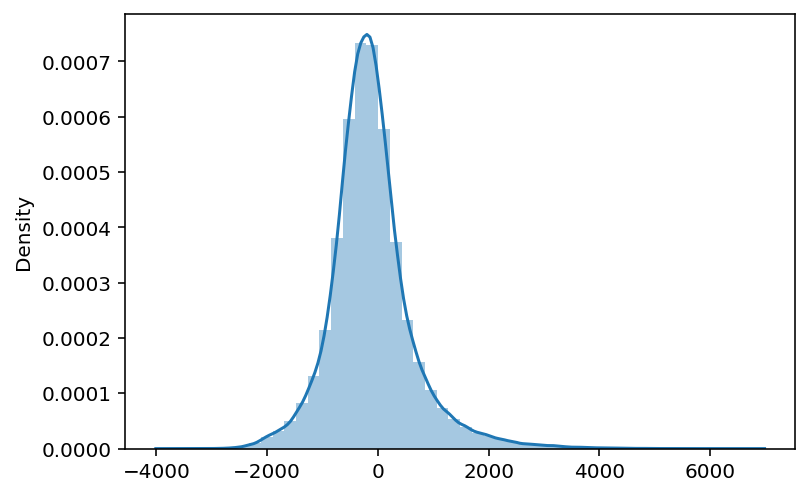

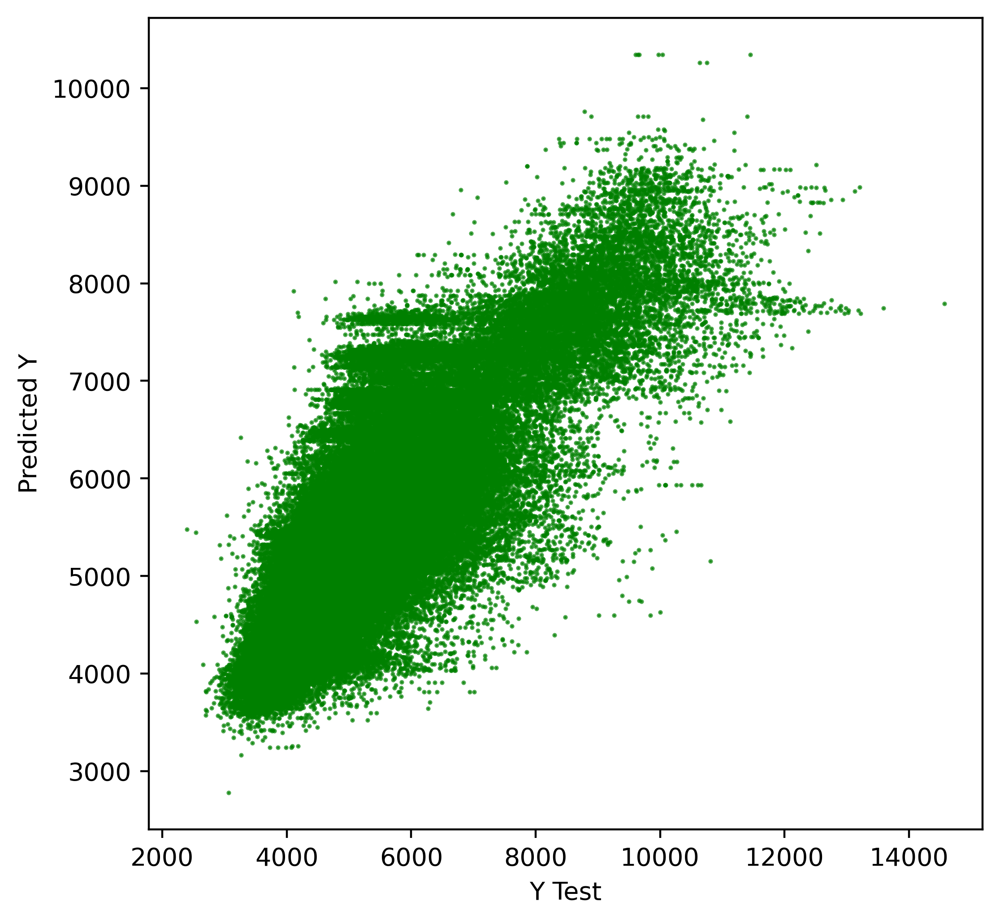


Feature ranking:
1. floor_area_sqm (0.221182)
2. remaining_lease_years (0.194776)
3. lease_commence_date (0.166512)
4. town_Woodlands (0.044226)
5. storey_range_avg (0.042378)
6. town_Bukit Merah (0.040866)
7. town_Bishan (0.039581)
8. town_Jurong West (0.034860)
9. town_Queenstown (0.023397)
10. town_Marine Parade (0.015737)
11. town_Toa Payoh (0.014743)
12. town_Choa Chu Kang (0.012067)
13. town_Yishun (0.011757)
14. town_Kallang/Whampoa (0.011386)
15. town_Bukit Panjang (0.011332)
16. town_Central Area (0.010796)
17. town_Jurong East (0.008464)
18. flat_type_3 Room (0.007492)
19. town_Geylang (0.006084)
20. town_Tampines (0.005408)
21. town_Clementi (0.005305)
22. flat_model_Standard (0.004990)
23. flat_model_Improved (0.004890)
24. town_Bedok (0.004734)
25. town_Bukit Batok (0.004547)
26. town_Ang Mo Kio (0.003643)
27. town_Hougang (0.003610)
28. town_Serangoon (0.003478)
29. flat_model_Terrace (0.003135)
30. storey_range_07 TO 09 (0.003056)
31. storey_range_01 TO 03 (0.002963)
32

datetime.timedelta(seconds=45, microseconds=521909)

In [194]:
a = dt.now()
model_random_forest(df_ml_15)
b = dt.now()
b-a

---
---

Scenario = `see below.`

In [195]:

c2u = \
['flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
    
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
    
 # 'floor_area_sqm',  *** suicide 
 
 'lease_commence_date',   
 
 'n_rooms',

 'price_per_sq_m_norm',

 # 'region_Central',  removing region, which i dont want to do
 # 'region_East',
 # 'region_North',
 # 'region_North-East',
 # 'region_West',
    
 'remaining_lease_years',
 
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
    
 'storey_range_avg',
 # 'storey_range_max',
 # 'storey_range_min',
    
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [196]:
df_ml_16 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 557.5912767587193
Mean Squared Error:..... 600742.00
RMSE: .................. 775.0754795922554
Coeff of det (R^2):..... 0.649
Score .................. 0.6489836619494023

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 257.17947563636005
Mean Squared Error:..... 135972.87
RMSE: .................. 368.7449988374088
Coeff of det (R^2):..... 0.876
Score .................. 0.8762124607489908

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


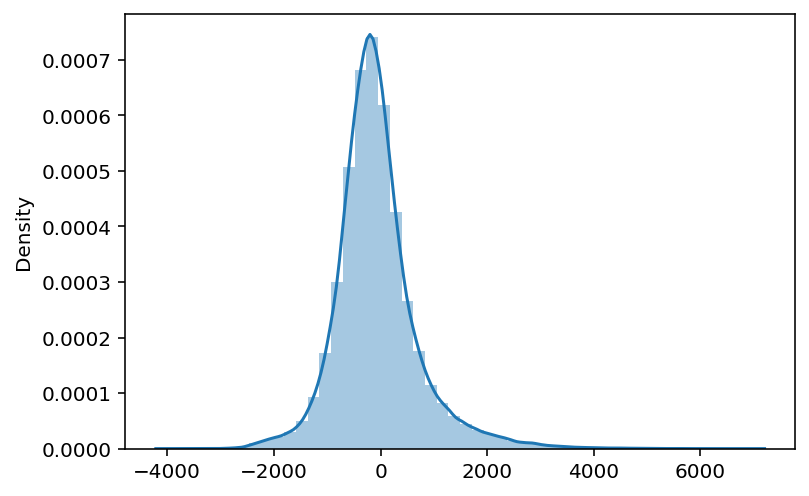

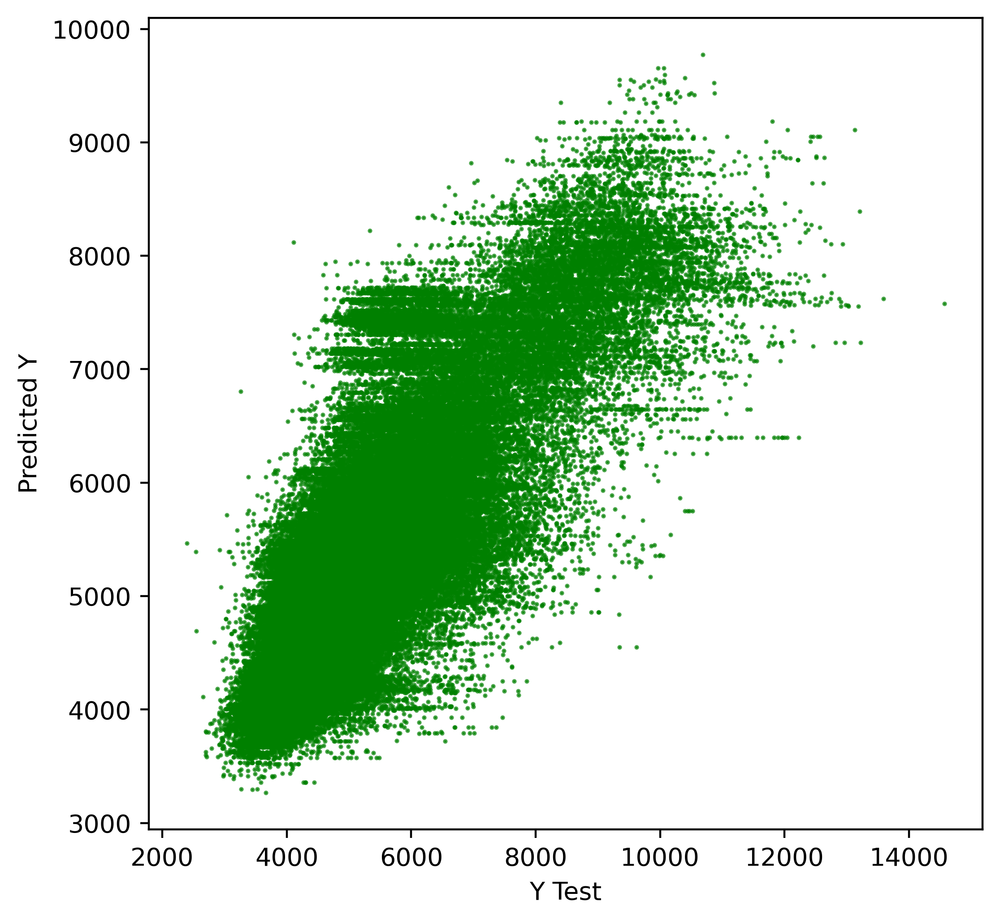


Feature ranking:
1. remaining_lease_years (0.194380)
2. lease_commence_date (0.183705)
3. n_rooms (0.152768)
4. town_Woodlands (0.046547)
5. town_Bukit Merah (0.046084)
6. town_Jurong West (0.041097)
7. storey_range_avg (0.039199)
8. town_Bishan (0.038810)
9. town_Queenstown (0.025996)
10. flat_type_4 Room (0.018463)
11. town_Marine Parade (0.015910)
12. town_Toa Payoh (0.014499)
13. town_Choa Chu Kang (0.014095)
14. town_Bukit Panjang (0.013337)
15. town_Yishun (0.013248)
16. town_Central Area (0.011631)
17. town_Kallang/Whampoa (0.011187)
18. town_Jurong East (0.009945)
19. flat_model_Improved (0.008185)
20. flat_type_5 Room (0.007246)
21. town_Geylang (0.006926)
22. town_Bedok (0.005692)
23. town_Tampines (0.005674)
24. town_Clementi (0.005372)
25. flat_model_Terrace (0.005096)
26. town_Bukit Batok (0.004665)
27. flat_model_Standard (0.004455)
28. town_Ang Mo Kio (0.004182)
29. town_Serangoon (0.003830)
30. town_Hougang (0.003681)
31. flat_model_Model A (0.003635)
32. flat_type_Exe

datetime.timedelta(seconds=37, microseconds=400801)

In [197]:
a = dt.now()
model_random_forest(df_ml_16)
b = dt.now()
b-a

---
---

Scenario = `see below.`

In [198]:

c2u = \
['flat_model_2-Room',
 'flat_model_Adjoined Flat',
 'flat_model_Apartment',
 'flat_model_Dbss',
 'flat_model_Improved',
 'flat_model_Improved-Maisonette',
 'flat_model_Maisonette',
 'flat_model_Model A',
 'flat_model_Model A-Maisonette',
 'flat_model_Model A2',
 'flat_model_Multi Generation',
 'flat_model_New Generation',
 'flat_model_Premium Apartment',
 'flat_model_Premium Apartment Loft',
 'flat_model_Premium Maisonette',
 'flat_model_Simplified',
 'flat_model_Standard',
 'flat_model_Terrace',
 'flat_model_Type S1',
 'flat_model_Type S2',
    
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
    
 'floor_area_sqm',
 
 # 'lease_commence_date',   
 
 # 'n_rooms',

 'price_per_sq_m_norm',

 # 'region_Central',  removing region, which i dont want to do
 # 'region_East',
 # 'region_North',
 # 'region_North-East',
 # 'region_West',
    
 'remaining_lease_years',
 
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
    
 # 'storey_range_avg',
 # 'storey_range_max',
 # 'storey_range_min',
    
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [199]:
df_ml_16 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 626.6888334746226
Mean Squared Error:..... 812986.35
RMSE: .................. 901.6575552812891
Coeff of det (R^2):..... 0.525
Score .................. 0.5249683044440285

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 275.953598568485
Mean Squared Error:..... 155522.06
RMSE: .................. 394.36285245489717
Coeff of det (R^2):..... 0.858
Score .................. 0.8584151938408291

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


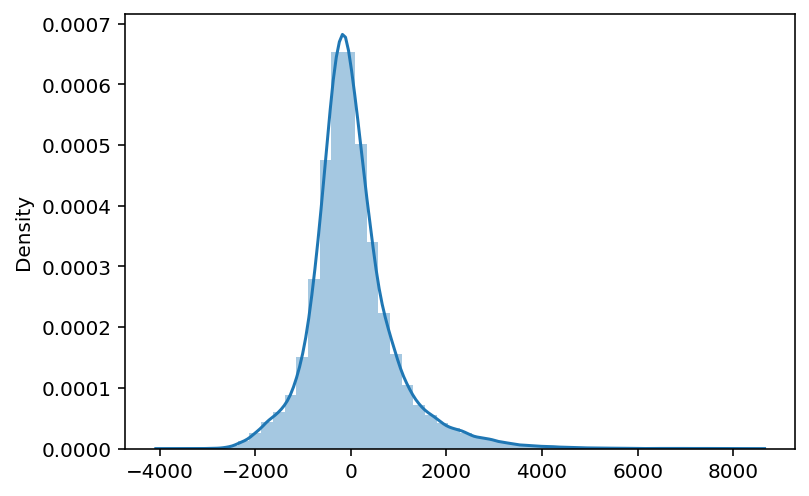

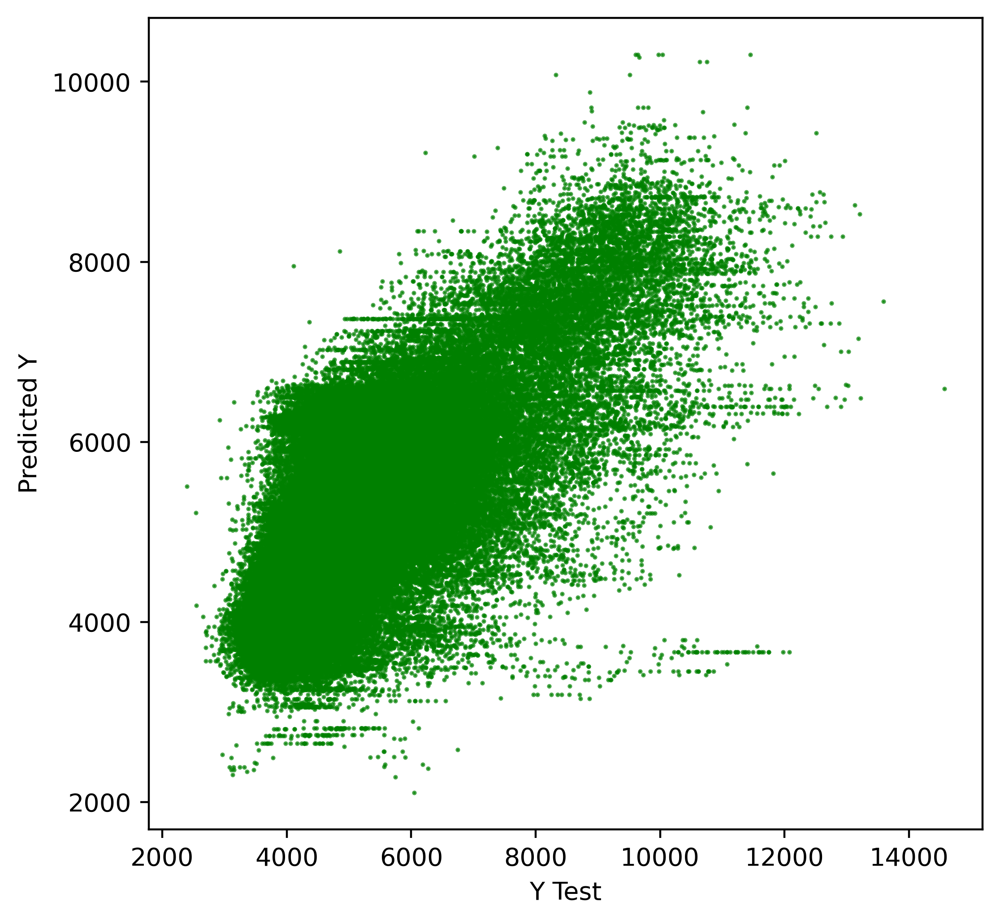


Feature ranking:
1. floor_area_sqm (0.272469)
2. remaining_lease_years (0.211745)
3. town_Woodlands (0.047217)
4. town_Bukit Merah (0.044239)
5. town_Jurong West (0.041203)
6. town_Bishan (0.040545)
7. flat_model_Standard (0.033085)
8. town_Queenstown (0.027032)
9. town_Toa Payoh (0.017106)
10. town_Marine Parade (0.016986)
11. town_Choa Chu Kang (0.016748)
12. town_Central Area (0.015227)
13. town_Kallang/Whampoa (0.013922)
14. flat_model_Improved (0.013676)
15. town_Yishun (0.013417)
16. town_Bukit Panjang (0.012712)
17. storey_range_01 TO 03 (0.011762)
18. town_Clementi (0.010653)
19. town_Geylang (0.008497)
20. town_Jurong East (0.007736)
21. town_Ang Mo Kio (0.007402)
22. storey_range_04 TO 06 (0.007200)
23. flat_model_Model A (0.007188)
24. flat_type_3 Room (0.007019)
25. town_Tampines (0.006739)
26. flat_type_4 Room (0.006494)
27. town_Sembawang (0.005656)
28. town_Sengkang (0.005617)
29. storey_range_07 TO 09 (0.005250)
30. storey_range_10 TO 12 (0.005243)
31. flat_model_New G

datetime.timedelta(seconds=42, microseconds=836515)

In [200]:
a = dt.now()
model_random_forest(df_ml_16)
b = dt.now()
b-a

---
---

Scenario = `removing flat_model`

In [211]:

# c2u = \

# ['flat_model_2-Room',
#  'flat_model_Adjoined Flat',
#  'flat_model_Apartment',
#  'flat_model_Dbss',
#  'flat_model_Improved',
#  'flat_model_Improved-Maisonette',
#  'flat_model_Maisonette',
#  'flat_model_Model A',
#  'flat_model_Model A-Maisonette',
#  'flat_model_Model A2',
#  'flat_model_Multi Generation',
#  'flat_model_New Generation',
#  'flat_model_Premium Apartment',
#  'flat_model_Premium Apartment Loft',
#  'flat_model_Premium Maisonette',
#  'flat_model_Simplified',
#  'flat_model_Standard',
#  'flat_model_Terrace',
#  'flat_model_Type S1',
#  'flat_model_Type S2',
    
c2u = ['flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
    
 'floor_area_sqm',
 
 'lease_commence_date',   
 
 'n_rooms',

 'price_per_sq_m_norm',

 # 'region_Central',  removing region, which i dont want to do
 # 'region_East',
 # 'region_North',
 # 'region_North-East',
 # 'region_West',
    
 'remaining_lease_years',
 
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
    
 'storey_range_avg',
 # 'storey_range_max',
 # 'storey_range_min',
    
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [212]:
df_ml_17 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 560.2321452679964
Mean Squared Error:..... 603451.69
RMSE: .................. 776.8215287674378
Coeff of det (R^2):..... 0.647
Score .................. 0.6474003783884156

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 213.25053841256744
Mean Squared Error:..... 97776.52
RMSE: .................. 312.6923755600921
Coeff of det (R^2):..... 0.911
Score .................. 0.910985811721658

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


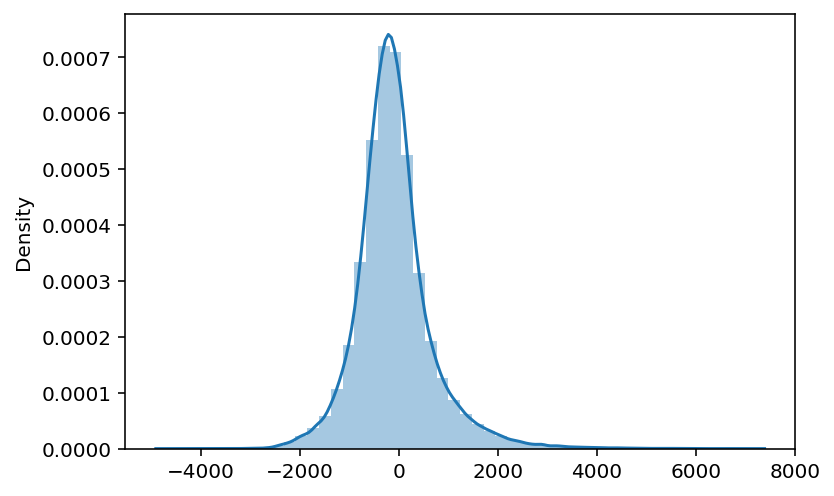

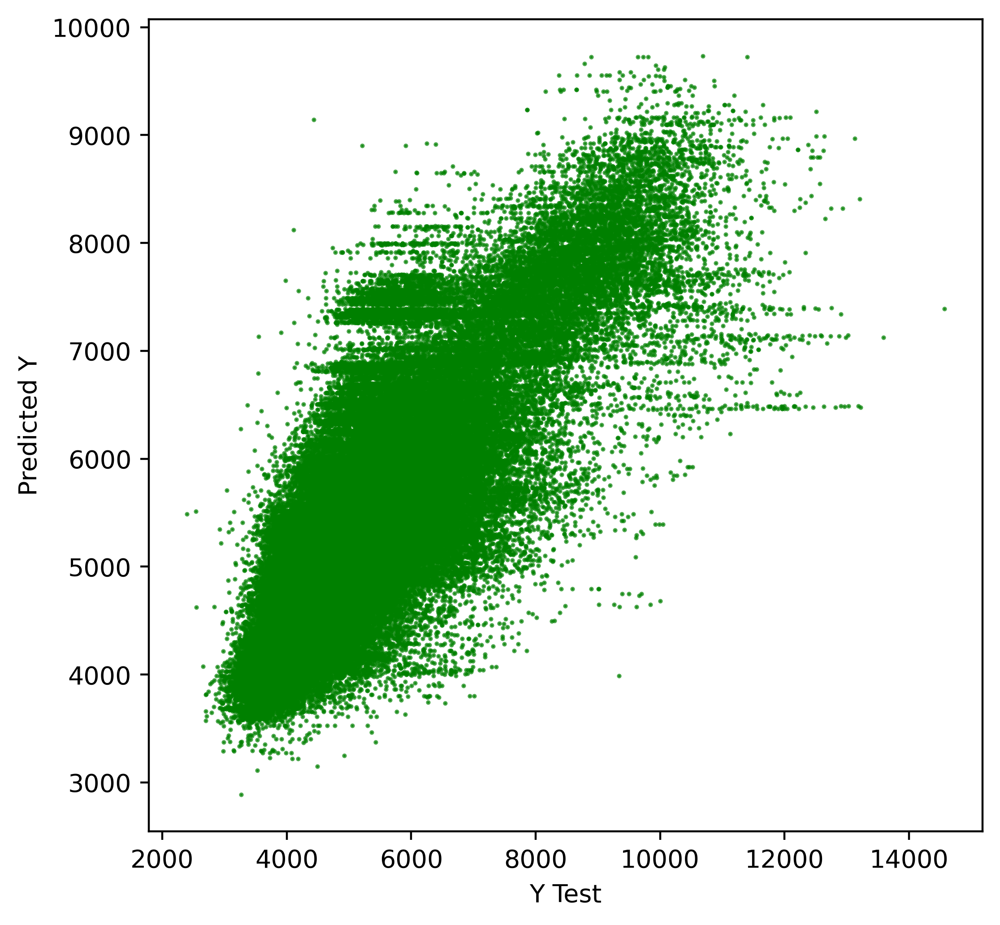


Feature ranking:
1. remaining_lease_years (0.189485)
2. lease_commence_date (0.177933)
3. n_rooms (0.147083)
4. floor_area_sqm (0.066237)
5. town_Woodlands (0.044652)
6. town_Bukit Merah (0.043640)
7. town_Jurong West (0.039181)
8. storey_range_avg (0.038360)
9. town_Bishan (0.037085)
10. town_Queenstown (0.024913)
11. flat_type_4 Room (0.015468)
12. town_Marine Parade (0.015242)
13. town_Toa Payoh (0.014539)
14. town_Choa Chu Kang (0.013485)
15. town_Bukit Panjang (0.012826)
16. town_Yishun (0.012733)
17. town_Kallang/Whampoa (0.011099)
18. town_Central Area (0.011053)
19. town_Jurong East (0.009249)
20. town_Geylang (0.007139)
21. flat_type_5 Room (0.006298)
22. town_Tampines (0.005679)
23. town_Bedok (0.005380)
24. town_Clementi (0.005271)
25. town_Ang Mo Kio (0.004390)
26. town_Bukit Batok (0.004378)
27. town_Serangoon (0.003604)
28. town_Hougang (0.003575)
29. storey_range_01 TO 03 (0.003248)
30. storey_range_07 TO 09 (0.003005)
31. flat_type_3 Room (0.002855)
32. town_Bukit Tima

datetime.timedelta(seconds=34, microseconds=375122)

In [213]:
a = dt.now()
model_random_forest(df_ml_17)
b = dt.now()
b-a

> Fully removing flat_model category didn't seem to dip things down much ???

---
---

Scenario = `removing flat_model`

In [214]:

# c2u = \

# ['flat_model_2-Room',
#  'flat_model_Adjoined Flat',
#  'flat_model_Apartment',
#  'flat_model_Dbss',
#  'flat_model_Improved',
#  'flat_model_Improved-Maisonette',
#  'flat_model_Maisonette',
#  'flat_model_Model A',
#  'flat_model_Model A-Maisonette',
#  'flat_model_Model A2',
#  'flat_model_Multi Generation',
#  'flat_model_New Generation',
#  'flat_model_Premium Apartment',
#  'flat_model_Premium Apartment Loft',
#  'flat_model_Premium Maisonette',
#  'flat_model_Simplified',
#  'flat_model_Standard',
#  'flat_model_Terrace',
#  'flat_model_Type S1',
#  'flat_model_Type S2',
    
c2u = ['flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',
    
 'floor_area_sqm',
 
 'lease_commence_date',   
 
 # 'n_rooms',   *********

 'price_per_sq_m_norm',

 # 'region_Central',  removing region, which i dont want to do
 # 'region_East',
 # 'region_North',
 # 'region_North-East',
 # 'region_West',
    
 'remaining_lease_years',
 
 'storey_range_01 TO 03',
 'storey_range_01 TO 05',
 'storey_range_04 TO 06',
 'storey_range_06 TO 10',
 'storey_range_07 TO 09',
 'storey_range_10 TO 12',
 'storey_range_11 TO 15',
 'storey_range_13 TO 15',
 'storey_range_16 TO 18',
 'storey_range_16 TO 20',
 'storey_range_19 TO 21',
 'storey_range_21 TO 25',
 'storey_range_22 TO 24',
 'storey_range_25 TO 27',
 'storey_range_26 TO 30',
 'storey_range_28 TO 30',
 'storey_range_31 TO 33',
 'storey_range_31 TO 35',
 'storey_range_34 TO 36',
 'storey_range_36 TO 40',
 'storey_range_37 TO 39',
 'storey_range_40 TO 42',
 'storey_range_43 TO 45',
 'storey_range_46 TO 48',
 'storey_range_49 TO 51',
    
 # 'storey_range_avg',
 # 'storey_range_max',
 # 'storey_range_min',
    
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [215]:
df_ml_18 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 548.9470068102682
Mean Squared Error:..... 583271.54
RMSE: .................. 763.7221640594043
Coeff of det (R^2):..... 0.659
Score .................. 0.6591917299956985

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 213.37069241969462
Mean Squared Error:..... 97839.42
RMSE: .................. 312.7929371538536
Coeff of det (R^2):..... 0.911
Score .................. 0.9109285487455001

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


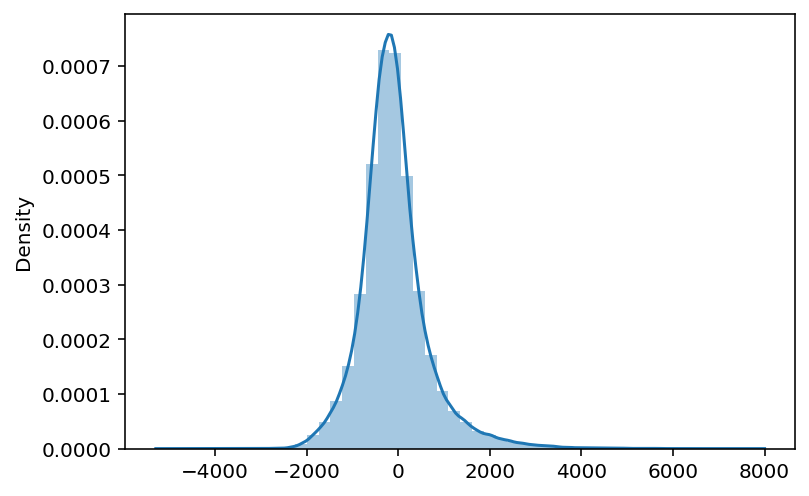

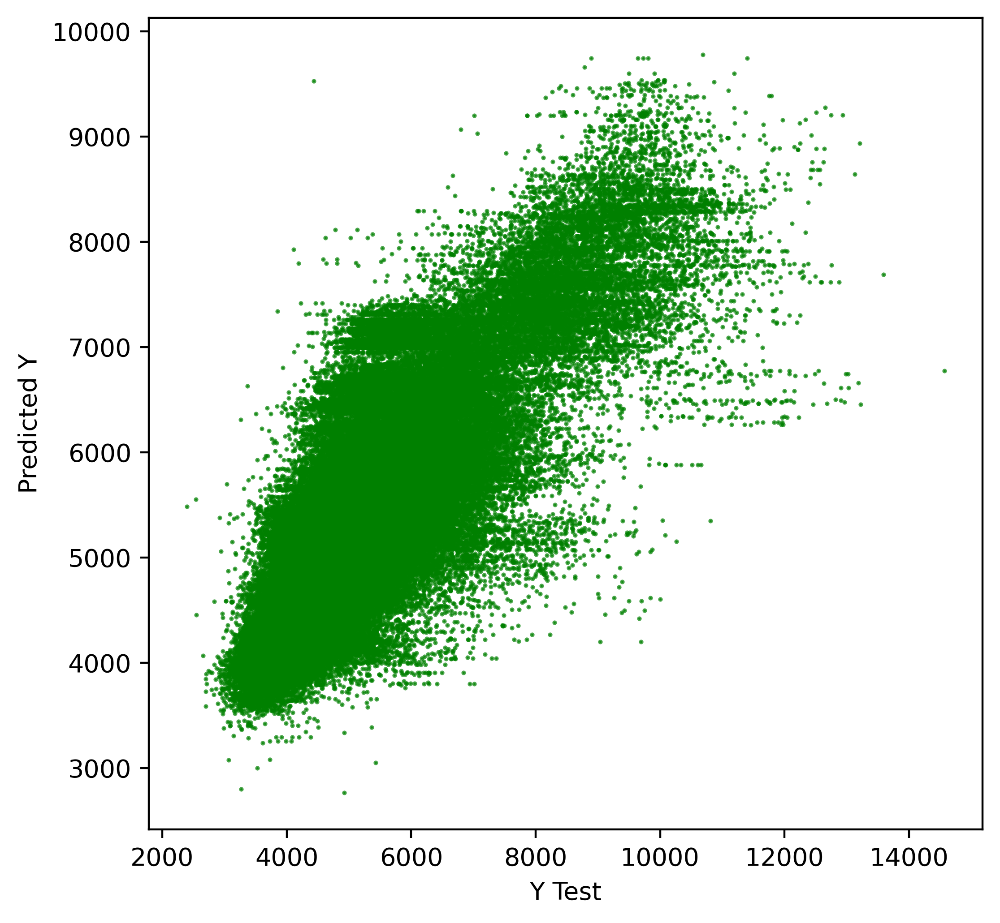


Feature ranking:
1. floor_area_sqm (0.230397)
2. remaining_lease_years (0.196258)
3. lease_commence_date (0.181239)
4. town_Woodlands (0.045457)
5. town_Bukit Merah (0.041395)
6. town_Bishan (0.040005)
7. town_Jurong West (0.035461)
8. town_Queenstown (0.026377)
9. town_Toa Payoh (0.017077)
10. town_Marine Parade (0.016108)
11. town_Central Area (0.013198)
12. town_Yishun (0.013135)
13. town_Kallang/Whampoa (0.012924)
14. storey_range_01 TO 03 (0.011494)
15. town_Choa Chu Kang (0.011478)
16. town_Bukit Panjang (0.009591)
17. town_Clementi (0.008115)
18. town_Jurong East (0.007560)
19. storey_range_04 TO 06 (0.006979)
20. town_Geylang (0.006931)
21. flat_type_3 Room (0.006314)
22. town_Ang Mo Kio (0.006023)
23. town_Tampines (0.005382)
24. storey_range_07 TO 09 (0.005164)
25. storey_range_10 TO 12 (0.005099)
26. town_Bedok (0.004315)
27. flat_type_4 Room (0.004044)
28. town_Bukit Batok (0.003881)
29. town_Hougang (0.003482)
30. town_Serangoon (0.003342)
31. storey_range_13 TO 15 (0.003

datetime.timedelta(seconds=38, microseconds=697769)

In [216]:
a = dt.now()
model_random_forest(df_ml_18)
b = dt.now()
b-a

---
---

# **  ?  **

Scenario = `see below.`

In [220]:
# ['flat_model_2-Room',
#  'flat_model_Adjoined Flat',
#  'flat_model_Apartment',
#  'flat_model_Dbss',
#  'flat_model_Improved',
#  'flat_model_Improved-Maisonette',
#  'flat_model_Maisonette',
#  'flat_model_Model A',
#  'flat_model_Model A-Maisonette',
#  'flat_model_Model A2',
#  'flat_model_Multi Generation',
#  'flat_model_New Generation',
#  'flat_model_Premium Apartment',
#  'flat_model_Premium Apartment Loft',
#  'flat_model_Premium Maisonette',
#  'flat_model_Simplified',
#  'flat_model_Standard',
#  'flat_model_Terrace',
#  'flat_model_Type S1',
#  'flat_model_Type S2',


c2u = ['flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',

 'floor_area_sqm',
 
 'lease_commence_date',   
 
 'n_rooms',   
 
 'price_per_sq_m_norm',

 'region_Central',  
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
    
 'remaining_lease_years',
 
#  'storey_range_01 TO 03',  #  what the heck... 
#  'storey_range_01 TO 05',  #  multiple overlaps... meaningless ? 
#  'storey_range_04 TO 06',
#  'storey_range_06 TO 10',
#  'storey_range_07 TO 09',  # overlaps...
#  'storey_range_10 TO 12',
#  'storey_range_11 TO 15',
#  'storey_range_13 TO 15',
#  'storey_range_16 TO 18',
#  'storey_range_16 TO 20',
#  'storey_range_19 TO 21',
#  'storey_range_21 TO 25',
#  'storey_range_22 TO 24',
#  'storey_range_25 TO 27',
#  'storey_range_26 TO 30',
#  'storey_range_28 TO 30',
#  'storey_range_31 TO 33',
#  'storey_range_31 TO 35',
#  'storey_range_34 TO 36',
#  'storey_range_36 TO 40',
#  'storey_range_37 TO 39',
#  'storey_range_40 TO 42',
#  'storey_range_43 TO 45',
#  'storey_range_46 TO 48',
#  'storey_range_49 TO 51',
    
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
       
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [221]:
df_ml_20 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 516.3124232563853
Mean Squared Error:..... 509796.73
RMSE: .................. 714.0005098741532
Coeff of det (R^2):..... 0.702
Score .................. 0.7021234058439445

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 213.16281174194566
Mean Squared Error:..... 97725.55
RMSE: .................. 312.6108545992715
Coeff of det (R^2):..... 0.911
Score .................. 0.9110322188413109

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


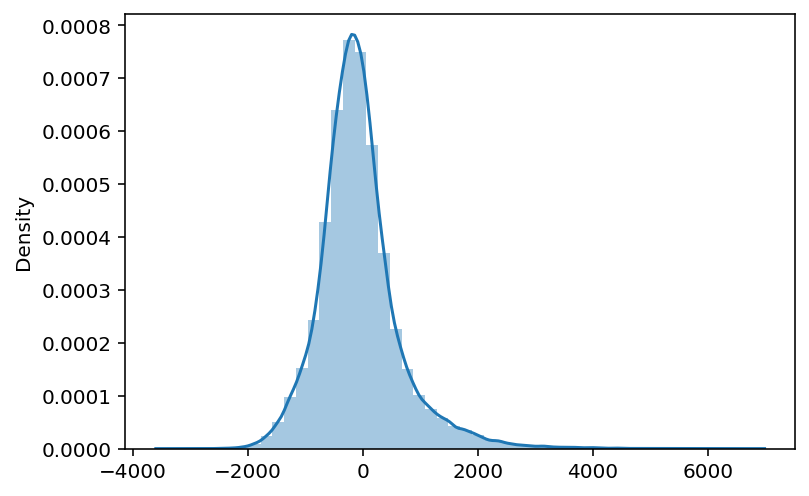

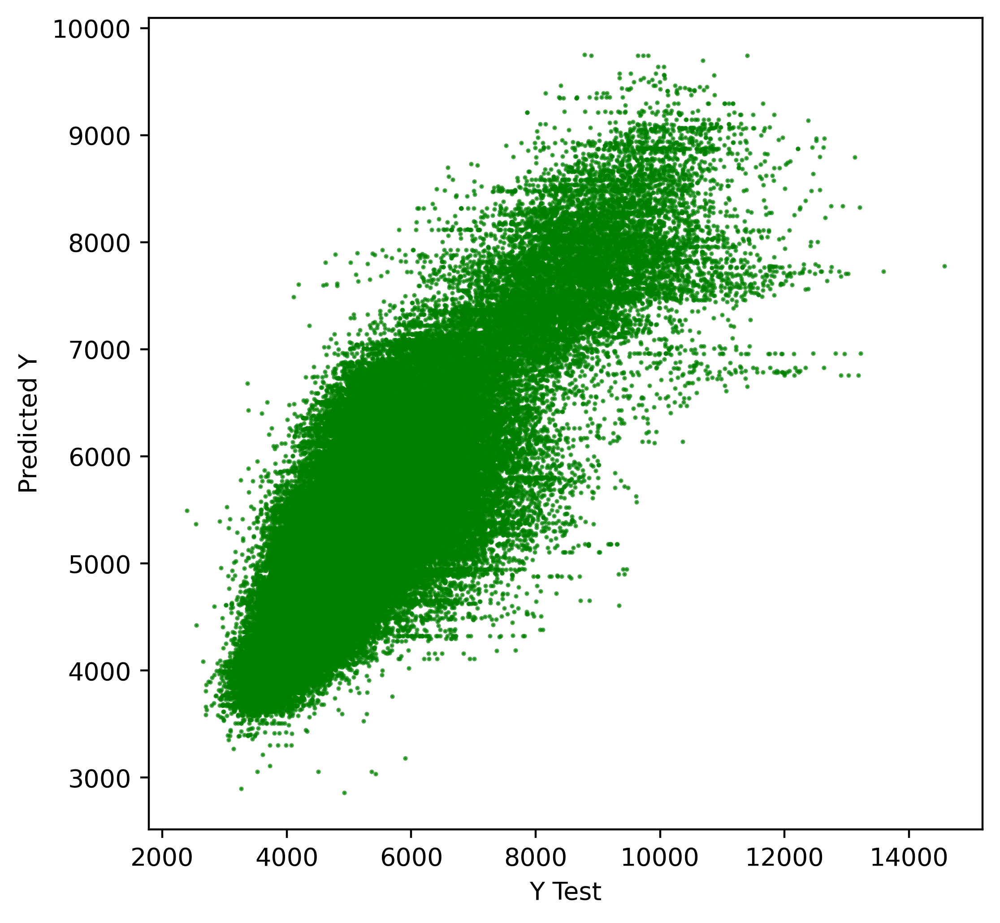


Feature ranking:
1. remaining_lease_years (0.195030)
2. lease_commence_date (0.185220)
3. n_rooms (0.172339)
4. region_Central (0.128133)
5. floor_area_sqm (0.063510)
6. flat_type_4 Room (0.034363)
7. region_West (0.021777)
8. region_North (0.021554)
9. town_Woodlands (0.014890)
10. town_Clementi (0.014760)
11. storey_range_min (0.014232)
12. storey_range_avg (0.013952)
13. storey_range_max (0.012118)
14. flat_type_5 Room (0.010896)
15. town_Jurong West (0.008617)
16. town_Marine Parade (0.007736)
17. town_Geylang (0.007709)
18. town_Tampines (0.006760)
19. town_Ang Mo Kio (0.006057)
20. town_Central Area (0.005394)
21. town_Jurong East (0.004644)
22. town_Toa Payoh (0.004603)
23. town_Bukit Batok (0.004503)
24. town_Bukit Merah (0.004239)
25. town_Queenstown (0.004205)
26. flat_type_3 Room (0.003293)
27. town_Serangoon (0.003230)
28. region_East (0.003066)
29. town_Kallang/Whampoa (0.002952)
30. town_Choa Chu Kang (0.002893)
31. town_Hougang (0.002608)
32. town_Bedok (0.002437)
33. t

datetime.timedelta(seconds=24, microseconds=595752)

In [222]:
a = dt.now()
model_random_forest(df_ml_20)
b = dt.now()
b-a

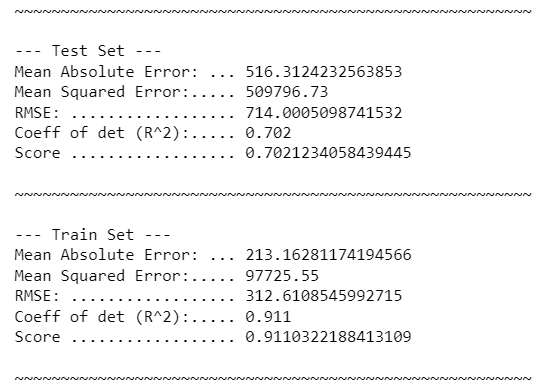

---
---

# what the 

Scenario = `see below.`

In [226]:

# ['flat_model_2-Room',
#  'flat_model_Adjoined Flat',
#  'flat_model_Apartment',
#  'flat_model_Dbss',
#  'flat_model_Improved',
#  'flat_model_Improved-Maisonette',
#  'flat_model_Maisonette',
#  'flat_model_Model A',
#  'flat_model_Model A-Maisonette',
#  'flat_model_Model A2',
#  'flat_model_Multi Generation',
#  'flat_model_New Generation',
#  'flat_model_Premium Apartment',
#  'flat_model_Premium Apartment Loft',
#  'flat_model_Premium Maisonette',
#  'flat_model_Simplified',
#  'flat_model_Standard',
#  'flat_model_Terrace',
#  'flat_model_Type S1',
#  'flat_model_Type S2',

c2u = ['flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',

 'floor_area_sqm',
 
 'lease_commence_date',   
 
 # 'n_rooms',     ****
 
 'price_per_sq_m_norm',

 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
    
 'remaining_lease_years',
 
#  'storey_range_01 TO 03',  #  what the heck... 
#  'storey_range_01 TO 05',  #  multiple overlaps... meaningless ? 
#  'storey_range_04 TO 06',
#  'storey_range_06 TO 10',
#  'storey_range_07 TO 09',  # overlaps...
#  'storey_range_10 TO 12',
#  'storey_range_11 TO 15',
#  'storey_range_13 TO 15',
#  'storey_range_16 TO 18',
#  'storey_range_16 TO 20',
#  'storey_range_19 TO 21',
#  'storey_range_21 TO 25',
#  'storey_range_22 TO 24',
#  'storey_range_25 TO 27',
#  'storey_range_26 TO 30',
#  'storey_range_28 TO 30',
#  'storey_range_31 TO 33',
#  'storey_range_31 TO 35',
#  'storey_range_34 TO 36',
#  'storey_range_36 TO 40',
#  'storey_range_37 TO 39',
#  'storey_range_40 TO 42',
#  'storey_range_43 TO 45',
#  'storey_range_46 TO 48',
#  'storey_range_49 TO 51',
    
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
       
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [227]:
df_ml_21 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 500.85656716653773
Mean Squared Error:..... 470684.62
RMSE: .................. 686.0645919780445
Coeff of det (R^2):..... 0.725
Score .................. 0.7249767895722689

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 213.23107132659317
Mean Squared Error:..... 97812.53
RMSE: .................. 312.74994847365167
Coeff of det (R^2):..... 0.911
Score .................. 0.9109530301231445

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


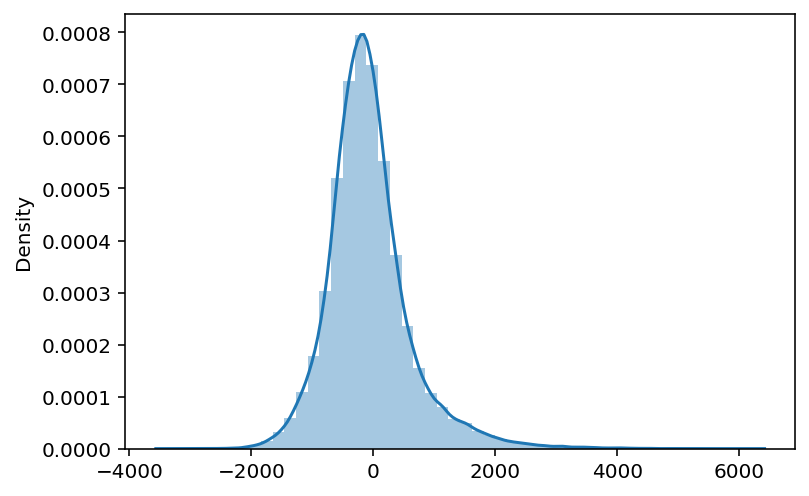

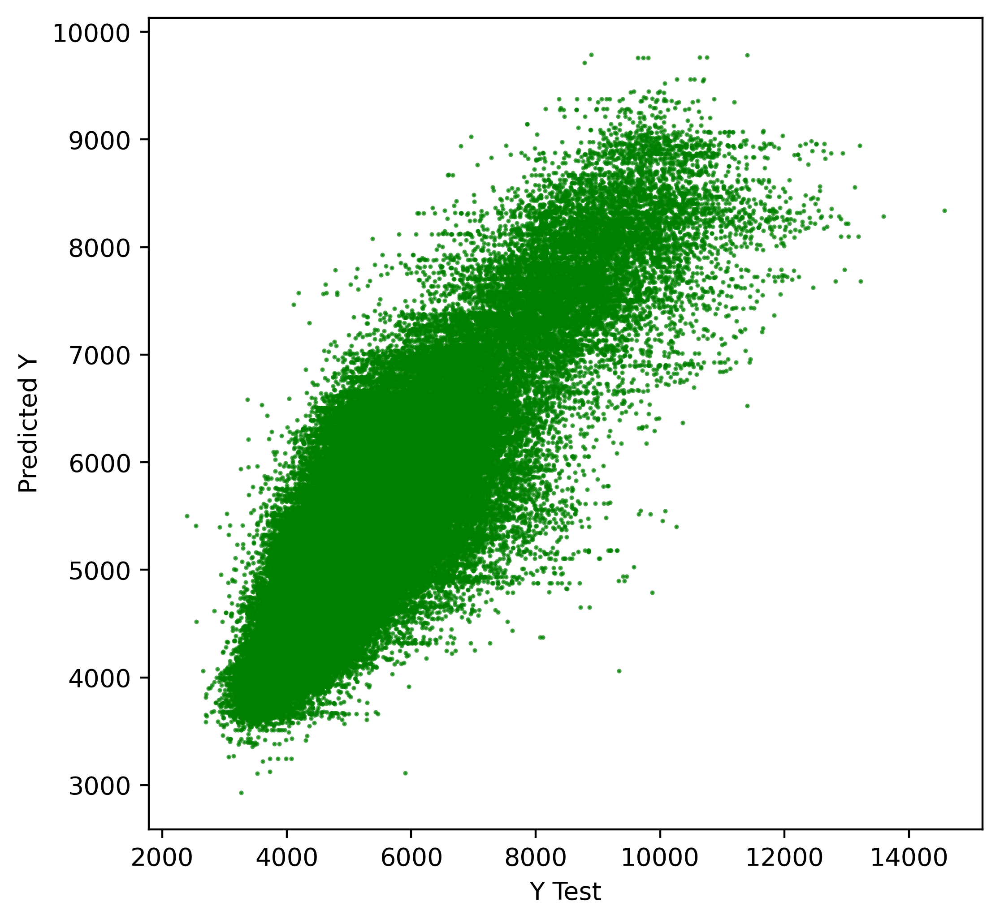


Feature ranking:
1. floor_area_sqm (0.259205)
2. remaining_lease_years (0.199487)
3. lease_commence_date (0.180629)
4. region_Central (0.118138)
5. flat_type_3 Room (0.028321)
6. region_North (0.022795)
7. region_West (0.022111)
8. storey_range_min (0.014963)
9. storey_range_avg (0.014306)
10. town_Clementi (0.013771)
11. storey_range_max (0.012351)
12. town_Woodlands (0.011647)
13. region_East (0.008783)
14. town_Geylang (0.007853)
15. town_Marine Parade (0.007121)
16. town_Tampines (0.006221)
17. town_Jurong West (0.005680)
18. town_Ang Mo Kio (0.004947)
19. town_Toa Payoh (0.004943)
20. town_Bukit Merah (0.004943)
21. town_Bukit Batok (0.004650)
22. town_Central Area (0.004494)
23. town_Jurong East (0.004290)
24. flat_type_4 Room (0.004128)
25. town_Kallang/Whampoa (0.003651)
26. town_Queenstown (0.003615)
27. town_Serangoon (0.003444)
28. town_Choa Chu Kang (0.002688)
29. flat_type_Executive (0.002601)
30. town_Hougang (0.002582)
31. town_Bedok (0.002493)
32. region_North-East (0.

datetime.timedelta(seconds=33, microseconds=731493)

In [228]:
a = dt.now()
model_random_forest(df_ml_21)
b = dt.now()
b-a

# review 

Scenario = `see below.`

In [226]:

# ['flat_model_2-Room',
#  'flat_model_Adjoined Flat',
#  'flat_model_Apartment',
#  'flat_model_Dbss',
#  'flat_model_Improved',
#  'flat_model_Improved-Maisonette',
#  'flat_model_Maisonette',
#  'flat_model_Model A',
#  'flat_model_Model A-Maisonette',
#  'flat_model_Model A2',
#  'flat_model_Multi Generation',
#  'flat_model_New Generation',
#  'flat_model_Premium Apartment',
#  'flat_model_Premium Apartment Loft',
#  'flat_model_Premium Maisonette',
#  'flat_model_Simplified',
#  'flat_model_Standard',
#  'flat_model_Terrace',
#  'flat_model_Type S1',
#  'flat_model_Type S2',


c2u = ['flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',

 'floor_area_sqm',
 
 'lease_commence_date',   
 
 # 'n_rooms',     ****
 
 'price_per_sq_m_norm',

 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
    
 'remaining_lease_years',
 
#  'storey_range_01 TO 03',  #  what the heck... 
#  'storey_range_01 TO 05',  #  multiple overlaps... meaningless ? 
#  'storey_range_04 TO 06',
#  'storey_range_06 TO 10',
#  'storey_range_07 TO 09',  # overlaps...
#  'storey_range_10 TO 12',
#  'storey_range_11 TO 15',
#  'storey_range_13 TO 15',
#  'storey_range_16 TO 18',
#  'storey_range_16 TO 20',
#  'storey_range_19 TO 21',
#  'storey_range_21 TO 25',
#  'storey_range_22 TO 24',
#  'storey_range_25 TO 27',
#  'storey_range_26 TO 30',
#  'storey_range_28 TO 30',
#  'storey_range_31 TO 33',
#  'storey_range_31 TO 35',
#  'storey_range_34 TO 36',
#  'storey_range_36 TO 40',
#  'storey_range_37 TO 39',
#  'storey_range_40 TO 42',
#  'storey_range_43 TO 45',
#  'storey_range_46 TO 48',
#  'storey_range_49 TO 51',
    
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
       
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [227]:
df_ml_22 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 500.85656716653773
Mean Squared Error:..... 470684.62
RMSE: .................. 686.0645919780445
Coeff of det (R^2):..... 0.725
Score .................. 0.7249767895722689

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 213.23107132659317
Mean Squared Error:..... 97812.53
RMSE: .................. 312.74994847365167
Coeff of det (R^2):..... 0.911
Score .................. 0.9109530301231445

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


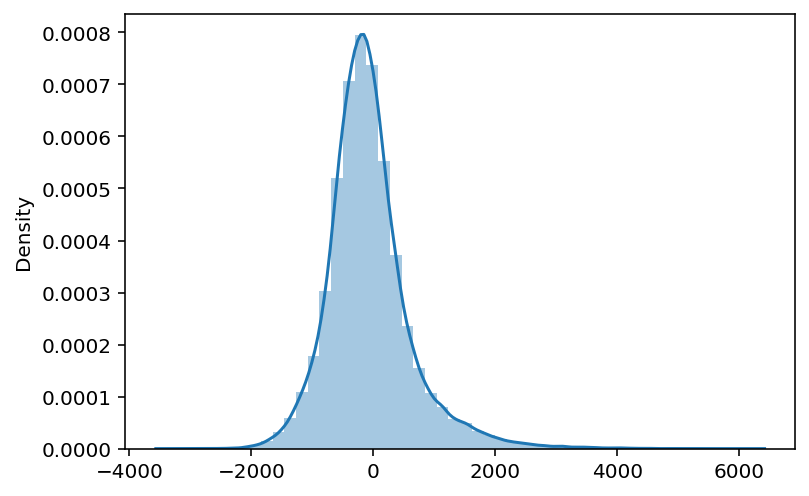

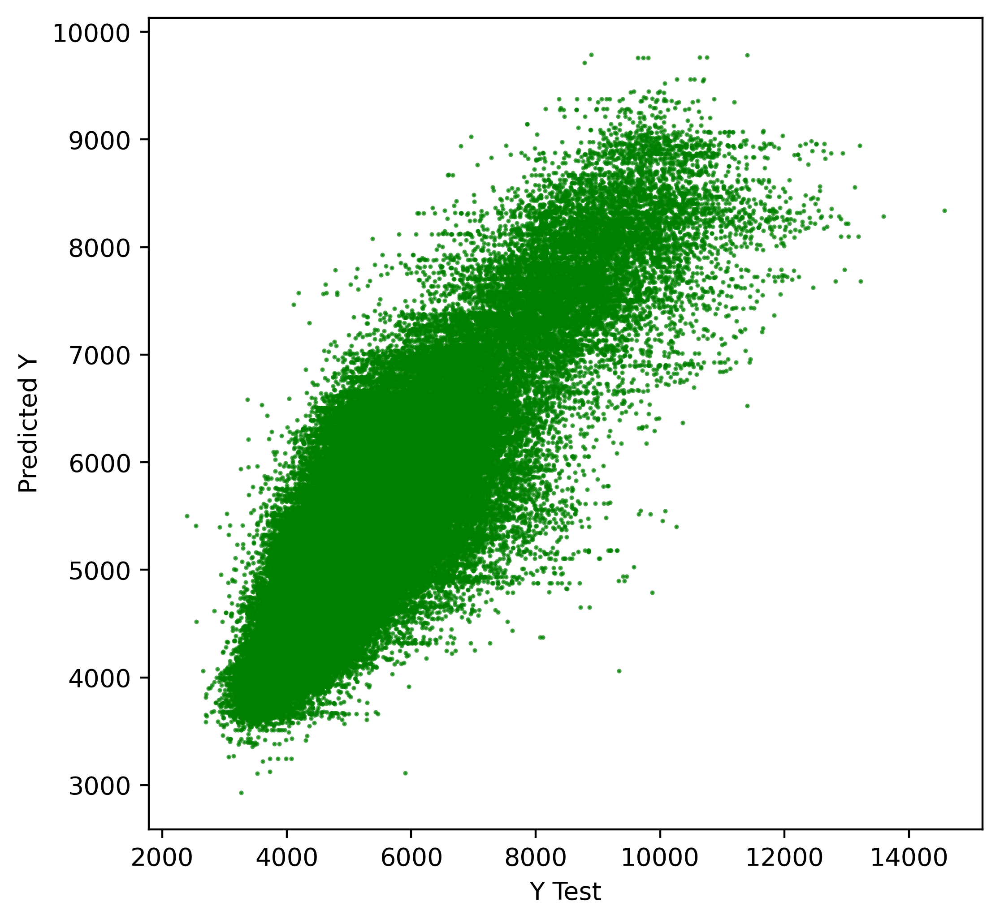


Feature ranking:
1. floor_area_sqm (0.259205)
2. remaining_lease_years (0.199487)
3. lease_commence_date (0.180629)
4. region_Central (0.118138)
5. flat_type_3 Room (0.028321)
6. region_North (0.022795)
7. region_West (0.022111)
8. storey_range_min (0.014963)
9. storey_range_avg (0.014306)
10. town_Clementi (0.013771)
11. storey_range_max (0.012351)
12. town_Woodlands (0.011647)
13. region_East (0.008783)
14. town_Geylang (0.007853)
15. town_Marine Parade (0.007121)
16. town_Tampines (0.006221)
17. town_Jurong West (0.005680)
18. town_Ang Mo Kio (0.004947)
19. town_Toa Payoh (0.004943)
20. town_Bukit Merah (0.004943)
21. town_Bukit Batok (0.004650)
22. town_Central Area (0.004494)
23. town_Jurong East (0.004290)
24. flat_type_4 Room (0.004128)
25. town_Kallang/Whampoa (0.003651)
26. town_Queenstown (0.003615)
27. town_Serangoon (0.003444)
28. town_Choa Chu Kang (0.002688)
29. flat_type_Executive (0.002601)
30. town_Hougang (0.002582)
31. town_Bedok (0.002493)
32. region_North-East (0.

datetime.timedelta(seconds=33, microseconds=731493)

In [228]:
a = dt.now()
model_random_forest(df_ml_22)
b = dt.now()
b-a

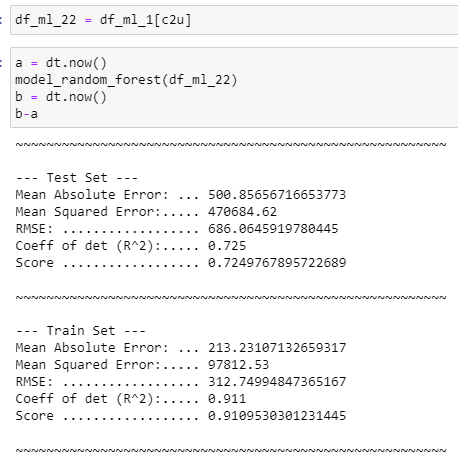

<br><br>

# review more

Scenario = `see below.`

In [235]:

# ['flat_model_2-Room',
#  'flat_model_Adjoined Flat',
#  'flat_model_Apartment',
#  'flat_model_Dbss',
#  'flat_model_Improved',
#  'flat_model_Improved-Maisonette',
#  'flat_model_Maisonette',
#  'flat_model_Model A',
#  'flat_model_Model A-Maisonette',
#  'flat_model_Model A2',
#  'flat_model_Multi Generation',
#  'flat_model_New Generation',
#  'flat_model_Premium Apartment',
#  'flat_model_Premium Apartment Loft',
#  'flat_model_Premium Maisonette',
#  'flat_model_Simplified',
#  'flat_model_Standard',
#  'flat_model_Terrace',
#  'flat_model_Type S1',
#  'flat_model_Type S2',


c2u = ['flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',

 'floor_area_sqm',
 
 'lease_commence_date',   
 
 # 'n_rooms',     ****
 
 'price_per_sq_m_norm',

 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
    
 'remaining_lease_years',
 
#  'storey_range_01 TO 03',  #  what the heck... 
#  'storey_range_01 TO 05',  #  multiple overlaps... meaningless ? 
#  'storey_range_04 TO 06',
#  'storey_range_06 TO 10',
#  'storey_range_07 TO 09',  # overlaps...
#  'storey_range_10 TO 12',
#  'storey_range_11 TO 15',
#  'storey_range_13 TO 15',
#  'storey_range_16 TO 18',
#  'storey_range_16 TO 20',
#  'storey_range_19 TO 21',
#  'storey_range_21 TO 25',
#  'storey_range_22 TO 24',
#  'storey_range_25 TO 27',
#  'storey_range_26 TO 30',
#  'storey_range_28 TO 30',
#  'storey_range_31 TO 33',
#  'storey_range_31 TO 35',
#  'storey_range_34 TO 36',
#  'storey_range_36 TO 40',
#  'storey_range_37 TO 39',
#  'storey_range_40 TO 42',
#  'storey_range_43 TO 45',
#  'storey_range_46 TO 48',
#  'storey_range_49 TO 51',
    
 'storey_range_avg',
 # 'storey_range_max',
 'storey_range_min',
       
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [236]:
df_ml_23 = df_ml_1[c2u]

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 500.8965854762323
Mean Squared Error:..... 470708.81
RMSE: .................. 686.0822154270339
Coeff of det (R^2):..... 0.725
Score .................. 0.724962659941243

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 213.21748935088624
Mean Squared Error:..... 97801.49
RMSE: .................. 312.732299824962
Coeff of det (R^2):..... 0.911
Score .................. 0.9109630797768948

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


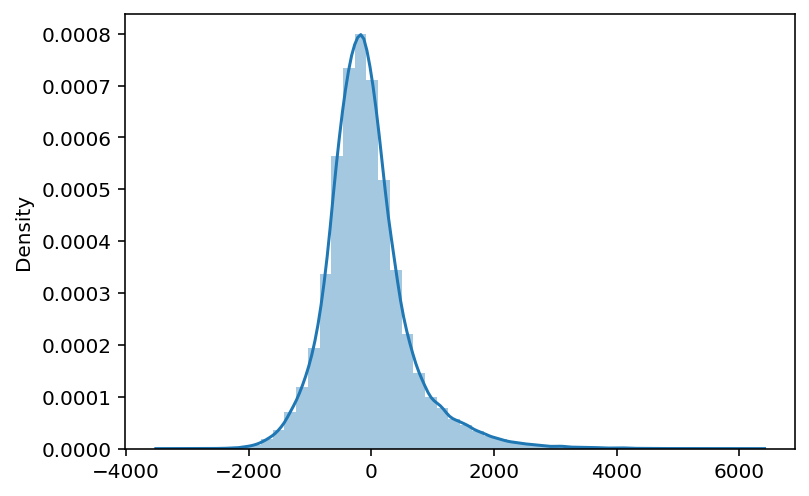

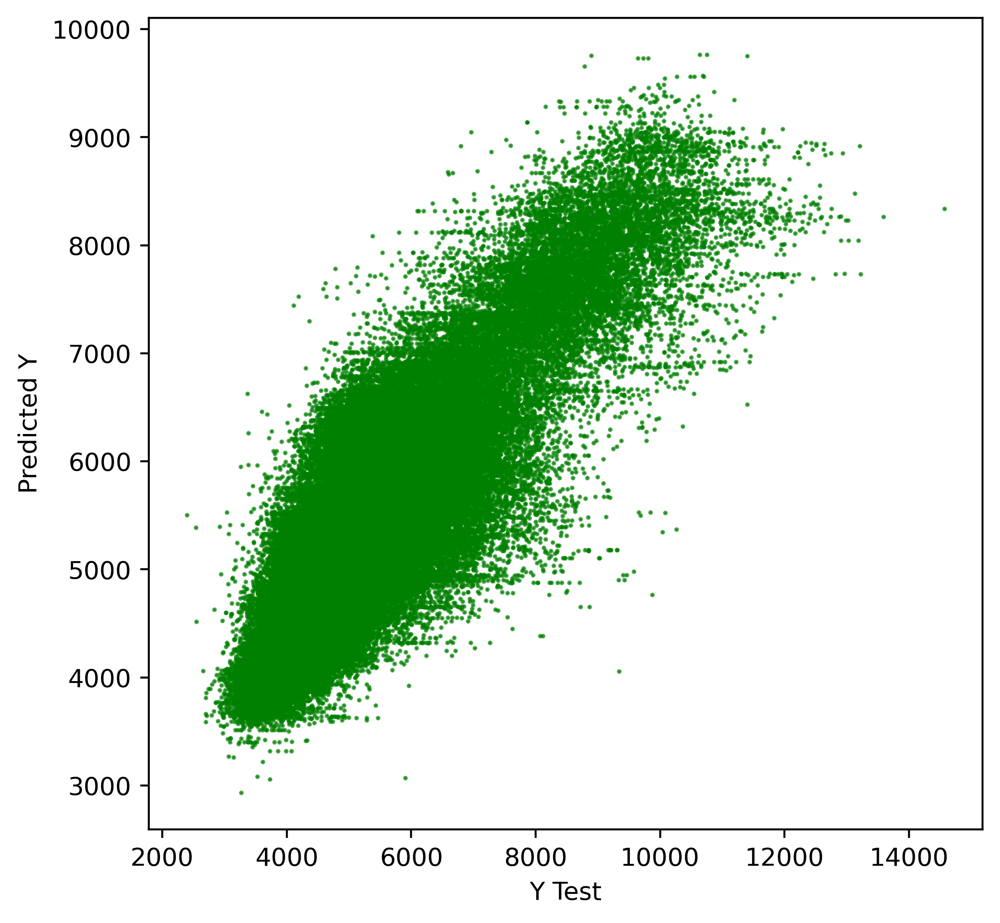


Feature ranking:
1. floor_area_sqm (0.259202)
2. remaining_lease_years (0.199537)
3. lease_commence_date (0.180680)
4. region_Central (0.118138)
5. flat_type_3 Room (0.028451)
6. region_North (0.022987)
7. region_West (0.022095)
8. storey_range_avg (0.020749)
9. storey_range_min (0.020736)
10. town_Clementi (0.013774)
11. town_Woodlands (0.011473)
12. region_East (0.008736)
13. town_Geylang (0.007856)
14. town_Marine Parade (0.007122)
15. town_Tampines (0.006226)
16. town_Jurong West (0.005707)
17. town_Toa Payoh (0.004942)
18. town_Ang Mo Kio (0.004932)
19. town_Bukit Merah (0.004925)
20. town_Bukit Batok (0.004647)
21. town_Central Area (0.004492)
22. town_Jurong East (0.004291)
23. flat_type_4 Room (0.004046)
24. town_Kallang/Whampoa (0.003649)
25. town_Queenstown (0.003612)
26. town_Serangoon (0.003454)
27. town_Choa Chu Kang (0.002697)
28. flat_type_Executive (0.002626)
29. town_Hougang (0.002581)
30. town_Bedok (0.002537)
31. region_North-East (0.002306)
32. town_Pasir Ris (0.00

datetime.timedelta(seconds=26, microseconds=64595)

In [237]:
a = dt.now()
model_random_forest(df_ml_23)
b = dt.now()
b-a

# not bad... 

Scenario = `see below.`

```

c2u = ['flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',

 'floor_area_sqm',
 
 'lease_commence_date',   
 
 # 'n_rooms',    
 
 'price_per_sq_m_norm',

 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
    
 'remaining_lease_years',
 
#  'storey_range_01 TO 03',  #  what the heck... 
#  'storey_range_01 TO 05',  #  multiple overlaps... meaningless ? 
#  'storey_range_04 TO 06',
#  'storey_range_06 TO 10',
#  'storey_range_07 TO 09',  # overlaps...
#  'storey_range_10 TO 12',
#  'storey_range_11 TO 15',
#  'storey_range_13 TO 15',
#  'storey_range_16 TO 18',
#  'storey_range_16 TO 20',
#  'storey_range_19 TO 21',
#  'storey_range_21 TO 25',
#  'storey_range_22 TO 24',
#  'storey_range_25 TO 27',
#  'storey_range_26 TO 30',
#  'storey_range_28 TO 30',
#  'storey_range_31 TO 33',
#  'storey_range_31 TO 35',
#  'storey_range_34 TO 36',
#  'storey_range_36 TO 40',
#  'storey_range_37 TO 39',
#  'storey_range_40 TO 42',
#  'storey_range_43 TO 45',
#  'storey_range_46 TO 48',
#  'storey_range_49 TO 51',
    
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
       
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']
```


In [296]:

# c2u = ['flat_model_2-Room',
#  'flat_model_Adjoined Flat',
#  'flat_model_Apartment',
#  'flat_model_Dbss',
#  'flat_model_Improved',
#  'flat_model_Improved-Maisonette',
#  'flat_model_Maisonette',
#  'flat_model_Model A',
#  'flat_model_Model A-Maisonette',
#  'flat_model_Model A2',
#  'flat_model_Multi Generation',
#  'flat_model_New Generation',
#  'flat_model_Premium Apartment',
#  'flat_model_Premium Apartment Loft',
#  'flat_model_Premium Maisonette',
#  'flat_model_Simplified',
#  'flat_model_Standard',
#  'flat_model_Terrace',
#  'flat_model_Type S1',
#  'flat_model_Type S2',
    
c2u = ['flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',

 'floor_area_sqm',
 
 'lease_commence_date',  #  this really hurts it when you remove...  
 
 'n_rooms',    
 
 'price_per_sq_m_norm',

 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
    
 'remaining_lease_years',
 
#  'storey_range_01 TO 03',  #  what the heck... 
#  'storey_range_01 TO 05',  #  multiple overlaps... meaningless ? 
#  'storey_range_04 TO 06',
#  'storey_range_06 TO 10',
#  'storey_range_07 TO 09',  # overlaps...
#  'storey_range_10 TO 12',
#  'storey_range_11 TO 15',
#  'storey_range_13 TO 15',
#  'storey_range_16 TO 18',
#  'storey_range_16 TO 20',
#  'storey_range_19 TO 21',
#  'storey_range_21 TO 25',
#  'storey_range_22 TO 24',
#  'storey_range_25 TO 27',
#  'storey_range_26 TO 30',
#  'storey_range_28 TO 30',
#  'storey_range_31 TO 33',
#  'storey_range_31 TO 35',
#  'storey_range_34 TO 36',
#  'storey_range_36 TO 40',
#  'storey_range_37 TO 39',
#  'storey_range_40 TO 42',
#  'storey_range_43 TO 45',
#  'storey_range_46 TO 48',
#  'storey_range_49 TO 51',
    
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
       
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [297]:
df_ml_24 = df_ml_1[c2u]

In [298]:
# len(df_ml_24)

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 516.3124232563853
Mean Squared Error:..... 509796.73
RMSE: .................. 714.0005098741533
Coeff of det (R^2):..... 0.702
Score .................. 0.7021234058439445

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 213.16281174194566
Mean Squared Error:..... 97725.55
RMSE: .................. 312.6108545992715
Coeff of det (R^2):..... 0.911
Score .................. 0.9110322188413109

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


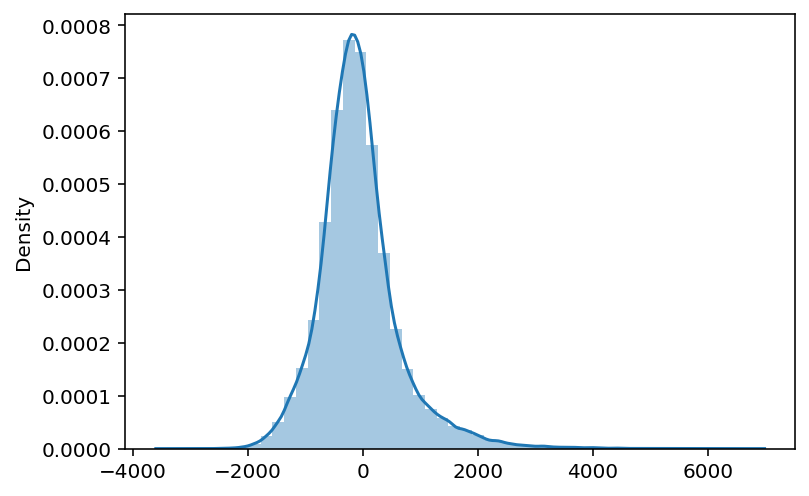

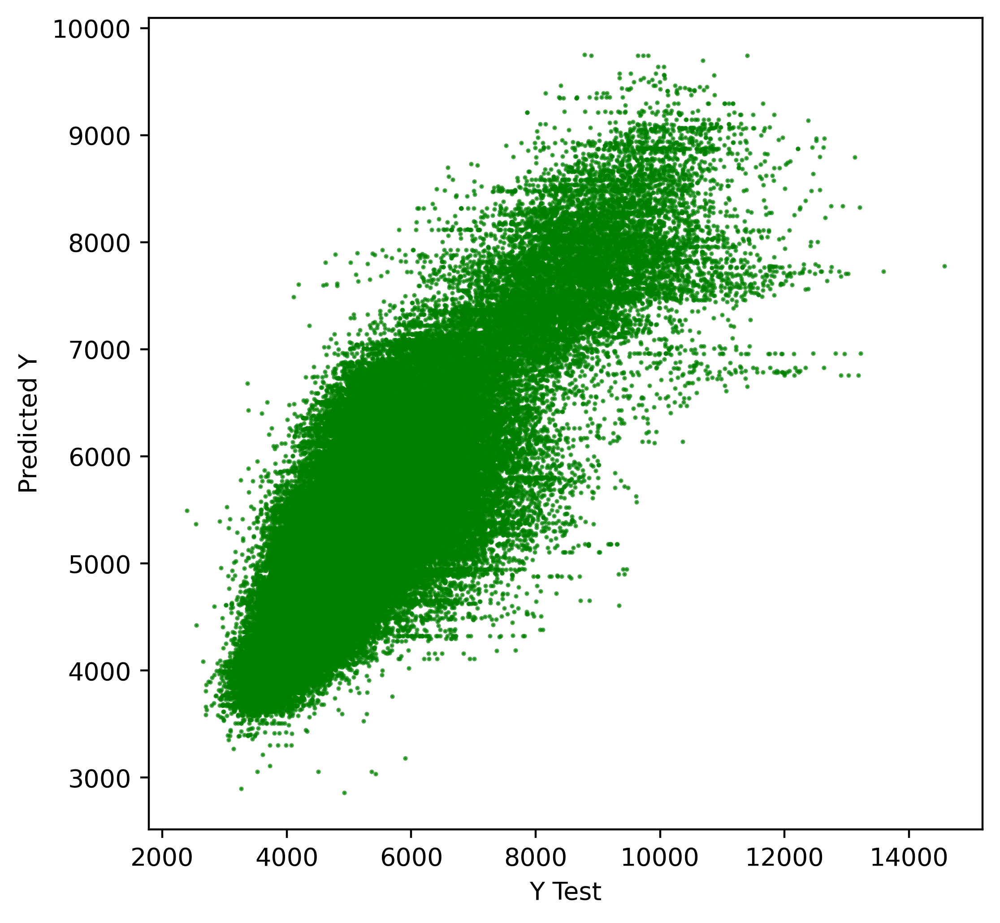


Feature ranking:
1. remaining_lease_years (0.195030)
2. lease_commence_date (0.185220)
3. n_rooms (0.172339)
4. region_Central (0.128133)
5. floor_area_sqm (0.063510)
6. flat_type_4 Room (0.034363)
7. region_West (0.021777)
8. region_North (0.021554)
9. town_Woodlands (0.014890)
10. town_Clementi (0.014760)
11. storey_range_min (0.014232)
12. storey_range_avg (0.013952)
13. storey_range_max (0.012118)
14. flat_type_5 Room (0.010896)
15. town_Jurong West (0.008617)
16. town_Marine Parade (0.007736)
17. town_Geylang (0.007709)
18. town_Tampines (0.006760)
19. town_Ang Mo Kio (0.006057)
20. town_Central Area (0.005394)
21. town_Jurong East (0.004644)
22. town_Toa Payoh (0.004603)
23. town_Bukit Batok (0.004503)
24. town_Bukit Merah (0.004239)
25. town_Queenstown (0.004205)
26. flat_type_3 Room (0.003293)
27. town_Serangoon (0.003230)
28. region_East (0.003066)
29. town_Kallang/Whampoa (0.002952)
30. town_Choa Chu Kang (0.002893)
31. town_Hougang (0.002608)
32. town_Bedok (0.002437)
33. t

In [299]:
model_random_forest(df_ml_24)

# all time high ...

Scenario = `see below.`

In [313]:

# c2u = ['flat_model_2-Room',
#  'flat_model_Adjoined Flat',
#  'flat_model_Apartment',
#  'flat_model_Dbss',
#  'flat_model_Improved',
#  'flat_model_Improved-Maisonette',
#  'flat_model_Maisonette',
#  'flat_model_Model A',
#  'flat_model_Model A-Maisonette',
#  'flat_model_Model A2',
#  'flat_model_Multi Generation',
#  'flat_model_New Generation',
#  'flat_model_Premium Apartment',
#  'flat_model_Premium Apartment Loft',
#  'flat_model_Premium Maisonette',
#  'flat_model_Simplified',
#  'flat_model_Standard',
#  'flat_model_Terrace',
#  'flat_model_Type S1',
#  'flat_model_Type S2',
    
c2u = [ 'floor_area_sqm',
    
 'flat_type_1 Room',
 'flat_type_2 Room',
 'flat_type_3 Room',
 'flat_type_4 Room',
 'flat_type_5 Room',
 'flat_type_Executive',
 'flat_type_Multi Generation',

 'lease_commence_date',  #  this really hurts it when you remove...  
 
 # 'n_rooms',    
 
 'price_per_sq_m_norm',

 'region_Central',
 'region_East',
 'region_North',
 'region_North-East',
 'region_West',
    
 'remaining_lease_years',
 
#  'storey_range_01 TO 03',  #  what the heck... 
#  'storey_range_01 TO 05',  #  multiple overlaps... meaningless ? 
#  'storey_range_04 TO 06',
#  'storey_range_06 TO 10',
#  'storey_range_07 TO 09',  # overlaps...
#  'storey_range_10 TO 12',
#  'storey_range_11 TO 15',
#  'storey_range_13 TO 15',
#  'storey_range_16 TO 18',
#  'storey_range_16 TO 20',
#  'storey_range_19 TO 21',
#  'storey_range_21 TO 25',
#  'storey_range_22 TO 24',
#  'storey_range_25 TO 27',
#  'storey_range_26 TO 30',
#  'storey_range_28 TO 30',
#  'storey_range_31 TO 33',
#  'storey_range_31 TO 35',
#  'storey_range_34 TO 36',
#  'storey_range_36 TO 40',
#  'storey_range_37 TO 39',
#  'storey_range_40 TO 42',
#  'storey_range_43 TO 45',
#  'storey_range_46 TO 48',
#  'storey_range_49 TO 51',
    
 'storey_range_avg',
 'storey_range_max',
 'storey_range_min',
       
 'town_Ang Mo Kio',
 'town_Bedok',
 'town_Bishan',
 'town_Bukit Batok',
 'town_Bukit Merah',
 'town_Bukit Panjang',
 'town_Bukit Timah',
 'town_Central Area',
 'town_Choa Chu Kang',
 'town_Clementi',
 'town_Geylang',
 'town_Hougang',
 'town_Jurong East',
 'town_Jurong West',
 'town_Kallang/Whampoa',
 'town_Lim Chu Kang',
 'town_Marine Parade',
 'town_Pasir Ris',
 'town_Punggol',
 'town_Queenstown',
 'town_Sembawang',
 'town_Sengkang',
 'town_Serangoon',
 'town_Tampines',
 'town_Toa Payoh',
 'town_Woodlands',
 'town_Yishun']


In [314]:
df_ml_25 = df_ml_1[c2u]

In [315]:
# len(df_ml_24)

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Test Set ---
Mean Absolute Error: ... 500.46681306064414
Mean Squared Error:..... 469711.26
RMSE: .................. 685.3548453541226
Coeff of det (R^2):..... 0.726
Score .................. 0.7255455285219794

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--- Train Set ---
Mean Absolute Error: ... 213.21836043225002
Mean Squared Error:..... 97801.42
RMSE: .................. 312.732179985444
Coeff of det (R^2):..... 0.911
Score .................. 0.9109631480150624

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

sns.distplot((y_test-y_pred_test)):


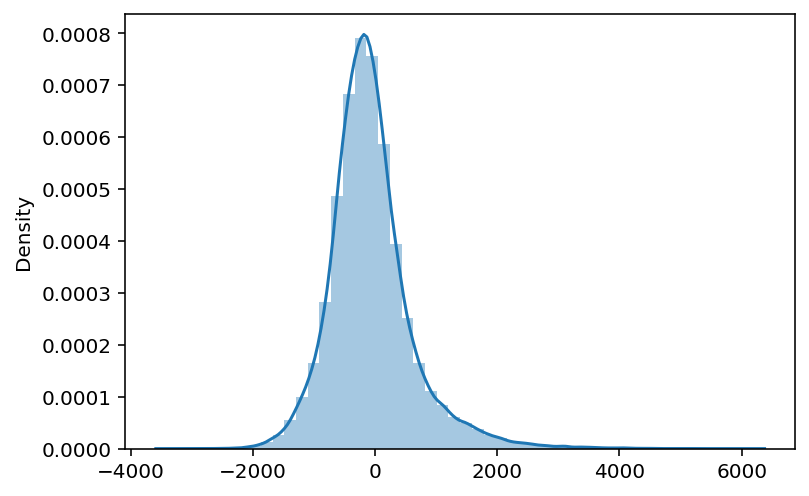

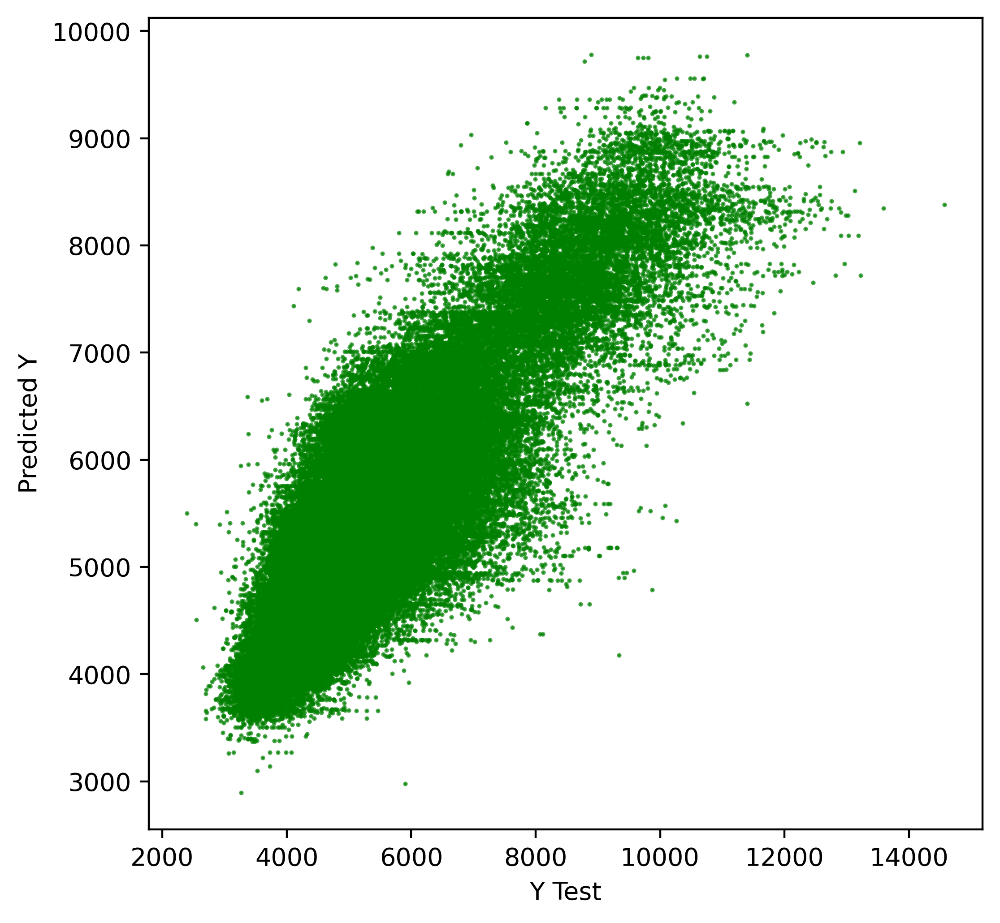


Feature ranking:
1. floor_area_sqm (0.259261)
2. remaining_lease_years (0.199484)
3. lease_commence_date (0.180628)
4. region_Central (0.118138)
5. flat_type_3 Room (0.028155)
6. region_North (0.023168)
7. region_West (0.022093)
8. storey_range_min (0.015016)
9. storey_range_avg (0.014033)
10. town_Clementi (0.013779)
11. storey_range_max (0.012574)
12. town_Woodlands (0.011249)
13. region_East (0.008721)
14. town_Geylang (0.007858)
15. town_Marine Parade (0.007121)
16. town_Tampines (0.006235)
17. town_Jurong West (0.005703)
18. town_Toa Payoh (0.004944)
19. town_Ang Mo Kio (0.004939)
20. town_Bukit Merah (0.004926)
21. town_Bukit Batok (0.004646)
22. town_Central Area (0.004494)
23. town_Jurong East (0.004293)
24. flat_type_4 Room (0.004233)
25. town_Kallang/Whampoa (0.003635)
26. town_Queenstown (0.003614)
27. town_Serangoon (0.003452)
28. town_Choa Chu Kang (0.002687)
29. flat_type_Executive (0.002630)
30. town_Bedok (0.002583)
31. town_Hougang (0.002581)
32. region_North-East (0.

In [316]:
model_random_forest(df_ml_25)

```
Feature ranking:
1. floor_area_sqm (0.259261)
2. remaining_lease_years (0.199484)
3. lease_commence_date (0.180628)
4. region_Central (0.118138)
5. flat_type_3 Room (0.028155)
6. region_North (0.023168)
7. region_West (0.022093)
8. storey_range_min (0.015016)
9. storey_range_avg (0.014033)
10. town_Clementi (0.013779)
11. storey_range_max (0.012574)
12. town_Woodlands (0.011249)
13. region_East (0.008721)
14. town_Geylang (0.007858)
15. town_Marine Parade (0.007121)
16. town_Tampines (0.006235)
17. town_Jurong West (0.005703)
18. town_Toa Payoh (0.004944)
19. town_Ang Mo Kio (0.004939)
20. town_Bukit Merah (0.004926)
21. town_Bukit Batok (0.004646)
22. town_Central Area (0.004494)
23. town_Jurong East (0.004293)
24. flat_type_4 Room (0.004233)
25. town_Kallang/Whampoa (0.003635)
26. town_Queenstown (0.003614)
27. town_Serangoon (0.003452)
28. town_Choa Chu Kang (0.002687)
29. flat_type_Executive (0.002630)
30. town_Bedok (0.002583)
31. town_Hougang (0.002581)
32. region_North-East (0.002281)
33. town_Pasir Ris (0.001939)
34. town_Bishan (0.001927)
35. town_Bukit Panjang (0.001742)
36. flat_type_5 Room (0.001330)
37. flat_type_2 Room (0.000941)
38. town_Yishun (0.000792)
39. town_Bukit Timah (0.000703)
40. town_Sengkang (0.000572)
41. flat_type_1 Room (0.000508)
42. town_Sembawang (0.000160)
43. town_Lim Chu Kang (0.000116)
44. town_Punggol (0.000087)
45. flat_type_Multi Generation (0.000029)
```

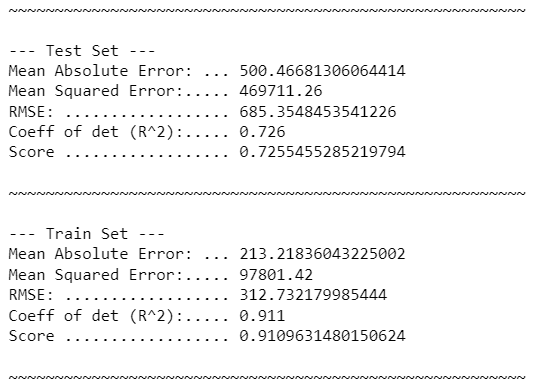

<br><br>

---

<br><br>

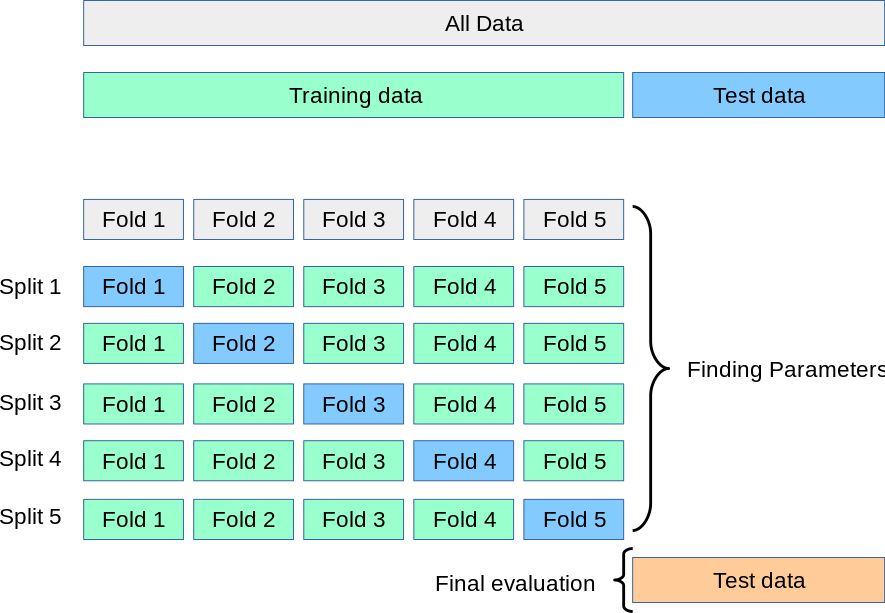

```

Help on class RandomForestRegressor in module sklearn.ensemble._forest:

class RandomForestRegressor(ForestRegressor)
   RandomForestRegressor(n_estimators=100, *, criterion='squared_error', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='auto', max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, ccp_alpha=0.0, max_samples=None)
   
   A random forest regressor.
   
   A random forest is a meta estimator that fits a number of classifying
   decision trees on various sub-samples of the dataset and uses averaging
   to improve the predictive accuracy and control over-fitting.
   The sub-sample size is controlled with the `max_samples` parameter if
   `bootstrap=True` (default), otherwise the whole dataset is used to build
   each tree.
   
   Read more in the :ref:`User Guide <forest>`.
   
   Parameters
   ----------
   n_estimators : int, default=100
       The number of trees in the forest.
   
       .. versionchanged:: 0.22
          The default value of ``n_estimators`` changed from 10 to 100
          in 0.22.
   
   criterion : {"squared_error", "absolute_error", "poisson"},             default="squared_error"
       The function to measure the quality of a split. Supported criteria
       are "squared_error" for the mean squared error, which is equal to
       variance reduction as feature selection criterion, "absolute_error"
       for the mean absolute error, and "poisson" which uses reduction in
       Poisson deviance to find splits.
       Training using "absolute_error" is significantly slower
       than when using "squared_error".
   
       .. versionadded:: 0.18
          Mean Absolute Error (MAE) criterion.
   
       .. versionadded:: 1.0
          Poisson criterion.
   
       .. deprecated:: 1.0
           Criterion "mse" was deprecated in v1.0 and will be removed in
           version 1.2. Use `criterion="squared_error"` which is equivalent.
   
       .. deprecated:: 1.0
           Criterion "mae" was deprecated in v1.0 and will be removed in
           version 1.2. Use `criterion="absolute_error"` which is equivalent.
   
   max_depth : int, default=None
       The maximum depth of the tree. If None, then nodes are expanded until
       all leaves are pure or until all leaves contain less than
       min_samples_split samples.
   
   min_samples_split : int or float, default=2
       The minimum number of samples required to split an internal node:
   
       - If int, then consider `min_samples_split` as the minimum number.
       - If float, then `min_samples_split` is a fraction and
         `ceil(min_samples_split * n_samples)` are the minimum
         number of samples for each split.
   
       .. versionchanged:: 0.18
          Added float values for fractions.
   
   min_samples_leaf : int or float, default=1
       The minimum number of samples required to be at a leaf node.
       A split point at any depth will only be considered if it leaves at
       least ``min_samples_leaf`` training samples in each of the left and
       right branches.  This may have the effect of smoothing the model,
       especially in regression.
   
       - If int, then consider `min_samples_leaf` as the minimum number.
       - If float, then `min_samples_leaf` is a fraction and
         `ceil(min_samples_leaf * n_samples)` are the minimum
         number of samples for each node.
   
       .. versionchanged:: 0.18
          Added float values for fractions.
   
   min_weight_fraction_leaf : float, default=0.0
       The minimum weighted fraction of the sum total of weights (of all
       the input samples) required to be at a leaf node. Samples have
       equal weight when sample_weight is not provided.
   
   max_features : {"auto", "sqrt", "log2"}, int or float, default="auto"
       The number of features to consider when looking for the best split:
   
       - If int, then consider `max_features` features at each split.
       - If float, then `max_features` is a fraction and
         `round(max_features * n_features)` features are considered at each
         split.
       - If "auto", then `max_features=n_features`.
       - If "sqrt", then `max_features=sqrt(n_features)`.
       - If "log2", then `max_features=log2(n_features)`.
       - If None, then `max_features=n_features`.
   
       Note: the search for a split does not stop until at least one
       valid partition of the node samples is found, even if it requires to
       effectively inspect more than ``max_features`` features.
   
   max_leaf_nodes : int, default=None
       Grow trees with ``max_leaf_nodes`` in best-first fashion.
       Best nodes are defined as relative reduction in impurity.
       If None then unlimited number of leaf nodes.
   
   min_impurity_decrease : float, default=0.0
       A node will be split if this split induces a decrease of the impurity
       greater than or equal to this value.
   
       The weighted impurity decrease equation is the following::
   
           N_t / N * (impurity - N_t_R / N_t * right_impurity
                               - N_t_L / N_t * left_impurity)
   
       where ``N`` is the total number of samples, ``N_t`` is the number of
       samples at the current node, ``N_t_L`` is the number of samples in the
       left child, and ``N_t_R`` is the number of samples in the right child.
   
       ``N``, ``N_t``, ``N_t_R`` and ``N_t_L`` all refer to the weighted sum,
       if ``sample_weight`` is passed.
   
       .. versionadded:: 0.19
   
   bootstrap : bool, default=True
       Whether bootstrap samples are used when building trees. If False, the
       whole dataset is used to build each tree.
   
   oob_score : bool, default=False
       Whether to use out-of-bag samples to estimate the generalization score.
       Only available if bootstrap=True.
   
   n_jobs : int, default=None
       The number of jobs to run in parallel. :meth:`fit`, :meth:`predict`,
       :meth:`decision_path` and :meth:`apply` are all parallelized over the
       trees. ``None`` means 1 unless in a :obj:`joblib.parallel_backend`
       context. ``-1`` means using all processors. See :term:`Glossary
       <n_jobs>` for more details.
   
   random_state : int, RandomState instance or None, default=None
       Controls both the randomness of the bootstrapping of the samples used
       when building trees (if ``bootstrap=True``) and the sampling of the
       features to consider when looking for the best split at each node
       (if ``max_features < n_features``).
       See :term:`Glossary <random_state>` for details.
   
   verbose : int, default=0
       Controls the verbosity when fitting and predicting.
   
   warm_start : bool, default=False
       When set to ``True``, reuse the solution of the previous call to fit
       and add more estimators to the ensemble, otherwise, just fit a whole
       new forest. See :term:`the Glossary <warm_start>`.
   
   ccp_alpha : non-negative float, default=0.0
       Complexity parameter used for Minimal Cost-Complexity Pruning. The
       subtree with the largest cost complexity that is smaller than
       ``ccp_alpha`` will be chosen. By default, no pruning is performed. See
       :ref:`minimal_cost_complexity_pruning` for details.
   
       .. versionadded:: 0.22
   
   max_samples : int or float, default=None
       If bootstrap is True, the number of samples to draw from X
       to train each base estimator.
   
       - If None (default), then draw `X.shape[0]` samples.
       - If int, then draw `max_samples` samples.
       - If float, then draw `max_samples * X.shape[0]` samples. Thus,
         `max_samples` should be in the interval `(0.0, 1.0]`.
   
       .. versionadded:: 0.22
   
   Attributes
   ----------
   base_estimator_ : DecisionTreeRegressor
       The child estimator template used to create the collection of fitted
       sub-estimators.
   
   estimators_ : list of DecisionTreeRegressor
       The collection of fitted sub-estimators.
   
   feature_importances_ : ndarray of shape (n_features,)
       The impurity-based feature importances.
       The higher, the more important the feature.
       The importance of a feature is computed as the (normalized)
       total reduction of the criterion brought by that feature.  It is also
       known as the Gini importance.
   
       Warning: impurity-based feature importances can be misleading for
       high cardinality features (many unique values). See
       :func:`sklearn.inspection.permutation_importance` as an alternative.
   
   n_features_ : int
       The number of features when ``fit`` is performed.
   
       .. deprecated:: 1.0
           Attribute `n_features_` was deprecated in version 1.0 and will be
           removed in 1.2. Use `n_features_in_` instead.
   
   n_features_in_ : int
       Number of features seen during :term:`fit`.
   
       .. versionadded:: 0.24
   
   feature_names_in_ : ndarray of shape (`n_features_in_`,)
       Names of features seen during :term:`fit`. Defined only when `X`
       has feature names that are all strings.
   
       .. versionadded:: 1.0
   
   n_outputs_ : int
       The number of outputs when ``fit`` is performed.
   
   oob_score_ : float
       Score of the training dataset obtained using an out-of-bag estimate.
       This attribute exists only when ``oob_score`` is True.
   
   oob_prediction_ : ndarray of shape (n_samples,) or (n_samples, n_outputs)
       Prediction computed with out-of-bag estimate on the training set.
       This attribute exists only when ``oob_score`` is True.
   
   See Also
   --------
   sklearn.tree.DecisionTreeRegressor : A decision tree regressor.
   sklearn.ensemble.ExtraTreesRegressor : Ensemble of extremely randomized
       tree regressors.
   
   Notes
   -----
   The default values for the parameters controlling the size of the trees
   (e.g. ``max_depth``, ``min_samples_leaf``, etc.) lead to fully grown and
   unpruned trees which can potentially be very large on some data sets. To
   reduce memory consumption, the complexity and size of the trees should be
   controlled by setting those parameter values.
   
   The features are always randomly permuted at each split. Therefore,
   the best found split may vary, even with the same training data,
   ``max_features=n_features`` and ``bootstrap=False``, if the improvement
   of the criterion is identical for several splits enumerated during the
   search of the best split. To obtain a deterministic behaviour during
   fitting, ``random_state`` has to be fixed.
   
   The default value ``max_features="auto"`` uses ``n_features``
   rather than ``n_features / 3``. The latter was originally suggested in
   [1], whereas the former was more recently justified empirically in [2].
   
   References
   ----------
   .. [1] L. Breiman, "Random Forests", Machine Learning, 45(1), 5-32, 2001.
   
   .. [2] P. Geurts, D. Ernst., and L. Wehenkel, "Extremely randomized
          trees", Machine Learning, 63(1), 3-42, 2006.
   
   Examples
   --------
   >>> from sklearn.ensemble import RandomForestRegressor
   >>> from sklearn.datasets import make_regression
   >>> X, y = make_regression(n_features=4, n_informative=2,
   ...                        random_state=0, shuffle=False)
   >>> regr = RandomForestRegressor(max_depth=2, random_state=0)
   >>> regr.fit(X, y)
   RandomForestRegressor(...)
   >>> print(regr.predict([[0, 0, 0, 0]]))
   [-8.32987858]
   
   Method resolution order:
       RandomForestRegressor
       ForestRegressor
       sklearn.base.RegressorMixin
       BaseForest
       sklearn.base.MultiOutputMixin
       sklearn.ensemble._base.BaseEnsemble
       sklearn.base.MetaEstimatorMixin
       sklearn.base.BaseEstimator
       builtins.object
   
   Methods defined here:
   
   __init__(self, n_estimators=100, *, criterion='squared_error', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='auto', max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, ccp_alpha=0.0, max_samples=None)
       Initialize self.  See help(type(self)) for accurate signature.
   
   ----------------------------------------------------------------------
   Data and other attributes defined here:
   
   __abstractmethods__ = frozenset()
   
   ----------------------------------------------------------------------
   Methods inherited from ForestRegressor:
   
   predict(self, X)
       Predict regression target for X.
       
       The predicted regression target of an input sample is computed as the
       mean predicted regression targets of the trees in the forest.
       
       Parameters
       ----------
       X : {array-like, sparse matrix} of shape (n_samples, n_features)
           The input samples. Internally, its dtype will be converted to
           ``dtype=np.float32``. If a sparse matrix is provided, it will be
           converted into a sparse ``csr_matrix``.
       
       Returns
       -------
       y : ndarray of shape (n_samples,) or (n_samples, n_outputs)
           The predicted values.
   
   ----------------------------------------------------------------------
   Methods inherited from sklearn.base.RegressorMixin:
   
   score(self, X, y, sample_weight=None)
       Return the coefficient of determination of the prediction.
       
       The coefficient of determination :math:`R^2` is defined as
       :math:`(1 - \frac{u}{v})`, where :math:`u` is the residual
       sum of squares ``((y_true - y_pred)** 2).sum()`` and :math:`v`
       is the total sum of squares ``((y_true - y_true.mean()) ** 2).sum()``.
       The best possible score is 1.0 and it can be negative (because the
       model can be arbitrarily worse). A constant model that always predicts
       the expected value of `y`, disregarding the input features, would get
       a :math:`R^2` score of 0.0.
       
       Parameters
       ----------
       X : array-like of shape (n_samples, n_features)
           Test samples. For some estimators this may be a precomputed
           kernel matrix or a list of generic objects instead with shape
           ``(n_samples, n_samples_fitted)``, where ``n_samples_fitted``
           is the number of samples used in the fitting for the estimator.
       
       y : array-like of shape (n_samples,) or (n_samples, n_outputs)
           True values for `X`.
       
       sample_weight : array-like of shape (n_samples,), default=None
           Sample weights.
       
       Returns
       -------
       score : float
           :math:`R^2` of ``self.predict(X)`` wrt. `y`.
       
       Notes
       -----
       The :math:`R^2` score used when calling ``score`` on a regressor uses
       ``multioutput='uniform_average'`` from version 0.23 to keep consistent
       with default value of :func:`~sklearn.metrics.r2_score`.
       This influences the ``score`` method of all the multioutput
       regressors (except for
       :class:`~sklearn.multioutput.MultiOutputRegressor`).
   
   ----------------------------------------------------------------------
   Data descriptors inherited from sklearn.base.RegressorMixin:
   
   __dict__
       dictionary for instance variables (if defined)
   
   __weakref__
       list of weak references to the object (if defined)
   
   ----------------------------------------------------------------------
   Methods inherited from BaseForest:
   
   apply(self, X)
       Apply trees in the forest to X, return leaf indices.
       
       Parameters
       ----------
       X : {array-like, sparse matrix} of shape (n_samples, n_features)
           The input samples. Internally, its dtype will be converted to
           ``dtype=np.float32``. If a sparse matrix is provided, it will be
           converted into a sparse ``csr_matrix``.
       
       Returns
       -------
       X_leaves : ndarray of shape (n_samples, n_estimators)
           For each datapoint x in X and for each tree in the forest,
           return the index of the leaf x ends up in.
   
   decision_path(self, X)
       Return the decision path in the forest.
       
       .. versionadded:: 0.18
       
       Parameters
       ----------
       X : {array-like, sparse matrix} of shape (n_samples, n_features)
           The input samples. Internally, its dtype will be converted to
           ``dtype=np.float32``. If a sparse matrix is provided, it will be
           converted into a sparse ``csr_matrix``.
       
       Returns
       -------
       indicator : sparse matrix of shape (n_samples, n_nodes)
           Return a node indicator matrix where non zero elements indicates
           that the samples goes through the nodes. The matrix is of CSR
           format.
       
       n_nodes_ptr : ndarray of shape (n_estimators + 1,)
           The columns from indicator[n_nodes_ptr[i]:n_nodes_ptr[i+1]]
           gives the indicator value for the i-th estimator.
   
   fit(self, X, y, sample_weight=None)
       Build a forest of trees from the training set (X, y).
       
       Parameters
       ----------
       X : {array-like, sparse matrix} of shape (n_samples, n_features)
           The training input samples. Internally, its dtype will be converted
           to ``dtype=np.float32``. If a sparse matrix is provided, it will be
           converted into a sparse ``csc_matrix``.
       
       y : array-like of shape (n_samples,) or (n_samples, n_outputs)
           The target values (class labels in classification, real numbers in
           regression).
       
       sample_weight : array-like of shape (n_samples,), default=None
           Sample weights. If None, then samples are equally weighted. Splits
           that would create child nodes with net zero or negative weight are
           ignored while searching for a split in each node. In the case of
           classification, splits are also ignored if they would result in any
           single class carrying a negative weight in either child node.
       
       Returns
       -------
       self : object
           Fitted estimator.
   
   ----------------------------------------------------------------------
   Readonly properties inherited from BaseForest:
   
   feature_importances_
       The impurity-based feature importances.
       
       The higher, the more important the feature.
       The importance of a feature is computed as the (normalized)
       total reduction of the criterion brought by that feature.  It is also
       known as the Gini importance.
       
       Warning: impurity-based feature importances can be misleading for
       high cardinality features (many unique values). See
       :func:`sklearn.inspection.permutation_importance` as an alternative.
       
       Returns
       -------
       feature_importances_ : ndarray of shape (n_features,)
           The values of this array sum to 1, unless all trees are single node
           trees consisting of only the root node, in which case it will be an
           array of zeros.
   
   n_features_
       DEPRECATED: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
       
       Number of features when fitting the estimator.
   
   ----------------------------------------------------------------------
   Methods inherited from sklearn.ensemble._base.BaseEnsemble:
   
   __getitem__(self, index)
       Return the index'th estimator in the ensemble.
   
   __iter__(self)
       Return iterator over estimators in the ensemble.
   
   __len__(self)
       Return the number of estimators in the ensemble.
   
   ----------------------------------------------------------------------
   Data and other attributes inherited from sklearn.ensemble._base.BaseEnsemble:
   
   __annotations__ = {'_required_parameters': typing.List[str]}
   
   ----------------------------------------------------------------------
   Methods inherited from sklearn.base.BaseEstimator:
   
   __getstate__(self)
   
   __repr__(self, N_CHAR_MAX=700)
       Return repr(self).
   
   __setstate__(self, state)
   
   get_params(self, deep=True)
       Get parameters for this estimator.
       
       Parameters
       ----------
       deep : bool, default=True
           If True, will return the parameters for this estimator and
           contained subobjects that are estimators.
       
       Returns
       -------
       params : dict
           Parameter names mapped to their values.
   
   set_params(self, **params)
       Set the parameters of this estimator.
       
       The method works on simple estimators as well as on nested objects
       (such as :class:`~sklearn.pipeline.Pipeline`). The latter have
       parameters of the form ``<component>__<parameter>`` so that it's
       possible to update each component of a nested object.
       
       Parameters
       ----------
       **params : dict
           Estimator parameters.
       
       Returns
       -------
       self : estimator instance
           Estimator instance.
           
```